In [1]:
import random
import numpy as np
import seaborn
import pandas as pd
import sys
import matplotlib.pyplot as plt
from sklearn.linear_model import LinearRegression

In [117]:
import tigramite
from tigramite import data_processing as pp
from tigramite.toymodels import structural_causal_processes as toys

from tigramite import plotting as tp
from tigramite.pcmci import PCMCI
from tigramite.lpcmci import LPCMCI

from tigramite.independence_tests.parcorr import ParCorr
from tigramite.independence_tests.robust_parcorr import RobustParCorr
from tigramite.independence_tests.parcorr_wls import ParCorrWLS 
#from tigramite.independence_tests.gpdc import GPDC
from tigramite.independence_tests.cmiknn import CMIknn
from tigramite.independence_tests.cmisymb import CMIsymb
from tigramite.independence_tests.gsquared import Gsquared
from tigramite.independence_tests.regressionCI import RegressionCI

In [2]:
sys.path.append("../causalFS/CMI_FS")
from mixedRVMI import MIEstimate,estimateAllMI,CMIEstimate
from feature_selection import backwardFeatureSelection,forwardFeatureSelection
sys.path.append("../causalFS/CMI")
from FS import backwardFeatureSelection, forwardFeatureSelection
from TE_FS import TE_backwardFeatureSelection, TE_forwardFeatureSelection

sys.path.append("../causalFS/data")
from dataset_generation import generate_dataset


In [181]:
def run_PCMCI(df,tau=0,cond_test=ParCorr()):    

    dataframe = pp.DataFrame(df.values)
    
    cond_ind_test = cond_test
    pcmci = PCMCI(dataframe=dataframe, cond_ind_test=cond_ind_test)
    results = pcmci.run_pcmciplus(tau_min=1, tau_max=tau)
    #results = pcmci.run_pcmci(tau_max=tau, pc_alpha=0.01)

    pcmci.print_significant_links(p_matrix=results['p_matrix'],val_matrix=results['val_matrix'])
    
    tp.plot_graph(
    val_matrix=results['val_matrix'],
    graph=results['graph'],
    var_names=list(df.columns),
    link_colorbar_label='cross-MCI',
    node_colorbar_label='auto-MCI',
    show_autodependency_lags=False
    )
    plt.show()
    
    tp.plot_time_series_graph(
    figsize=(6, 4),
    val_matrix=results['val_matrix'],
    graph=results['graph'],
    var_names=list(df.columns),
    link_colorbar_label='MCI',
    )
    plt.show()
    

In [182]:
def run_fullCI(df,tau=0,cond_test=ParCorr()):    

    dataframe = pp.DataFrame(df.values)
    
    cond_ind_test = cond_test
    pcmci = PCMCI(dataframe=dataframe, cond_ind_test=cond_ind_test)
    #results = pcmci.run_pcmciplus(tau_max=tau, pc_alpha=0.01)
    #results = pcmci.run_pcmci(tau_max=tau, pc_alpha=0.01)
    results = pcmci.run_fullci(tau_min=1, tau_max=tau)

    pcmci.print_significant_links(p_matrix=results['p_matrix'],val_matrix=results['val_matrix'])
    
    tp.plot_graph(
    val_matrix=results['val_matrix'],
    graph=results['graph'],
    var_names=list(df.columns),
    link_colorbar_label='cross-MCI',
    node_colorbar_label='auto-MCI',
    show_autodependency_lags=False
    )
    plt.show()
    
    tp.plot_time_series_graph(
    figsize=(6, 4),
    val_matrix=results['val_matrix'],
    graph=results['graph'],
    var_names=list(df.columns),
    link_colorbar_label='MCI',
    )
    plt.show()
    

In [3]:
def concatenate_past(x,lag):
    lag_x = x[lag-1:-1].reshape(-1,1)
    if lag<=1: return lag_x
        
    for i in range(lag-1):
        lag_x = np.concatenate((lag_x, x[lag-i-2:-i-2].reshape(-1,1)),axis=1)
        
    return lag_x

In [4]:
def evaluate_CI(x):
    x_mean = np.mean(x)
    x_std = np.std(x)
    return [x_mean-1.96*x_std/np.sqrt(len(x)),x_mean+1.96*x_std/np.sqrt(len(x))]

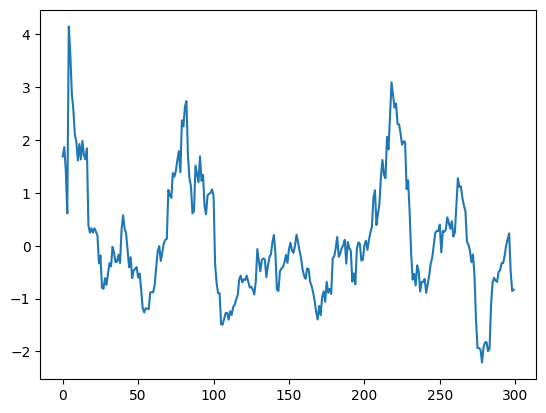

In [14]:
data_for_X0 = pd.read_csv('../causalFS/data/sampleX0.csv')
plt.plot(data_for_X0.iloc[:300].values)

# 2 variables

In [17]:
x0 = data_for_X0.iloc[:302].values
x0.shape

(302, 1)

### coefficient exploration and TPR/FPR on random coefficients

In [5]:
b = []
c = []
d = []
for seed in range(10): 
    rng = np.random.default_rng(seed=seed)
    random.seed(seed)
    np.random.seed(seed)
    c.append([rng.uniform(-1,1),rng.uniform(-1,1)])
    d.append(rng.uniform(-1,1))
    b.append(rng.uniform(-1,1))


In [6]:
b

[-0.9669447289429418,
 0.8972988942744877,
 -0.8161681157298062,
 0.16432407212873557,
 -0.8383279522087956,
 -0.4283972398237168,
 -0.2510064688242353,
 -0.5495856200188163,
 0.5770978716400579,
 0.5550681658403576]

In [7]:
c

[[0.2739233746429086, -0.4604265724722594],
 [0.023643249400513433, 0.9009273926518706],
 [-0.4767757315013672, -0.4030177131717534],
 [-0.8287016657127513, -0.5263789868078006],
 [0.8861122111447353, 0.022655105628723193],
 [0.6100058474907604, 0.6158815794729875],
 [0.07632870294388638, -0.31345826037332314],
 [0.25019093320933394, 0.794427601939151],
 [-0.34605544678887856, 0.9745536866758511],
 [0.7404984079401693, -0.42636558182488926]]

In [8]:
d

[-0.9180529521276106,
 -0.7116807745607325,
 0.6284514811885606,
 0.6025489304127938,
 0.9524874114154083,
 0.030651122084284,
 -0.2618655204092435,
 0.551371380490387,
 -0.36257832302896653,
 0.20629630010312372]

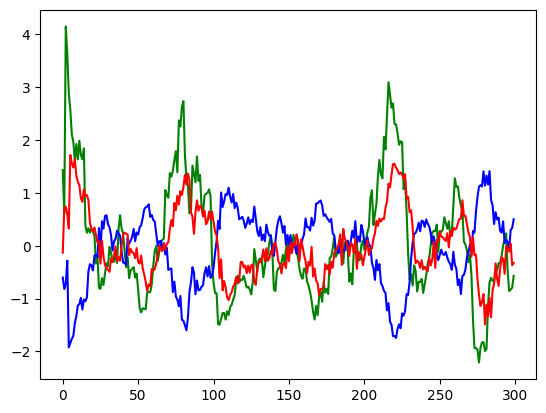

(298, 1) (298, 1) (298, 1)
CMI: 1.1156741521487634
CMI: 0.8328383743728793
Highest CMI score: 1.1156741521487634
Adding original feature: 0
Highest CMI score: -0.15409085662150457
[0]
CMI: 0.002570591058338456
Highest CMI score: 0.002570591058338456
Adding original feature: 0
Highest CMI score: -0.0969033702840254
[0]




## Significant links at alpha = 0.05:

    Variable 0 has 2 link(s):
        (0 -1): pval = 0.00000 | val =  0.713
        (2 -2): pval = 0.04436 | val =  0.117

    Variable 1 has 3 link(s):
        (2 -1): pval = 0.00000 | val = -0.697
        (0 -1): pval = 0.01683 | val =  0.139
        (0 -2): pval = 0.03835 | val =  0.121

    Variable 2 has 2 link(s):
        (0 -2): pval = 0.00000 | val = -0.849
        (2 -2): pval = 0.00000 | val =  0.305


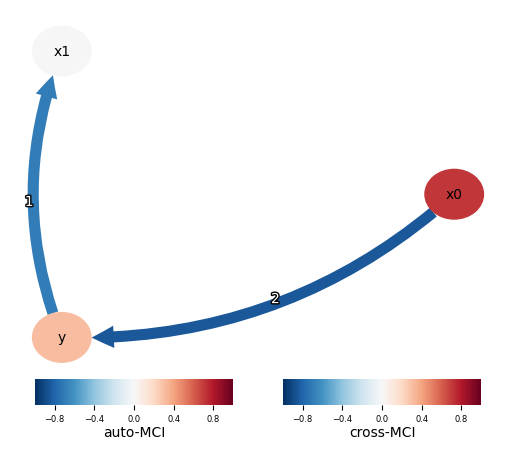

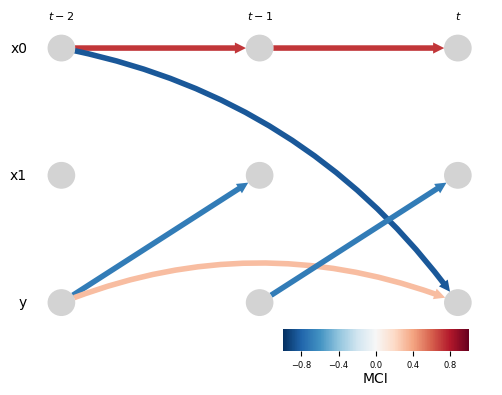

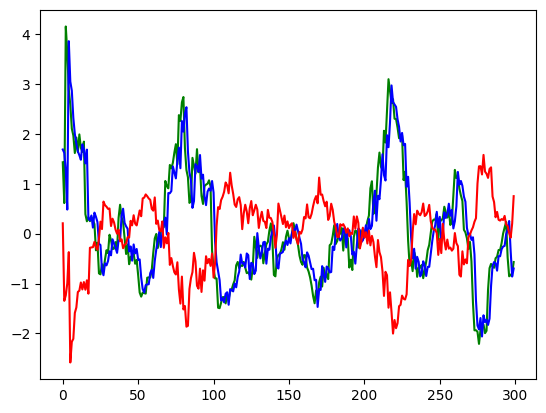

(298, 1) (298, 1) (298, 1)
CMI: 1.5507782978862814
CMI: 0.7188785945335655
Highest CMI score: 1.5507782978862814
Adding original feature: 0
Highest CMI score: -0.28377987427516027
[0]
CMI: 0.25715310130533564
Highest CMI score: 0.25715310130533564
Adding original feature: 0
Highest CMI score: -0.07144236284649885
[0]




## Significant links at alpha = 0.05:

    Variable 0 has 2 link(s):
        (0 -1): pval = 0.00000 | val =  0.713
        (2 -2): pval = 0.02214 | val = -0.133

    Variable 1 has 1 link(s):
        (2 -1): pval = 0.00000 | val = -0.526

    Variable 2 has 2 link(s):
        (0 -2): pval = 0.00000 | val =  0.962
        (1 -2): pval = 0.03503 | val = -0.123


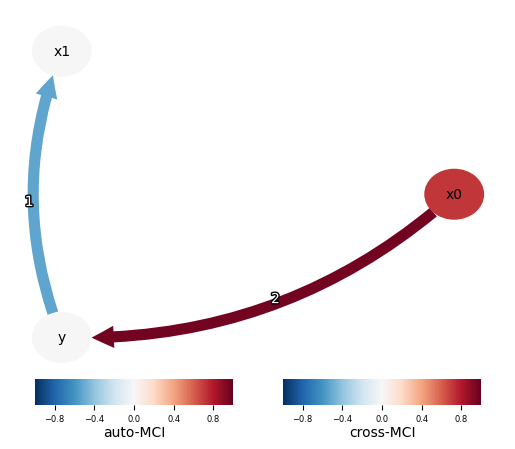

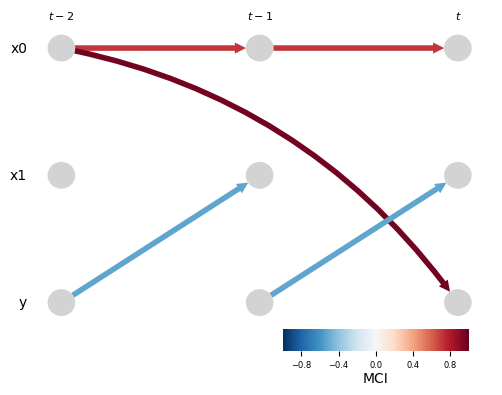

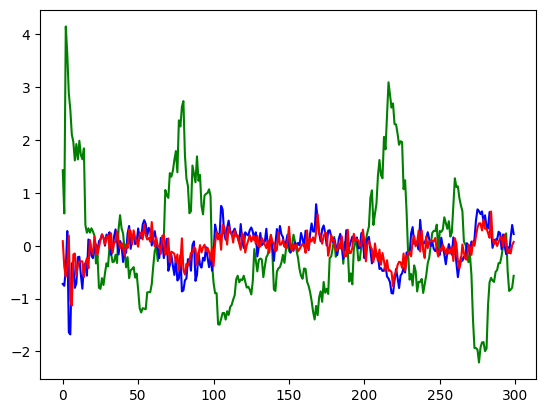

(298, 1) (298, 1) (298, 1)
CMI: 0.49132687296643474
CMI: 0.25493147236823027
Highest CMI score: 0.49132687296643474
Adding original feature: 0
Highest CMI score: -0.04427831689114531
[0]
CMI: 0.10656905830754543
CMI: 0.012583083655425598
Highest CMI score: 0.10656905830754543
Adding original feature: 0
Highest CMI score: -0.027623550325538537
[0]




## Significant links at alpha = 0.05:

    Variable 0 has 2 link(s):
        (0 -1): pval = 0.00000 | val =  0.713
        (2 -2): pval = 0.01928 | val =  0.136

    Variable 1 has 1 link(s):
        (2 -1): pval = 0.00000 | val =  0.504

    Variable 2 has 3 link(s):
        (0 -2): pval = 0.00000 | val = -0.837
        (2 -2): pval = 0.00000 | val = -0.419
        (1 -2): pval = 0.02237 | val = -0.133


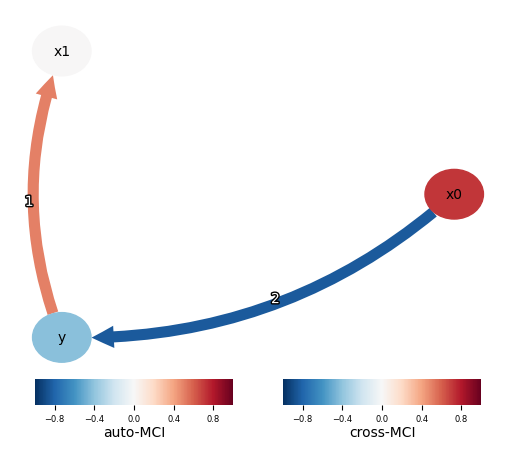

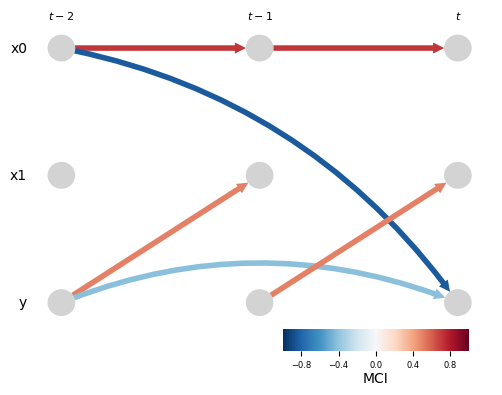

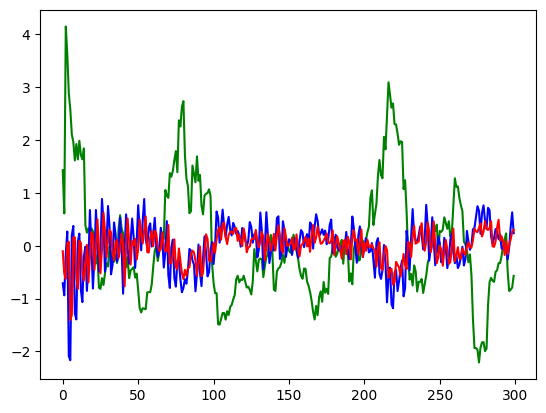

(298, 1) (298, 1) (298, 1)
CMI: 0.3118635821787141
CMI: 0.09322885386109003
Highest CMI score: 0.3118635821787141
Adding original feature: 0
CMI: 0.07792803435067891
Highest CMI score: 0.07792803435067891
Adding original feature: 1
[0, 1]
CMI: 0.2830357196220139
CMI: 0.10649668728419778
Highest CMI score: 0.2830357196220139
Adding original feature: 0
Highest CMI score: -0.02287241312212629
[0]




## Significant links at alpha = 0.05:

    Variable 0 has 2 link(s):
        (0 -1): pval = 0.00000 | val =  0.713
        (2 -2): pval = 0.04401 | val =  0.117

    Variable 1 has 2 link(s):
        (2 -1): pval = 0.00000 | val =  0.863
        (0 -2): pval = 0.01101 | val = -0.148

    Variable 2 has 1 link(s):
        (0 -2): pval = 0.00000 | val = -0.531


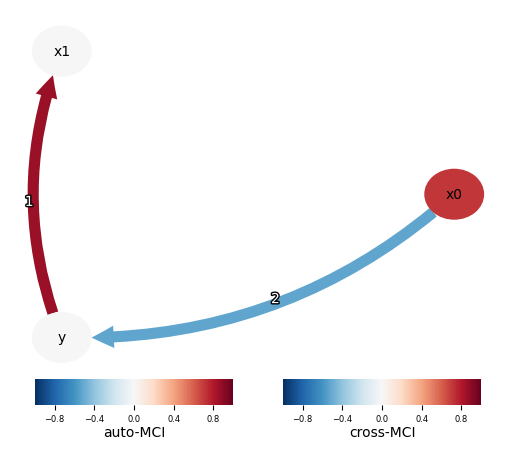

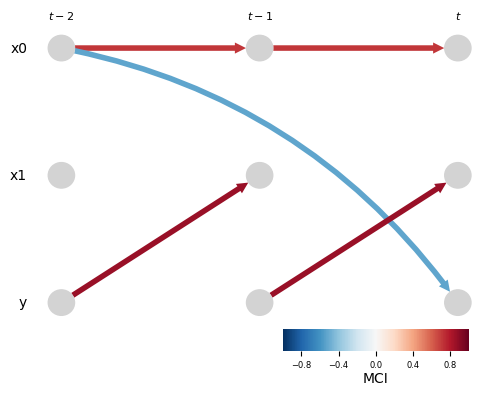

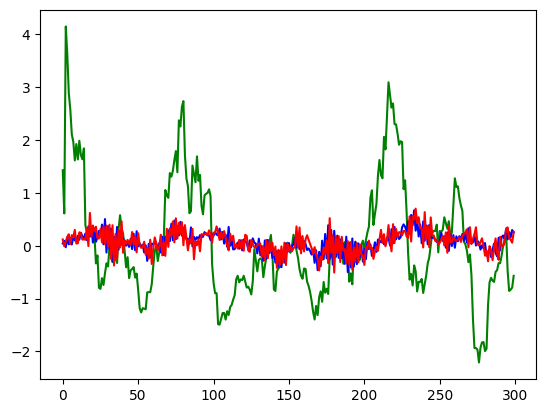

(298, 1) (298, 1) (298, 1)
CMI: 0.017773326973362202
CMI: 0.32590230678129484
Highest CMI score: 0.32590230678129484
Adding original feature: 1
Highest CMI score: -0.21949431800156372
[1]
Highest CMI score: -0.10875938056548456
[]




## Significant links at alpha = 0.05:

    Variable 0 has 3 link(s):
        (0 -1): pval = 0.00000 | val =  0.711
        (1 -1): pval = 0.01790 | val = -0.138
        (1 -2): pval = 0.01985 | val =  0.135

    Variable 1 has 1 link(s):
        (2 -1): pval = 0.00000 | val =  0.729

    Variable 2 has 1 link(s):
        (2 -2): pval = 0.00000 | val =  0.656


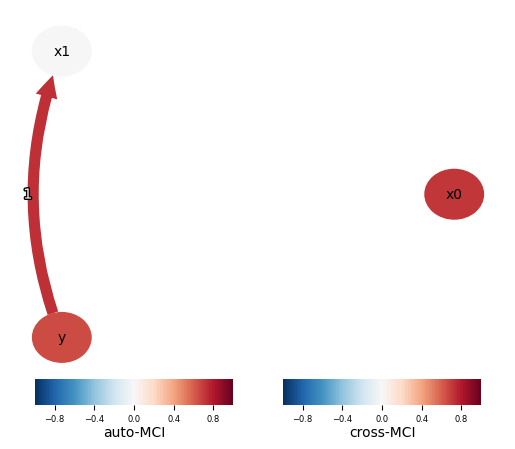

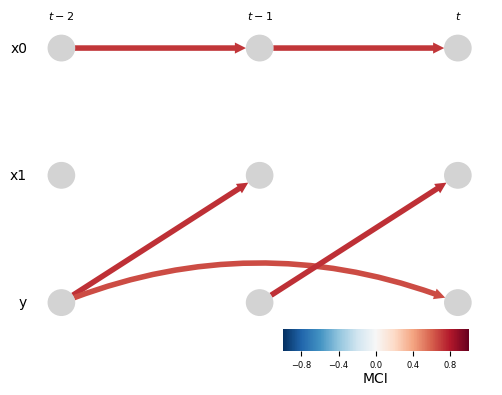

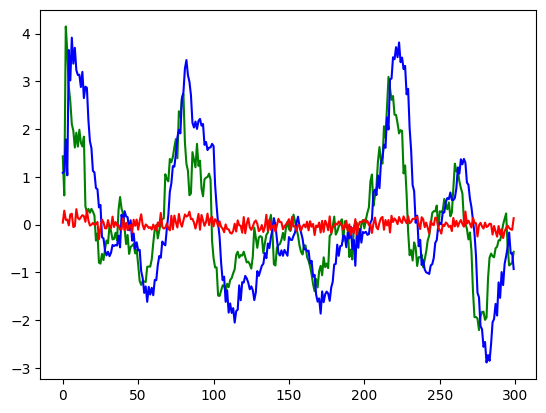

(298, 1) (298, 1) (298, 1)
CMI: 0.8414620124286302
CMI: 0.06443910658385396
Highest CMI score: 0.8414620124286302
Adding original feature: 0
CMI: 0.011595718433553004
Highest CMI score: 0.011595718433553004
Adding original feature: 1
[0, 1]
CMI: 0.08155638276559896
Highest CMI score: 0.08155638276559896
Adding original feature: 0
Highest CMI score: -0.0006448179909934737
[0]




## Significant links at alpha = 0.05:

    Variable 0 has 2 link(s):
        (0 -1): pval = 0.00000 | val =  0.707
        (2 -1): pval = 0.02648 | val = -0.129

    Variable 1 has 1 link(s):
        (2 -1): pval = 0.01499 | val =  0.142

    Variable 2 has 2 link(s):
        (0 -2): pval = 0.00000 | val =  0.920
        (2 -2): pval = 0.00000 | val =  0.550


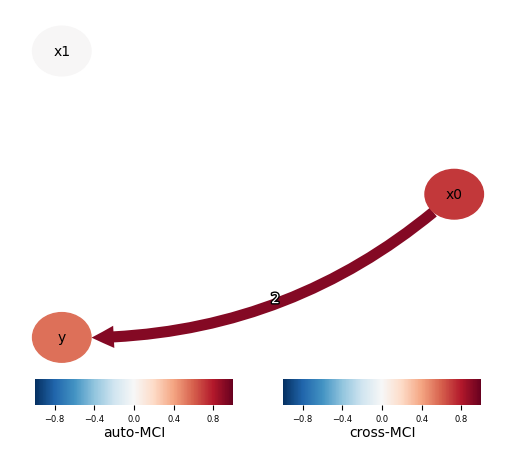

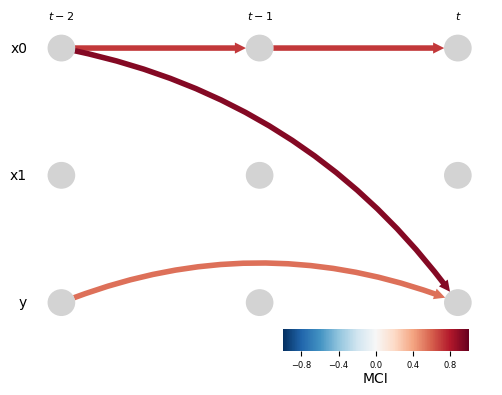

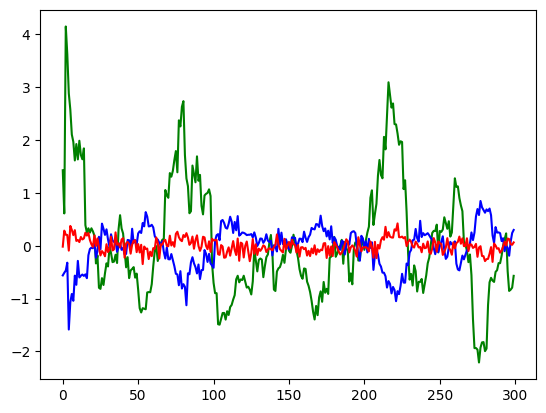

(298, 1) (298, 1) (298, 1)
CMI: 0.6697023694163224
CMI: 0.2402281652954987
Highest CMI score: 0.6697023694163224
Adding original feature: 0
Highest CMI score: -0.042754432148180865
[0]
Highest CMI score: -0.05633896746124811
[]




## Significant links at alpha = 0.05:

    Variable 0 has 1 link(s):
        (0 -1): pval = 0.00000 | val =  0.713

    Variable 1 has 1 link(s):
        (2 -1): pval = 0.00001 | val = -0.258

    Variable 2 has 2 link(s):
        (0 -2): pval = 0.00000 | val = -0.795
        (1 -1): pval = 0.03668 | val = -0.122


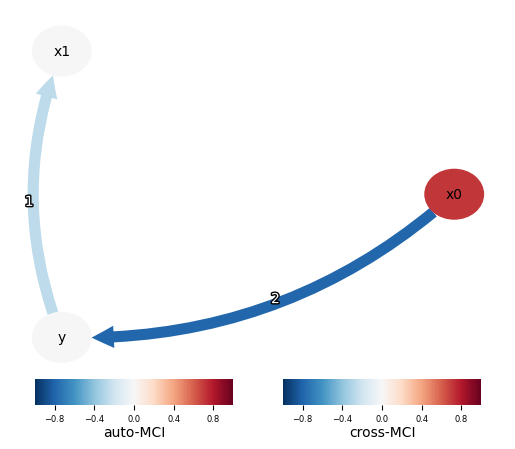

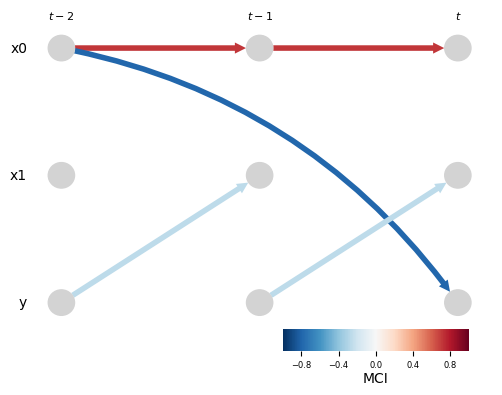

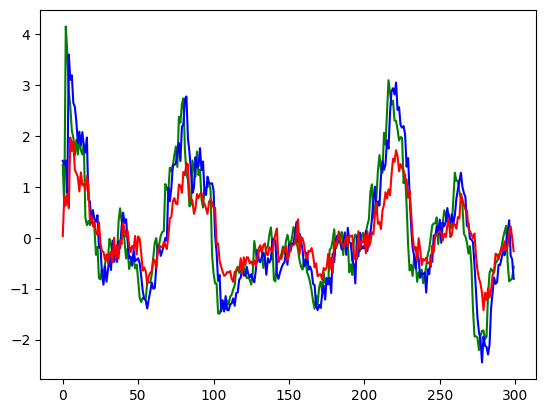

(298, 1) (298, 1) (298, 1)
CMI: 1.4057203744934477
CMI: 0.7881530313831282
Highest CMI score: 1.4057203744934477
Adding original feature: 0
Highest CMI score: -0.040215895725373985
[0]
CMI: 0.21229112767931868
Highest CMI score: 0.21229112767931868
Adding original feature: 0
Highest CMI score: -0.03284603174064116
[0]




## Significant links at alpha = 0.05:

    Variable 0 has 4 link(s):
        (0 -1): pval = 0.00000 | val =  0.713
        (1 -1): pval = 0.01669 | val = -0.139
        (2 -2): pval = 0.02261 | val = -0.133
        (1 -2): pval = 0.02638 | val = -0.129

    Variable 1 has 1 link(s):
        (2 -1): pval = 0.00000 | val =  0.492

    Variable 2 has 2 link(s):
        (0 -2): pval = 0.00000 | val =  0.954
        (2 -2): pval = 0.00110 | val =  0.190


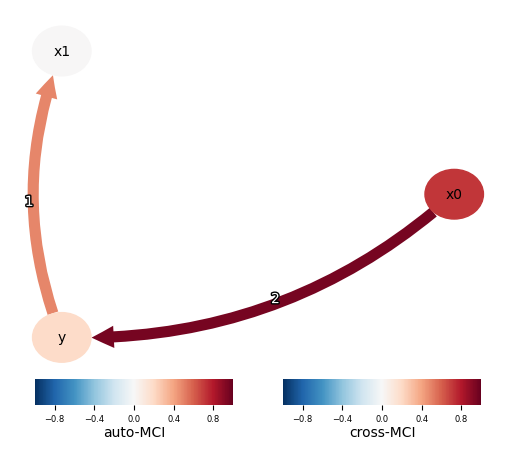

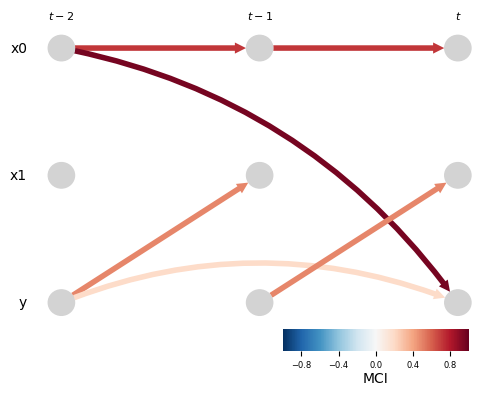

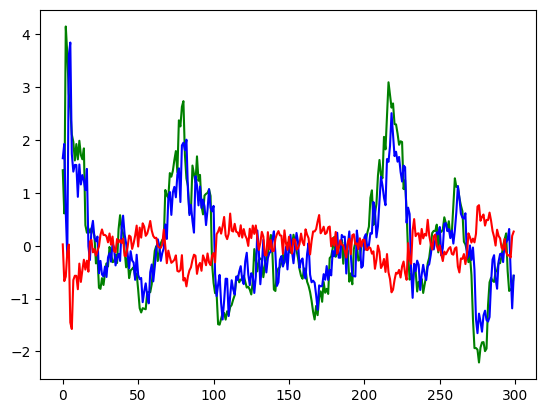

(298, 1) (298, 1) (298, 1)
CMI: 1.163666996452259
CMI: 0.4560488938146649
Highest CMI score: 1.163666996452259
Adding original feature: 0
Highest CMI score: -0.052330331823966514
[0]
CMI: 0.3273181204900466
CMI: 0.011941950055601391
Highest CMI score: 0.3273181204900466
Adding original feature: 0
Highest CMI score: -0.020476837155905203
[0]




## Significant links at alpha = 0.05:

    Variable 0 has 1 link(s):
        (0 -1): pval = 0.00000 | val =  0.713

    Variable 1 has 1 link(s):
        (2 -1): pval = 0.00000 | val = -0.435

    Variable 2 has 2 link(s):
        (0 -2): pval = 0.00000 | val =  0.960
        (2 -2): pval = 0.00000 | val = -0.390


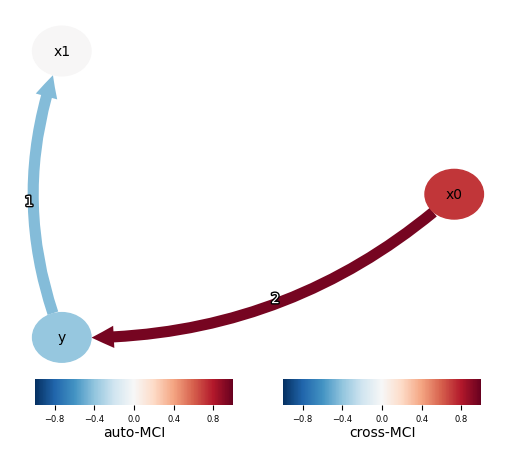

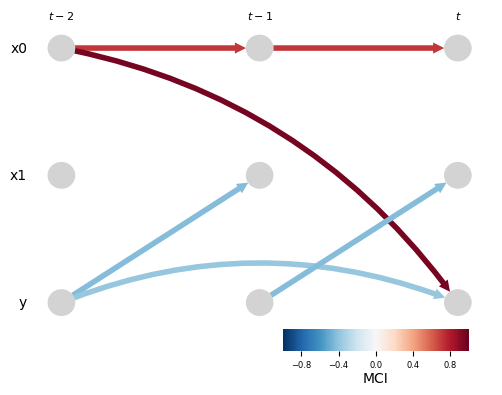

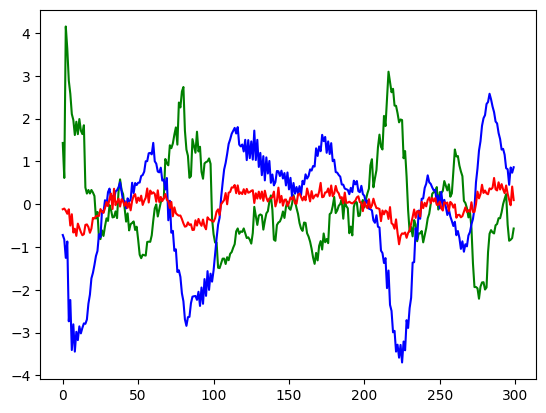

(298, 1) (298, 1) (298, 1)
CMI: 0.624128819624683
CMI: 0.7385782538517003
Highest CMI score: 0.7385782538517003
Adding original feature: 1
CMI: 0.03424450766846543
Highest CMI score: 0.03424450766846543
Adding original feature: 0
[1, 0]
Highest CMI score: -0.005936660461686394
[]




## Significant links at alpha = 0.05:

    Variable 0 has 3 link(s):
        (0 -1): pval = 0.00000 | val =  0.713
        (2 -1): pval = 0.02048 | val =  0.135
        (1 -2): pval = 0.04973 | val =  0.114

    Variable 1 has 2 link(s):
        (2 -1): pval = 0.01174 | val =  0.147
        (1 -2): pval = 0.04397 | val =  0.117

    Variable 2 has 3 link(s):
        (0 -2): pval = 0.00000 | val = -0.837
        (2 -2): pval = 0.00000 | val =  0.603
        (1 -2): pval = 0.03064 | val = -0.126


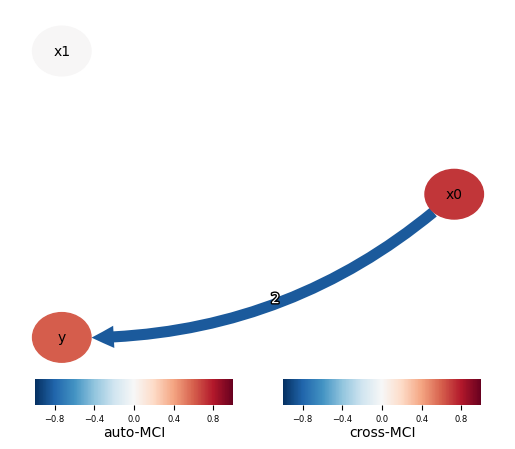

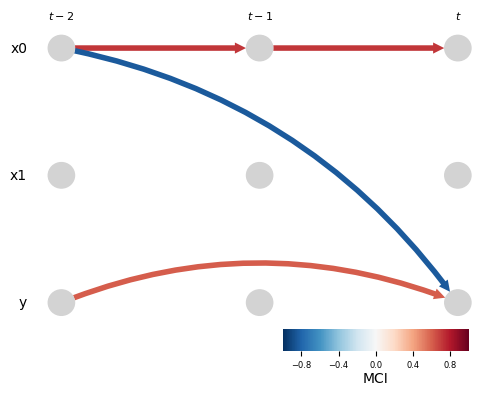

9 10 17 20
4 0 0 20


In [168]:
correct_CMI_forward = 0
wrong_CMI_forward = 0
correct_CMIwithTar_forward = 0
wrong_CMIwithTar_forward = 0
correct_TE_forward = 0
wrong_TE_forward = 0
tot_links = 0
correct_links = set([0,2])
seed = 0

for co in range(10):   
    rng = np.random.default_rng(seed=co)
    random.seed(co)
    np.random.seed(co)
    
    x0 = data_for_X0.iloc[:302].values
    plt.plot(x0[2:],'g')
    
    y = list(np.zeros(302))
    for i in range(300):
        next_val = y[i]*c[co][0] + x0[i]*c[co][1] + np.random.randn() * 0.1
        y[i+2] = next_val[0]
    plt.plot(y[2:],'b')
    
    x1 = list(np.zeros(302))
    for i in range(300):
        next_val = y[i+1]*d[co] + np.random.randn() * 0.1
        x1[i+2] = next_val
    plt.plot(x1[2:],'r')
    plt.show()
    
    x0 = np.array(x0)[2:].reshape(-1,1)
    x1 = np.array(x1)[2:].reshape(-1,1)
    y = np.array(y)[2:].reshape(-1,1)
    print(x0[2:].shape, x1[2:].shape, y[2:].shape)

    x = np.concatenate((x0,x1),axis=1)
    #x = x[100:]
    #y = y[100:]
    
    res = {
            "delta" : [], # list with all deltas
            "numSelected" : [], #
            "selectedFeatures" : [] 
        #    "accuracy" : [] # list of scores associated with the reduced problem
        }
    
    sel = forwardFeatureSelection(threshold=100,features=x,target=y,res=res,k=20, nproc=1, tau=2)
    print(sel)
    CMI_forward_selected = set(sel)

    res = {
            "delta" : [], # list with all deltas
            "numSelected" : [], #
            "selectedFeatures" : [] 
        #    "accuracy" : [] # list of scores associated with the reduced problem
        }
    
    sel = TE_forwardFeatureSelection(threshold=100,features=x,target=y,res=res,k=20, nproc=1, tau=2)
    print(sel)
    TE_forward_selected = set(sel)
    print('\n\n')
    
    correct_CMI_forward += len([found for found in CMI_forward_selected if found in correct_links])
    wrong_CMI_forward += len(CMI_forward_selected) - len([found for found in CMI_forward_selected if found in correct_links])
    correct_CMIwithTar_forward += len([found for found in CMI_forwardWithTar_selected if found in correct_links])
    wrong_CMIwithTar_forward += len(CMI_forwardWithTar_selected) - len([found for found in CMI_forwardWithTar_selected if found in correct_links])
    correct_TE_forward += len([found for found in TE_forward_selected if found in correct_links])+1
    wrong_TE_forward += len(TE_forward_selected) - len([found for found in TE_forward_selected if found in correct_links])
    tot_links += len(correct_links)
    
    run_PCMCI(pd.DataFrame(np.concatenate((x,y),axis=1), columns = ['x0','x1','y']),tau=2,cond_test=ParCorr())
    #run_PCMCI(pd.DataFrame(np.concatenate((x,y),axis=1), columns = ['x0','x1','y']),tau=2,cond_test=CMIknn())
    
print(correct_CMI_forward, correct_CMIwithTar_forward, correct_TE_forward, tot_links)
print(wrong_CMI_forward, wrong_CMIwithTar_forward, wrong_TE_forward, tot_links)


### old

In [55]:
seed=0

for i in range(10):

    x0 = list(rng.uniform(-1,1,size=2))
    for i in range(300 - 2):
        next_val = x0[-1]*b[i] + np.random.randn() * 0.1
        x0.append(next_val)
    plt.plot(x0)
    plt.show()
    
    y = list(rng.uniform(-1,1,size=2))
    c = [rng.uniform(-1,1),rng.uniform(-1,1)]
    for i in range(300 - 2):
        next_val = y[-2]*c[i][0] + x0[i]*c[i][1] + np.random.randn() * 0.1
        y.append(next_val)
    plt.plot(y)
    plt.show()
    
    x1 = list(rng.uniform(-1,1,size=2))
    d = rng.uniform(-1,1)
    for i in range(300 - 2):
        next_val = y[i+1]*d[i] + np.random.randn() * 0.1
        x1.append(next_val)
    plt.plot(x1)
    plt.show()
    
    x = np.concatenate((np.array(x0).reshape(-1,1),np.array(x1).reshape(-1,1)),axis=1)
    x = x[10:]
    y = np.array(y)
    y = y[10:]
    
    res = {
            "delta" : [], # list with all deltas
            "numSelected" : [], #
            "selectedFeatures" : [] 
        #    "accuracy" : [] # list of scores associated with the reduced problem
        }
    
    sel = forwardFeatureSelection(threshold=100,features=x,target=y,res=res,k=20, nproc=1, tau=5)
    print(sel)
    
    res = {
            "delta" : [], # list with all deltas
            "numSelected" : [], #
            "selectedFeatures" : [] 
        #    "accuracy" : [] # list of scores associated with the reduced problem
        }
    
    sel = forwardFeatureSelection(threshold=100,features=np.concatenate((x,y.reshape(-1,1)),axis=1),target=y,res=res,k=20, nproc=1, tau=5)
    print(sel)
    
    res = {
            "delta" : [], # list with all deltas
            "numSelected" : [], #
            "selectedFeatures" : [] 
        #    "accuracy" : [] # list of scores associated with the reduced problem
        }
    
    sel = TE_forwardFeatureSelection(threshold=100,features=np.concatenate((x,y.reshape(-1,1)),axis=1),target=y,res=res,k=20, nproc=1, tau=5)
    print(sel)
    print('\n\n')


IndexError: list index out of range

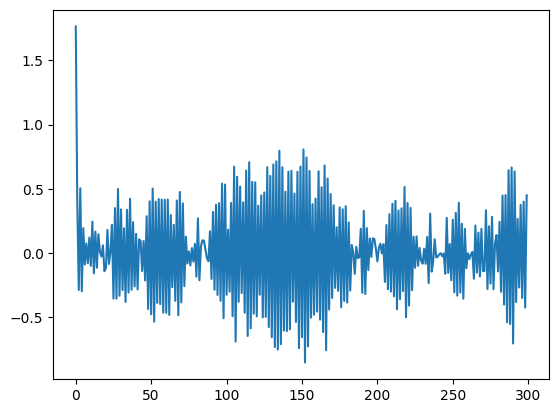

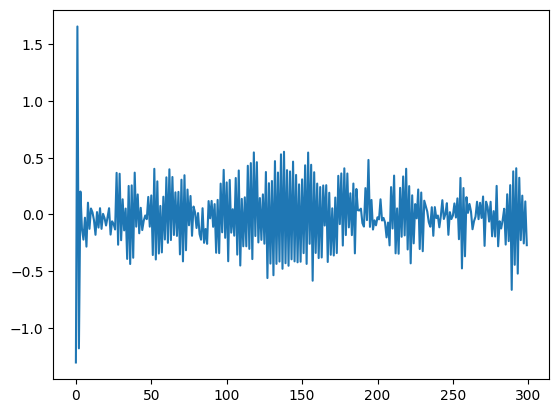

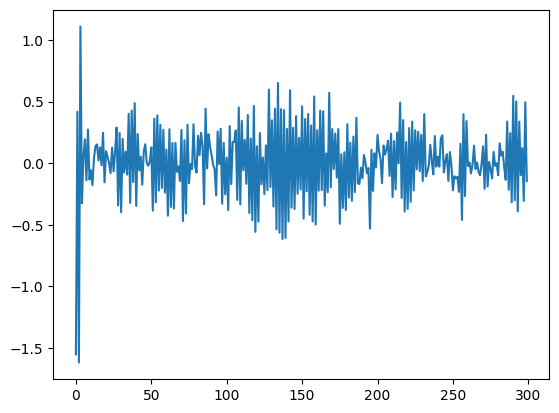

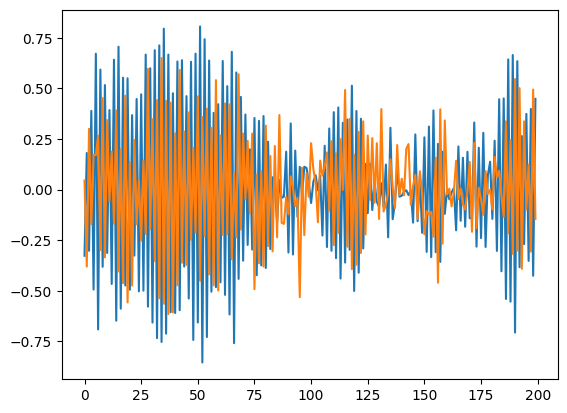

CMI: 0.7148678028495435
CMI: 0.4878187271566853
Highest CMI score: 0.7148678028495435
Adding original feature: 0
Highest CMI score: -0.19012106824064268
[0]
CMI: 0.7148678028495435
CMI: 0.4878187271566853
CMI: 0.5928507856797817
Highest CMI score: 0.7148678028495435
Adding original feature: 0
Highest CMI score: -0.12461068679709686
[0]
Highest CMI score: 0.0
[]





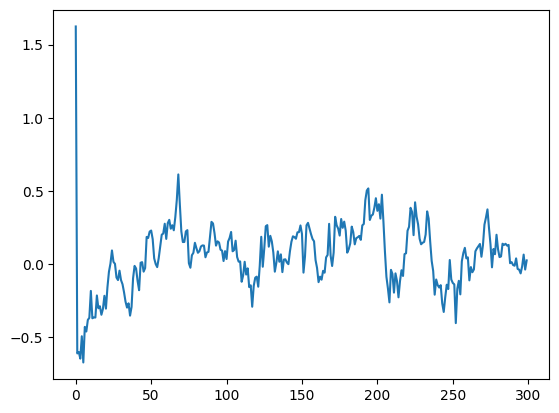

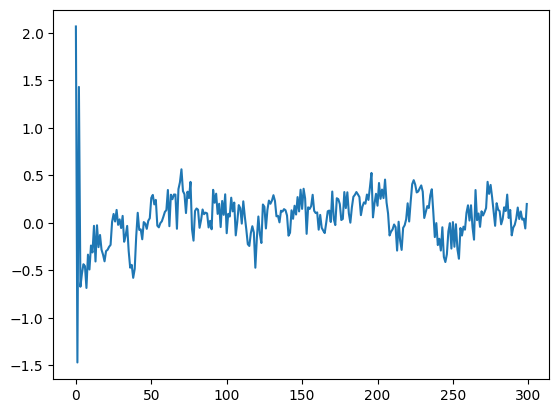

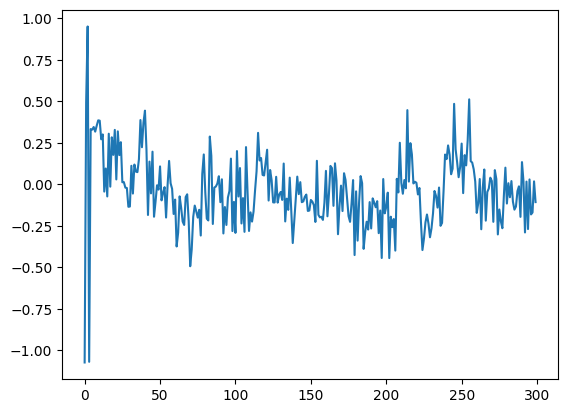

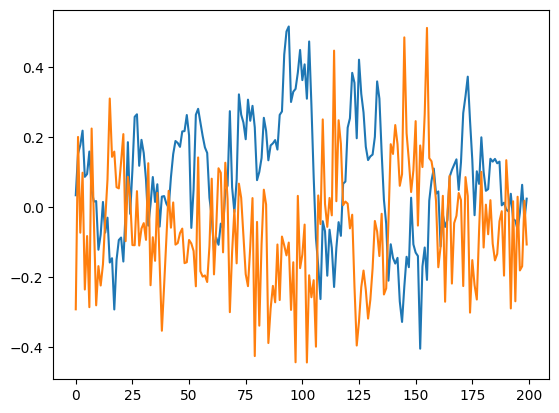

CMI: 0.38134160499925085
CMI: 0.07819935316094384
Highest CMI score: 0.38134160499925085
Adding original feature: 0
Highest CMI score: -0.1561845338192064
[0]
CMI: 0.38134160499925085
CMI: 0.07819935316094384
CMI: 0.15014607879527225
Highest CMI score: 0.38134160499925085
Adding original feature: 0
Highest CMI score: -0.14028273337612737
[0]
CMI: 0.09091279282785122
Highest CMI score: 0.09091279282785122
Adding original feature: 0
Highest CMI score: 0.0
[0]





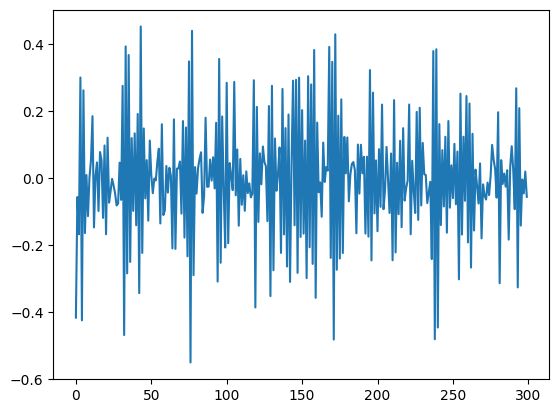

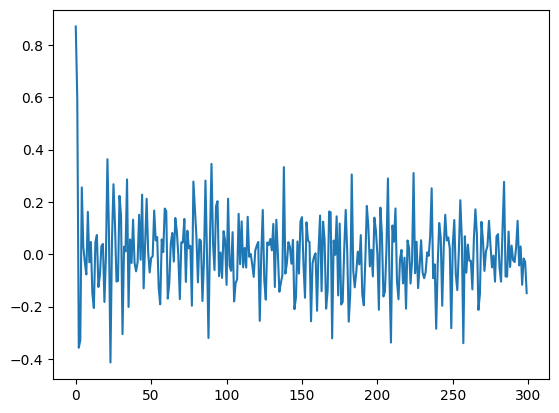

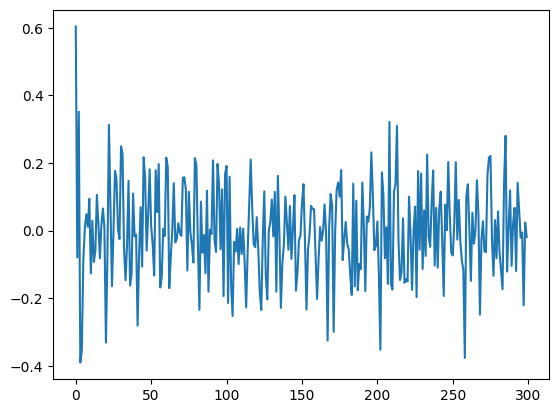

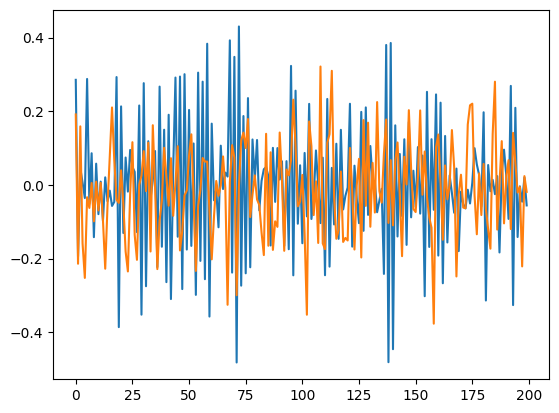

CMI: 0.04092179798374217
CMI: 0.022939202300703215
Highest CMI score: 0.04092179798374217
Adding original feature: 0
Highest CMI score: -0.009218676293581564
[0]
CMI: 0.04092179798374217
CMI: 0.022939202300703215
CMI: 0.04048293448556901
Highest CMI score: 0.04092179798374217
Adding original feature: 0
CMI: 0.008428158550463916
Highest CMI score: 0.008428158550463916
Adding original feature: 2
Highest CMI score: -0.00920818618741686
[0, 2]
CMI: 0.008867022048637076
Highest CMI score: 0.008867022048637076
Adding original feature: 0
Highest CMI score: 0.0
[0]





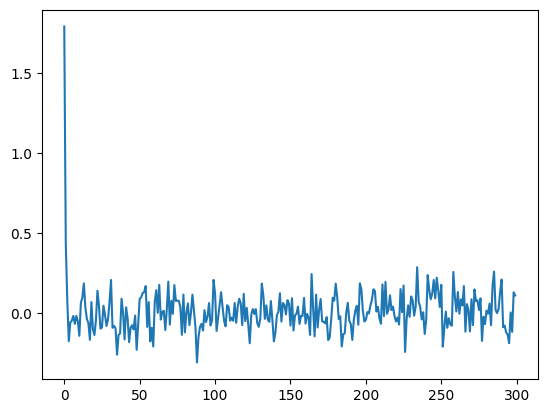

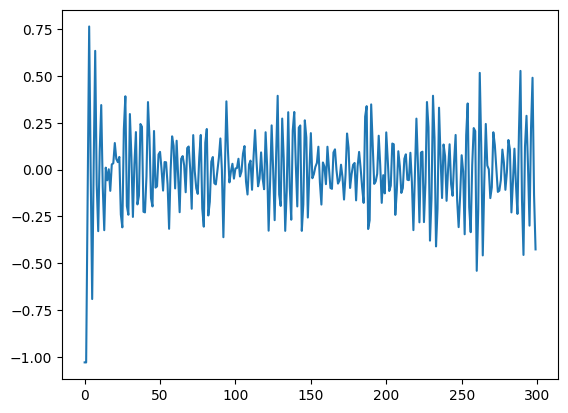

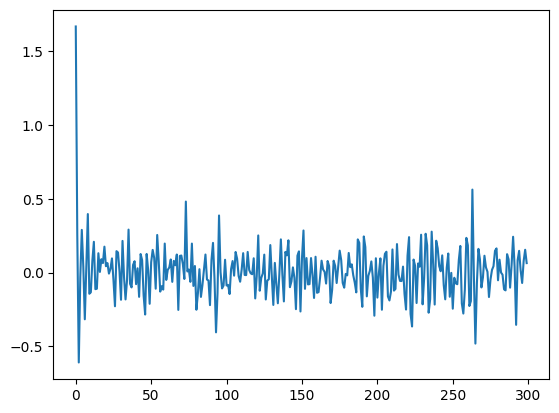

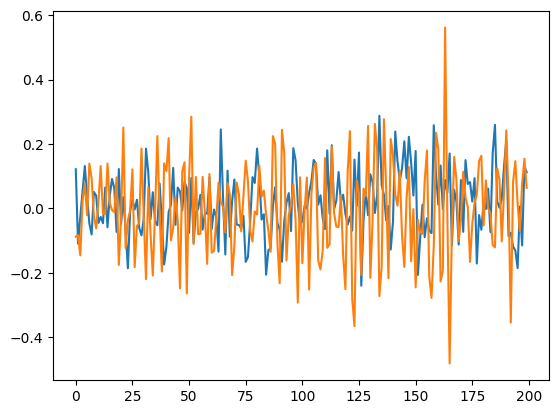

CMI: 0.04548362898305647
CMI: 0.16733645567769737
Highest CMI score: 0.16733645567769737
Adding original feature: 1
CMI: 0.002362784636731341
Highest CMI score: 0.002362784636731341
Adding original feature: 0
[1, 0]
CMI: 0.04548362898305647
CMI: 0.16733645567769737
CMI: 0.29444090756781344
Highest CMI score: 0.29444090756781344
Adding original feature: 2
Highest CMI score: -0.039451480666918004
[2]
Highest CMI score: 0.0
[]





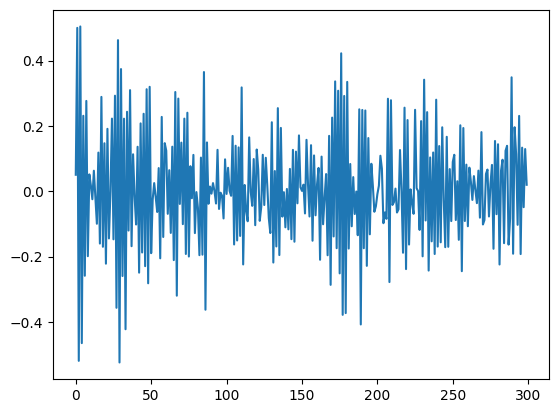

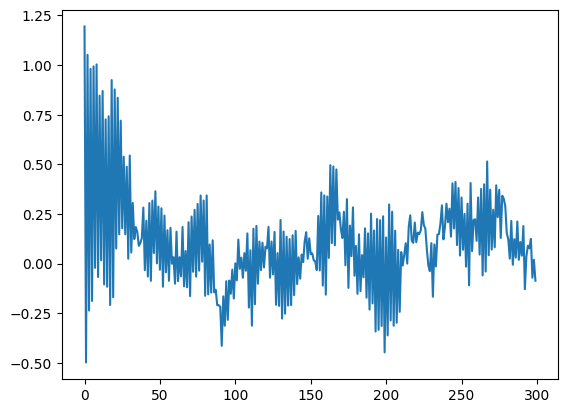

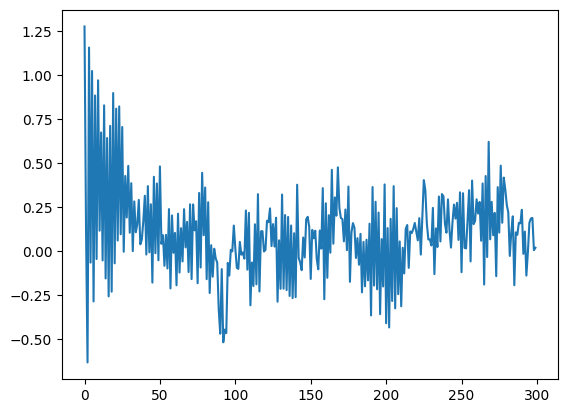

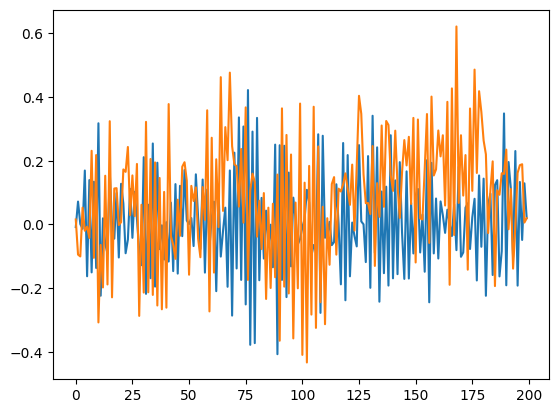

CMI: 0.028867778452427422
CMI: 0.24043336967988344
Highest CMI score: 0.24043336967988344
Adding original feature: 1
Highest CMI score: -0.049338957023409014
[1]
CMI: 0.028867778452427422
CMI: 0.24043336967988344
CMI: 0.4184367078781452
Highest CMI score: 0.4184367078781452
Adding original feature: 2
Highest CMI score: -0.14770115777997228
[2]
Highest CMI score: 0.0
[]





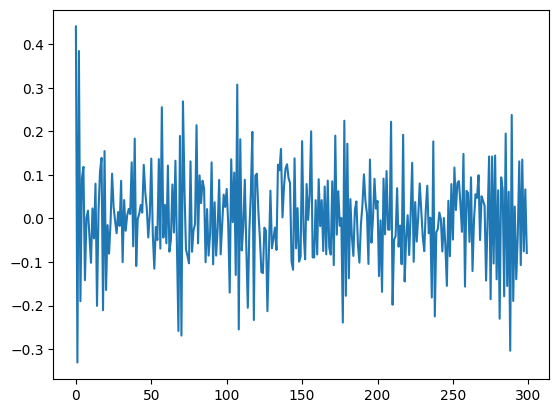

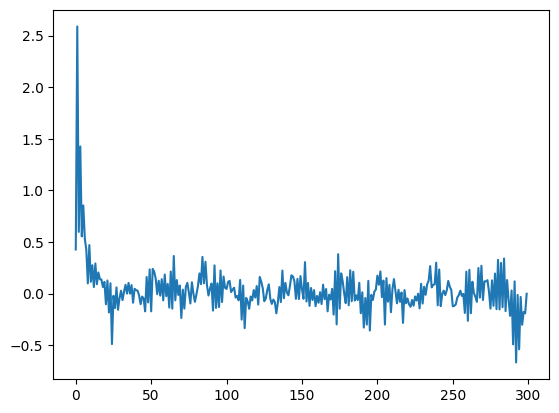

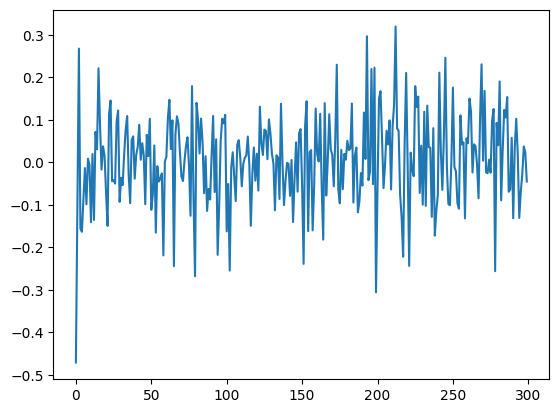

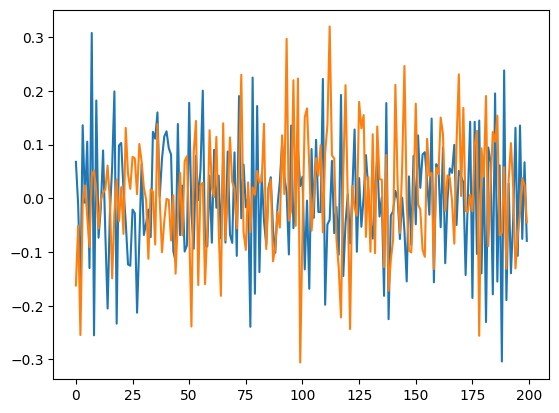

CMI: 0.07799351547763266
Highest CMI score: 0.07799351547763266
Adding original feature: 0
Highest CMI score: -0.03698131831788488
[0]
CMI: 0.07799351547763266
CMI: 0.1371056999271848
Highest CMI score: 0.1371056999271848
Adding original feature: 2
CMI: 0.003012891853360039
Highest CMI score: 0.003012891853360039
Adding original feature: 0
Highest CMI score: -0.03177063828648796
[2, 0]
CMI: 0.003012891853360039
Highest CMI score: 0.003012891853360039
Adding original feature: 0
Highest CMI score: 0.0
[0]





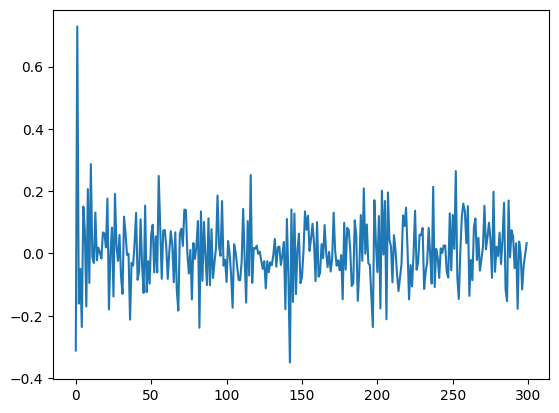

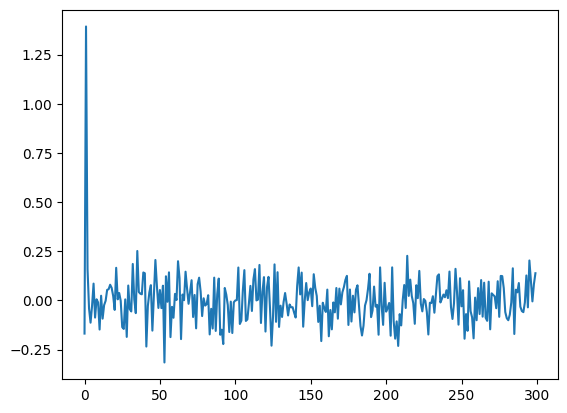

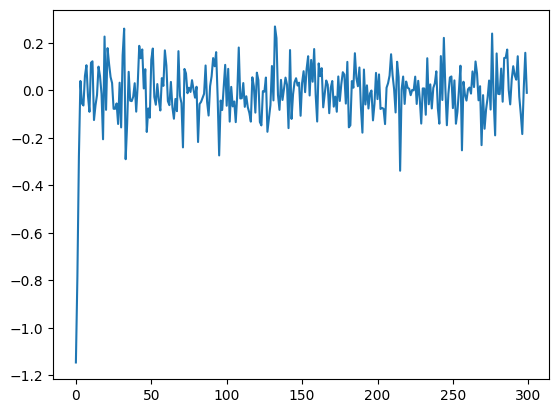

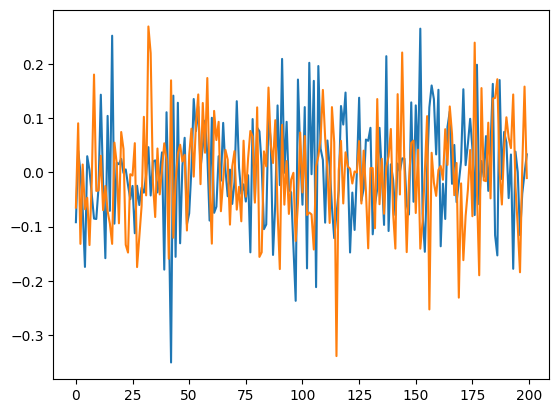

CMI: 0.01605045378085905
CMI: 0.02056455760642766
Highest CMI score: 0.02056455760642766
Adding original feature: 1
Highest CMI score: -0.010480038065677042
[1]
CMI: 0.01605045378085905
CMI: 0.02056455760642766
Highest CMI score: 0.02056455760642766
Adding original feature: 1
Highest CMI score: -0.010480038065677042
[1]
CMI: 0.018795293458670995
CMI: 0.012878795461108587
Highest CMI score: 0.018795293458670995
Adding original feature: 0
Highest CMI score: 0.0
[0]





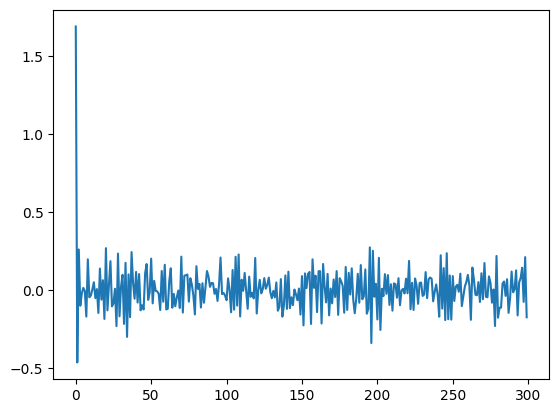

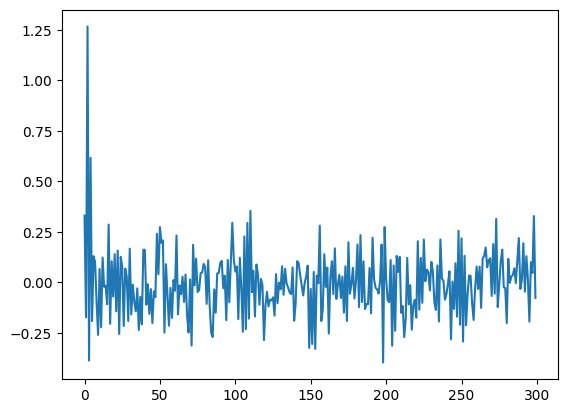

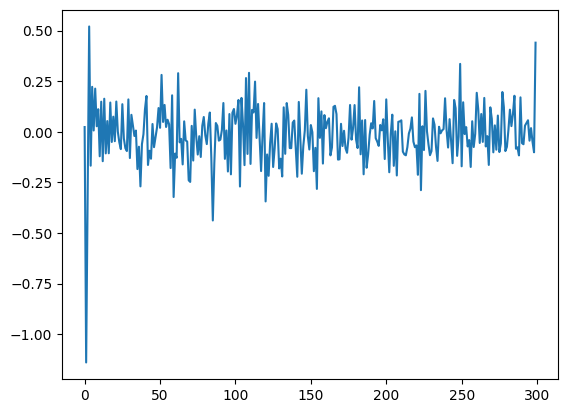

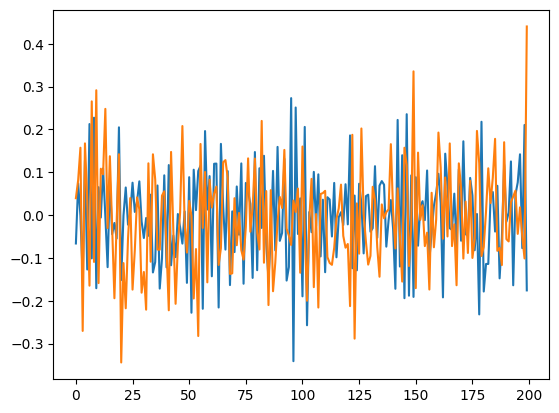

CMI: 0.20366007435972902
Highest CMI score: 0.20366007435972902
Adding original feature: 0
Highest CMI score: -0.10636222655678902
[0]
CMI: 0.20366007435972902
CMI: 0.042882998010022016
Highest CMI score: 0.20366007435972902
Adding original feature: 0
Highest CMI score: -0.08980134674302924
[0]
CMI: 0.07097572960667778
Highest CMI score: 0.07097572960667778
Adding original feature: 0
Highest CMI score: 0.0
[0]





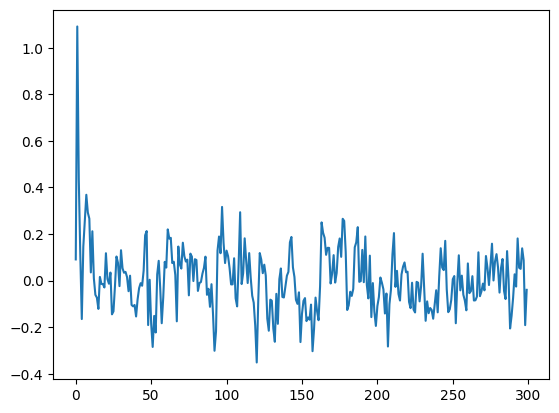

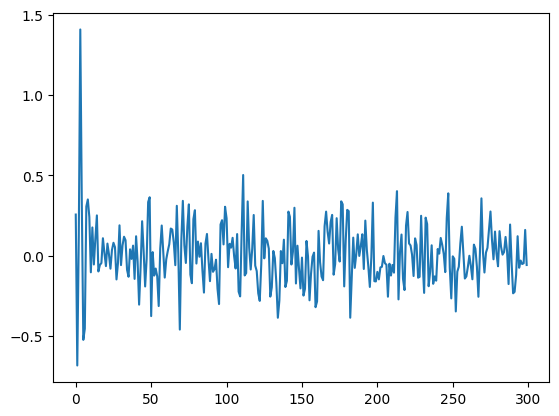

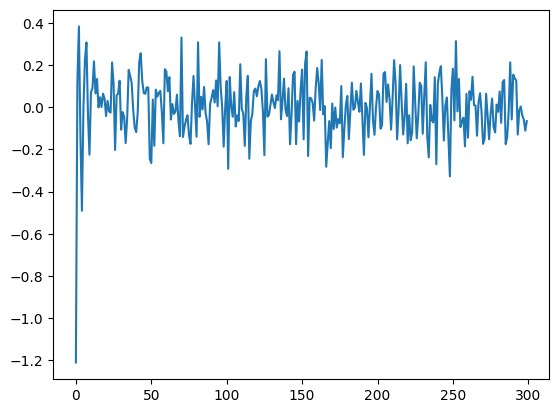

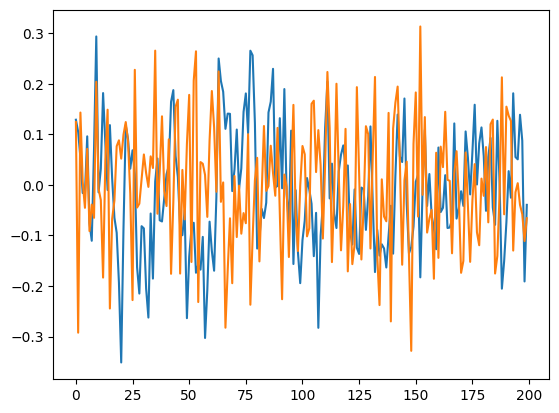

CMI: 0.17690497046079365
CMI: 0.024650328358016328
Highest CMI score: 0.17690497046079365
Adding original feature: 0
Highest CMI score: -0.07349397029999445
[0]
CMI: 0.17690497046079365
CMI: 0.024650328358016328
CMI: 0.037609899753360036
Highest CMI score: 0.17690497046079365
Adding original feature: 0
Highest CMI score: -0.07349397029999445
[0]
CMI: 0.0491335425938674
Highest CMI score: 0.0491335425938674
Adding original feature: 0
Highest CMI score: 0.0
[0]





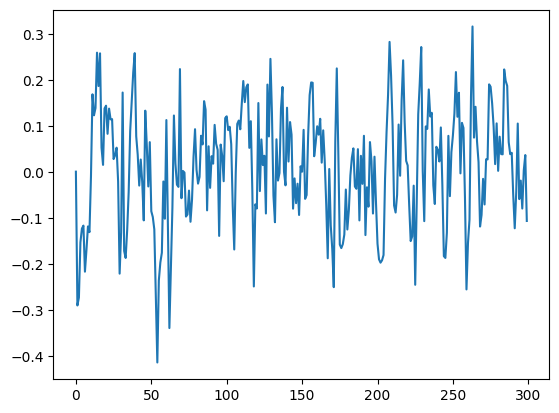

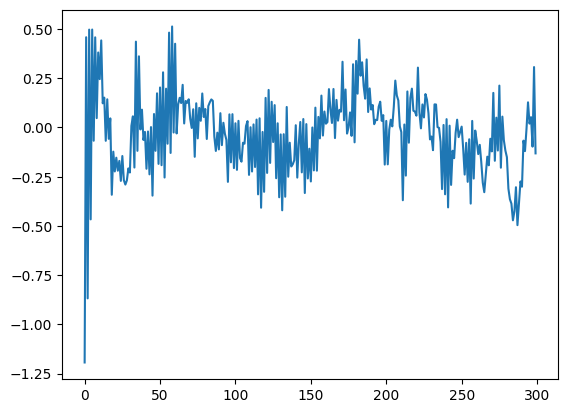

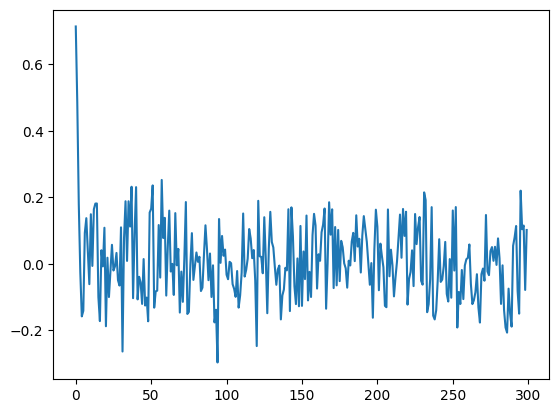

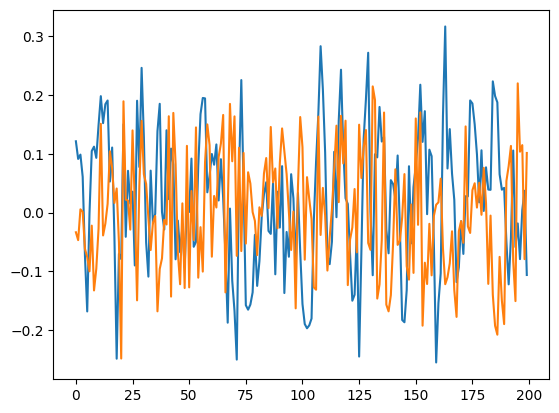

CMI: 0.03710650982376534
CMI: 0.04350613096226644
Highest CMI score: 0.04350613096226644
Adding original feature: 1
CMI: 0.0241206125497443
Highest CMI score: 0.0241206125497443
Adding original feature: 0
[1, 0]
CMI: 0.03710650982376534
CMI: 0.04350613096226644
CMI: 0.21697479454278681
Highest CMI score: 0.21697479454278681
Adding original feature: 2
Highest CMI score: -0.025153104061293424
[2]
Highest CMI score: 0.0
[]



8 11 16 20
4 1 0 20


In [78]:
### Same of above, keeping track on correct/wrong links detected

correct_CMI_forward = 0
wrong_CMI_forward = 0
correct_CMIwithTar_forward = 0
wrong_CMIwithTar_forward = 0
correct_TE_forward = 0
wrong_TE_forward = 0
tot_links = 0
correct_links = set([0,2])
seed = 0

for co in range(10):   
    rng = np.random.default_rng(seed=co)
    random.seed(co)
    np.random.seed(co)
    
    x0 = list(np.random.randn(2)) #list(rng.uniform(-1,1,size=2))
    for i in range(300 - 2):
        next_val = x0[-1]*b[co] + np.random.randn() * 0.1
        x0.append(next_val)
    plt.plot(x0)
    plt.show()
    
    y = list(np.random.randn(2)) #list(rng.uniform(-1,1,size=2))
    #c = [rng.uniform(-1,1),rng.uniform(-1,1)]
    for i in range(300 - 2):
        next_val = y[-2]*c[co][0] + x0[i]*c[co][1] + np.random.randn() * 0.1
        y.append(next_val)
    plt.plot(y)
    plt.show()
    
    x1 = list(np.random.randn(2)) #list(rng.uniform(-1,1,size=2))
    #d = rng.uniform(-1,1)
    for i in range(300 - 2):
        next_val = y[i+1]*d[co] + np.random.randn() * 0.1
        x1.append(next_val)
    plt.plot(x1)
    plt.show()
    
    x = np.concatenate((np.array(x0).reshape(-1,1),np.array(x1).reshape(-1,1)),axis=1)
    x = x[100:]
    y = np.array(y)
    y = y[100:]
    plt.plot(x)
    plt.show()
    
    res = {
            "delta" : [], # list with all deltas
            "numSelected" : [], #
            "selectedFeatures" : [] 
        #    "accuracy" : [] # list of scores associated with the reduced problem
        }
    
    sel = forwardFeatureSelection(threshold=100,features=x,target=y,res=res,k=20, nproc=1, tau=5)
    print(sel)
    CMI_forward_selected = set(sel)
    
    res = {
            "delta" : [], # list with all deltas
            "numSelected" : [], #
            "selectedFeatures" : [] 
        #    "accuracy" : [] # list of scores associated with the reduced problem
        }
    
    sel = forwardFeatureSelection(threshold=100,features=np.concatenate((x,y.reshape(-1,1)),axis=1),target=y,res=res,k=20, nproc=1, tau=5)
    print(sel)
    CMI_forwardWithTar_selected = set(sel)
    
    res = {
            "delta" : [], # list with all deltas
            "numSelected" : [], #
            "selectedFeatures" : [] 
        #    "accuracy" : [] # list of scores associated with the reduced problem
        }
    
    sel = TE_forwardFeatureSelection(threshold=100,features=np.concatenate((x,y.reshape(-1,1)),axis=1),target=y,res=res,k=20, nproc=1, tau=5)
    print(sel)
    TE_forward_selected = set(sel)
    print('\n\n')
    
    correct_CMI_forward += len([found for found in CMI_forward_selected if found in correct_links])
    wrong_CMI_forward += len(CMI_forward_selected) - len([found for found in CMI_forward_selected if found in correct_links])
    correct_CMIwithTar_forward += len([found for found in CMI_forwardWithTar_selected if found in correct_links])
    wrong_CMIwithTar_forward += len(CMI_forwardWithTar_selected) - len([found for found in CMI_forwardWithTar_selected if found in correct_links])
    correct_TE_forward += len([found for found in TE_forward_selected if found in correct_links])+1
    wrong_TE_forward += len(TE_forward_selected) - len([found for found in TE_forward_selected if found in correct_links])
    tot_links += len(correct_links)

print(correct_CMI_forward, correct_CMIwithTar_forward, correct_TE_forward, tot_links)
print(wrong_CMI_forward, wrong_CMIwithTar_forward, wrong_TE_forward, tot_links)


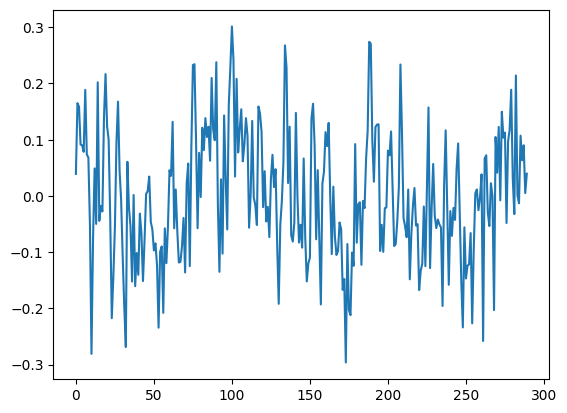

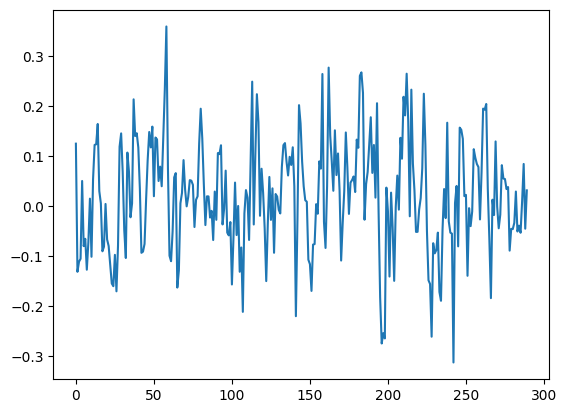

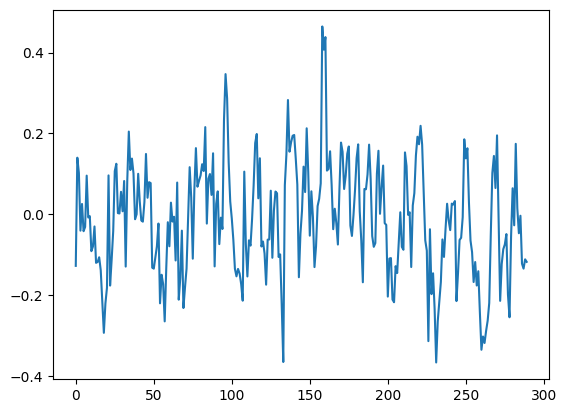

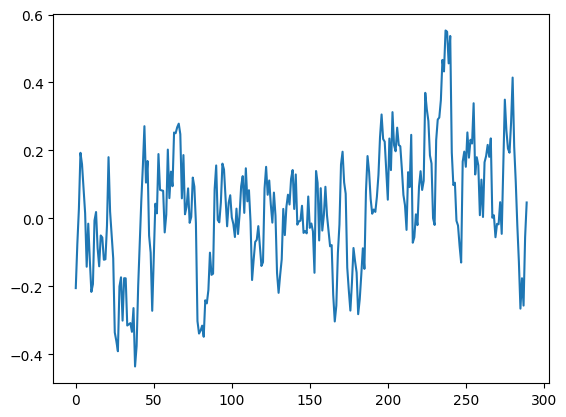

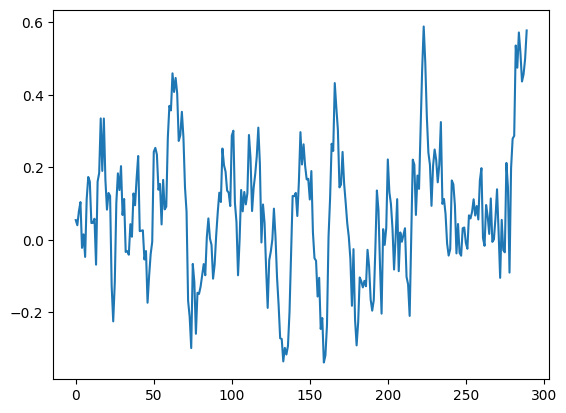

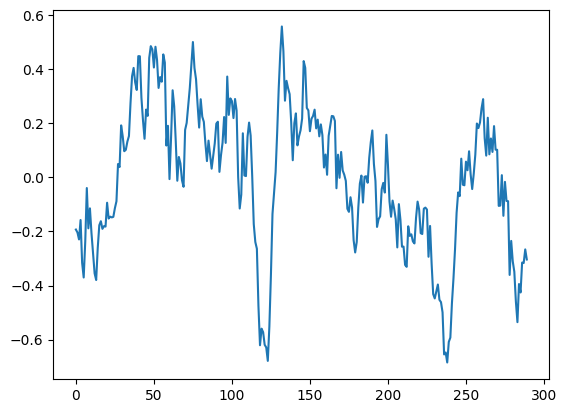

In [84]:
correct_CMI_forward = 0
wrong_CMI_forward = 0
correct_CMIwithTar_forward = 0
wrong_CMIwithTar_forward = 0
correct_TE_forward = 0
wrong_TE_forward = 0
tot_links = 0
correct_links = set([0,2])
seed = 0

b = [0.5, 0.6, 0.7, 0.8, 0.9, 0.95 ,0.99]

for co in range(6):   
    rng = np.random.default_rng(seed=co)
    random.seed(co)
    np.random.seed(co)
    
    x0 = list(np.random.randn(2)) #list(rng.uniform(-1,1,size=2))
    for i in range(300 - 2):
        next_val = x0[-1]*b[co] + np.random.randn() * 0.1
        x0.append(next_val)
    plt.plot(x0[10:])
    plt.show()

In [80]:
b

[-0.9669447289429418,
 0.8972988942744877,
 -0.8161681157298062,
 0.16432407212873557,
 -0.8383279522087956,
 -0.4283972398237168,
 -0.2510064688242353,
 -0.5495856200188163,
 0.5770978716400579,
 0.5550681658403576]

In [33]:
import pandas as pd

df = pd.read_csv('/Users/paolo/Documents/causalFS/linear-VAR_N-5_T-200/linear-VAR_N-5_T-200_0001.txt', sep=' ')
df

,A,b,c,d,e
0,2.80641,6.57078,1.08820,2.53514,2.10079
1,2.79277,6.33073,-1.23987,2.57083,1.35144
2,2.93772,6.09661,0.46500,3.91144,1.44121
3,2.75709,7.56969,-1.79315,3.12573,0.97699
4,1.99903,8.63173,1.85513,4.94825,1.63381
...,...,...,...,...,...
195,1.38810,5.16099,-1.32851,0.35834,0.24440
196,2.69252,4.82525,0.11920,-1.59691,1.76929
197,1.77415,4.06218,0.06064,1.06008,0.37689
198,2.90970,5.26970,-1.81707,1.37419,1.10868


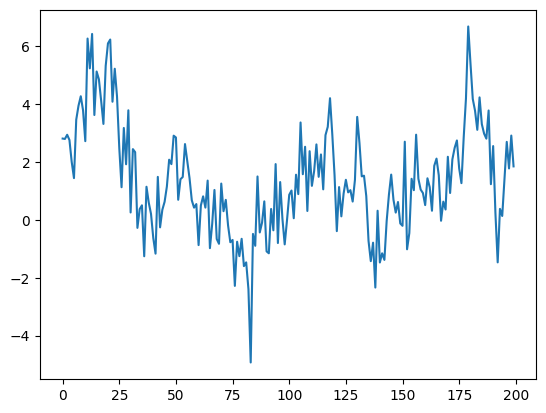

In [50]:
plt.plot(df['A'])

In [49]:
sel = forwardFeatureSelection(threshold=100,features=df.iloc[:,1:].values,target=df.iloc[:,0].values,res=res,k=20, nproc=1, tau=5)
print(sel)

sel = forwardFeatureSelection(threshold=100,features=df.values,target=df.iloc[:,0].values,res=res,k=20, nproc=1, tau=5)
print(sel)

sel = TE_forwardFeatureSelection(threshold=100,features=df.iloc[:,1:].values,target=df.iloc[:,0].values,res=res,k=20, nproc=1, tau=5)
print(sel)


CMI: 0.26914819649158755
CMI: 0.03938930544237297
CMI: 0.10334744554372989
CMI: 0.11023991304000715
Highest CMI score: 0.26914819649158755
Adding original feature: 0
Highest CMI score: -0.02438939409849214
[0]
CMI: 0.28064235458624776
CMI: 0.26914819649158755
CMI: 0.03938930544237297
CMI: 0.10334744554372989
CMI: 0.11023991304000715
Highest CMI score: 0.28064235458624776
Adding original feature: 0
Highest CMI score: -0.028603182588608944
[0]
Highest CMI score: -0.028603182588608944
[]


### selected coefficients, CI on R2

TypeError: 'tuple' object cannot be interpreted as an integer

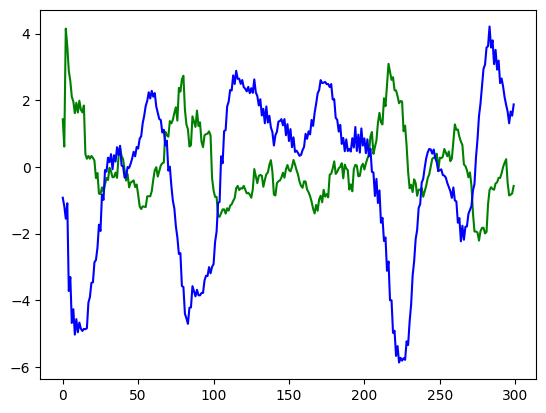

In [183]:
# check with specific coefficients

correct_CMI_forward = 0
wrong_CMI_forward = 0
correct_CMIwithTar_forward = 0
wrong_CMIwithTar_forward = 0
correct_TE_forward = 0
wrong_TE_forward = 0
tot_links = 0
correct_links = set([0,2])
seed = 0

for co in range(10):   
    rng = np.random.default_rng(seed=co)
    random.seed(co)
    np.random.seed(co)
    
    x0 = data_for_X0.iloc[:302].values
    plt.plot(x0[2:],'g')
    
    y = list(np.zeros(302))
    for i in range(300):
        next_val = y[i]*0.78 - x0[i]*0.65 + np.random.randn() * 0.1
        y[i+2] = next_val[0]
    plt.plot(y[2:],'b')
    
    x1 = list(np.zeros(302))
    for i in range(300):
        next_val = y[i+1]*0.69 + np.random.randn() * 0.1
        x1[i+2] = next_val
    plt.plot(x1[2:],'r')
    plt.show()
    
    x0 = np.array(x0).reshape(-1,1)
    x1 = np.array(x1).reshape(-1,1)
    y = np.array(y).reshape(-1,1)
    print(x0[2:].shape, x1[2:].shape, y[2:].shape)

    x = np.concatenate((x0,x1),axis=1)
    #x = x[100:]
    #y = y[100:]
    
    res = {
            "delta" : [], # list with all deltas
            "numSelected" : [], #
            "selectedFeatures" : [] 
        #    "accuracy" : [] # list of scores associated with the reduced problem
        }
    
    sel = forwardFeatureSelection(threshold=100,features=x,target=y,res=res,k=20, nproc=1, tau=2)
    print(sel)
    CMI_forward_selected = set(sel)
    
    res = {
            "delta" : [], # list with all deltas
            "numSelected" : [], #
            "selectedFeatures" : [] 
        #    "accuracy" : [] # list of scores associated with the reduced problem
        }
    
    sel = TE_forwardFeatureSelection(threshold=100,features=x,target=y,res=res,k=20, nproc=1, tau=2)
    print(sel)
    TE_forward_selected = set(sel)
    print('\n\n')
    
    correct_CMI_forward += len([found for found in CMI_forward_selected if found in correct_links])
    wrong_CMI_forward += len(CMI_forward_selected) - len([found for found in CMI_forward_selected if found in correct_links])
    correct_CMIwithTar_forward += len([found for found in CMI_forwardWithTar_selected if found in correct_links])
    wrong_CMIwithTar_forward += len(CMI_forwardWithTar_selected) - len([found for found in CMI_forwardWithTar_selected if found in correct_links])
    correct_TE_forward += len([found for found in TE_forward_selected if found in correct_links])+1
    wrong_TE_forward += len(TE_forward_selected) - len([found for found in TE_forward_selected if found in correct_links])
    tot_links += len(correct_links)
    
    run_PCMCI(pd.DataFrame(np.concatenate((x,y),axis=1), columns = ['x0','x1','y']),tau=2,cond_test=ParCorr())

print(correct_CMI_forward, correct_CMIwithTar_forward, correct_TE_forward, tot_links)
print(wrong_CMI_forward, wrong_CMIwithTar_forward, wrong_TE_forward, tot_links)


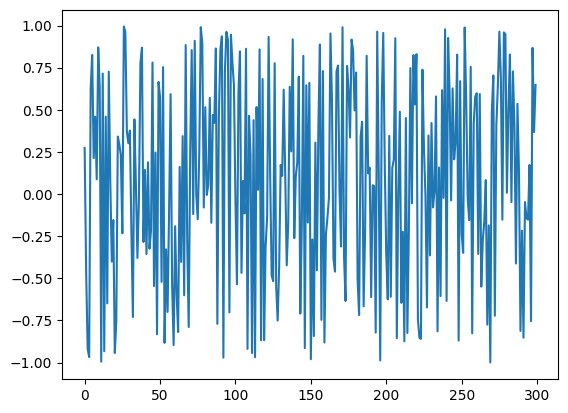

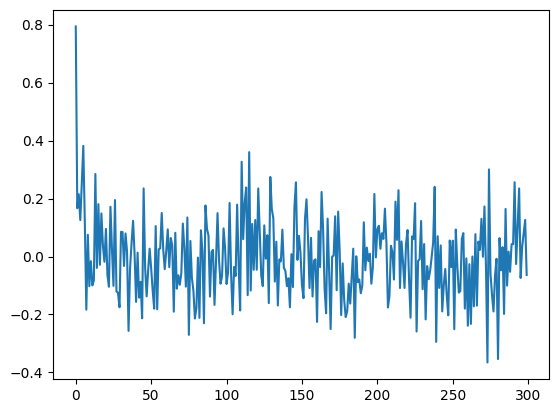

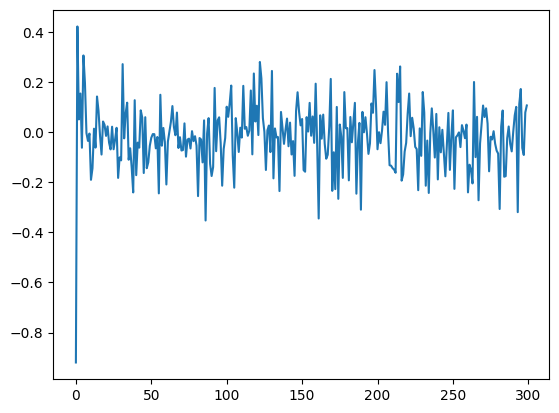

CMI: 0.00019138755980861125
Highest CMI score: 0.00019138755980861125
Adding original feature: 0
Highest CMI score: 0.0
[0]
CMI: 0.00019138755980861125
Highest CMI score: 0.00019138755980861125
Adding original feature: 0
Highest CMI score: 0.0
[0]
CMI: 0.010841290815881775
Highest CMI score: 0.010841290815881775
Adding original feature: 0
Highest CMI score: 0.0
[0]



Only x0_t-2: 0.4524521891102492

Only x1_t-1: -0.019458981699813194

Only y_t-2: 1.1415125367175705e-07

Only x0: 0.447251069577295

Only x1: -0.02487978338482799

Only y: 0.01551642197470604

x0 and y: 0.4631373764341532



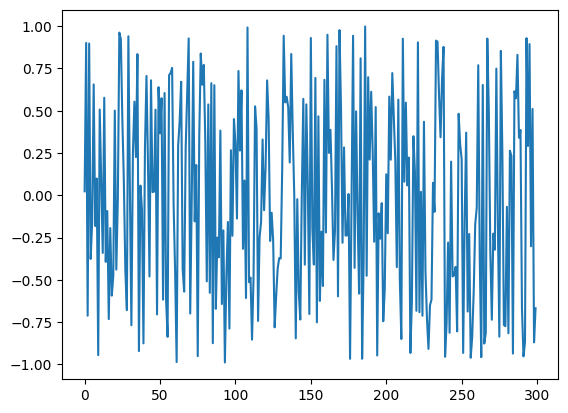

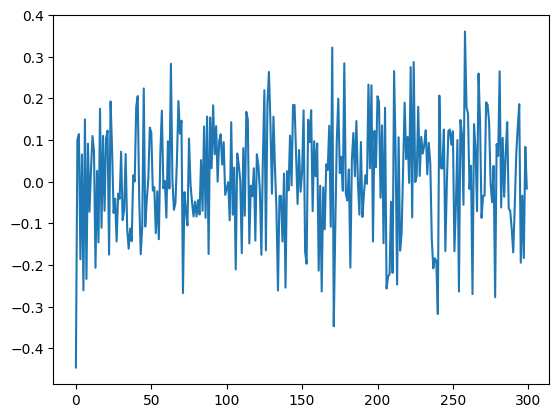

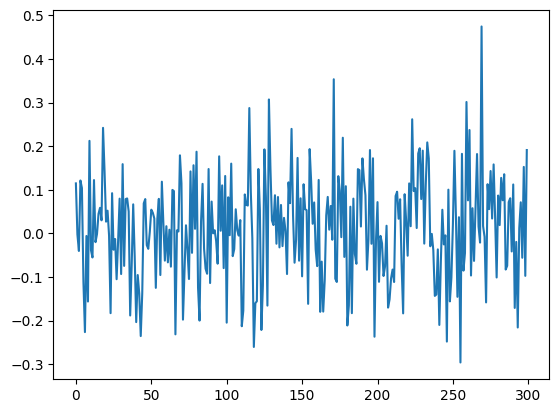

CMI: 0.00019138755980861125
Highest CMI score: 0.00019138755980861125
Adding original feature: 0
Highest CMI score: 0.0
[0]
CMI: 0.00019138755980861125
CMI: 0.019583251364973974
Highest CMI score: 0.019583251364973974
Adding original feature: 2
Highest CMI score: -0.009584564483203547
[2]
Highest CMI score: 0.0
[]



Only x0_t-2: 0.5184368579790034

Only x1_t-1: -0.010281743706707314

Only y_t-2: 0.009863066409356525

Only x0: 0.5168337925414352

Only x1: -0.011508691980745889

Only y: 0.0017912746266366408

x0 and y: 0.5445293332320578



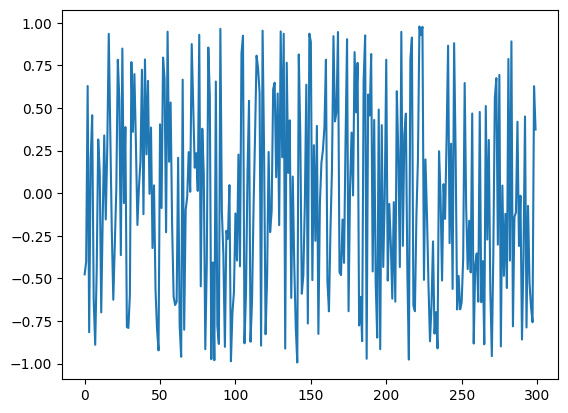

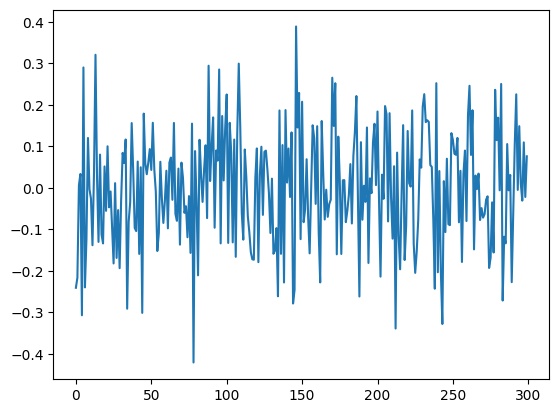

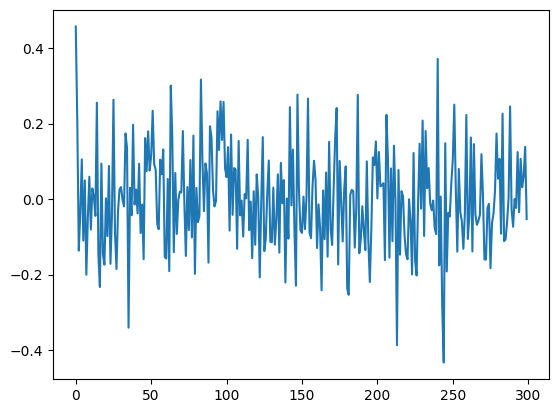

CMI: 0.00017390966846868262
Highest CMI score: 0.00017390966846868262
Adding original feature: 0
Highest CMI score: 0.0
[0]
CMI: 0.00017390966846868262
CMI: 0.017543660677198515
Highest CMI score: 0.017543660677198515
Adding original feature: 2
Highest CMI score: -0.008606184121121843
[2]
Highest CMI score: 0.0
[]



Only x0_t-2: 0.4284550019525022

Only x1_t-1: 0.006128363857432428

Only y_t-2: 0.03643123266528059

Only x0: 0.4230861446276498

Only x1: 0.011686261918974261

Only y: -0.007085354183121062

x0 and y: 0.4164038371972194



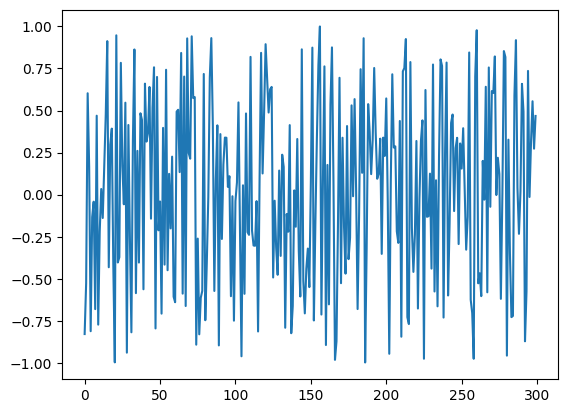

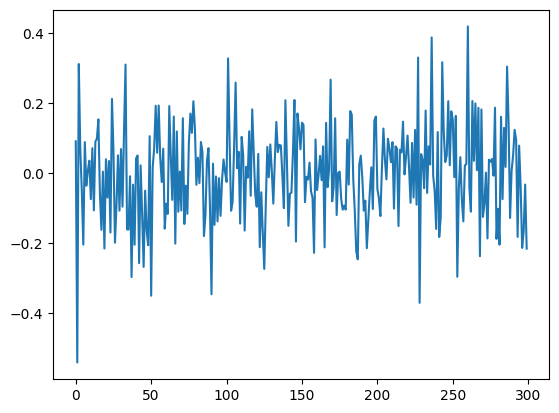

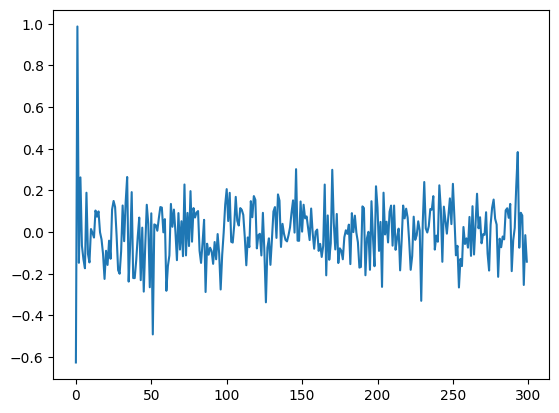

CMI: 0.0007251845047639405
CMI: 0.019745439610343727
Highest CMI score: 0.019745439610343727
Adding original feature: 1
Highest CMI score: -0.019020255105579788
[1]
CMI: 0.0007251845047639405
CMI: 0.019745439610343727
Highest CMI score: 0.019745439610343727
Adding original feature: 1
Highest CMI score: -0.015222673351350174
[1]
CMI: 0.009155069759476091
CMI: 0.012979242927158432
Highest CMI score: 0.012979242927158432
Adding original feature: 1
Highest CMI score: 0.0
[1]



Only x0_t-2: 0.38781598242447113

Only x1_t-1: -0.011884074924696897

Only y_t-2: -0.00403414570443994

Only x0: 0.35833714034749364

Only x1: -0.006326963421220633

Only y: -0.014982075528031435

x0 and y: 0.3995912548684094



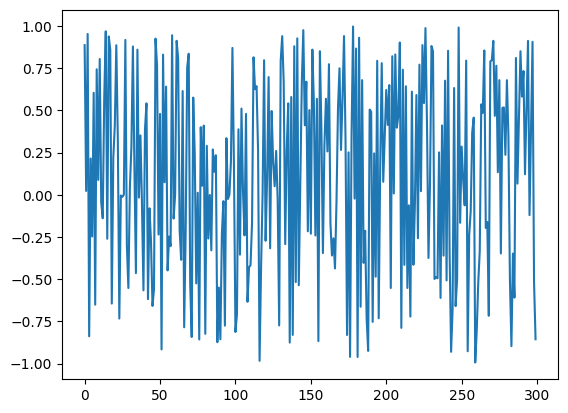

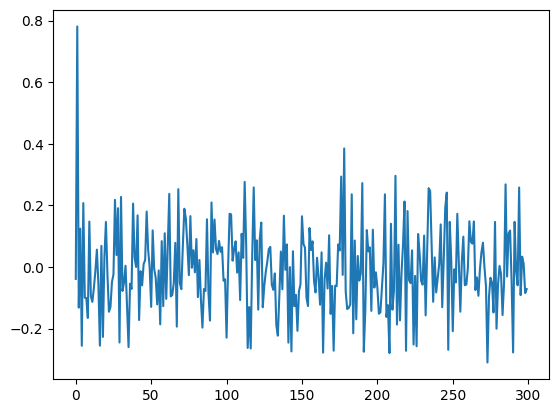

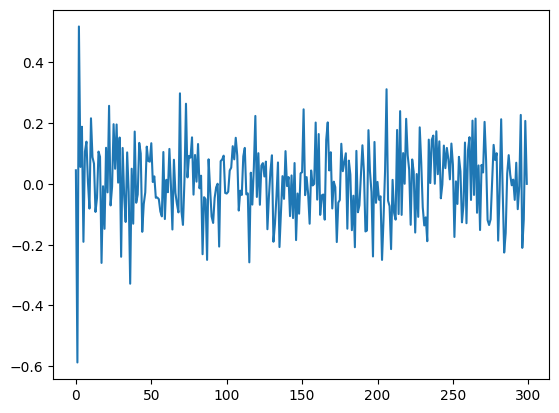

CMI: 0.00024447316033945985
CMI: 0.015221774891906632
Highest CMI score: 0.015221774891906632
Adding original feature: 1
Highest CMI score: -0.014977301731567173
[1]
CMI: 0.00024447316033945985
CMI: 0.015221774891906632
CMI: 0.007680441431031847
Highest CMI score: 0.015221774891906632
Adding original feature: 1
Highest CMI score: -0.013763558996083648
[1]
Highest CMI score: 0.0
[]



Only x0_t-2: 0.3337930817454201

Only x1_t-1: -0.04176940154854458

Only y_t-2: -0.039244095164993276

Only x0: 0.33622713563572393

Only x1: -0.028622109909071103

Only y: -0.03824649411243186

x0 and y: 0.3171437577677374



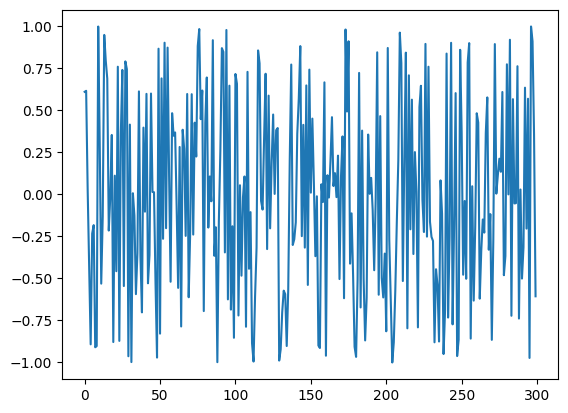

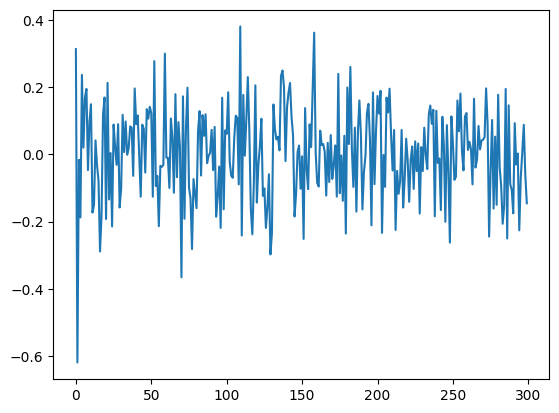

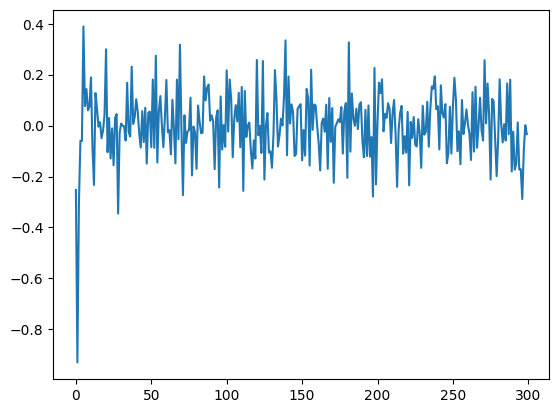

CMI: 0.0004313987891112637
CMI: 0.01401349012634543
Highest CMI score: 0.01401349012634543
Adding original feature: 1
Highest CMI score: -0.013582091337234167
[1]
CMI: 0.0004313987891112637
CMI: 0.01401349012634543
CMI: 0.0073330888129289305
Highest CMI score: 0.01401349012634543
Adding original feature: 1
CMI: 0.01217793315678629
Highest CMI score: 0.01217793315678629
Adding original feature: 2
Highest CMI score: -0.02576002449402046
[1, 2]
CMI: 0.01885833447020279
Highest CMI score: 0.01885833447020279
Adding original feature: 1
Highest CMI score: 0.0
[1]



Only x0_t-2: 0.3517731873375156

Only x1_t-1: -0.025095967687008836

Only y_t-2: -0.029961474652946185

Only x0: 0.3430596829842134

Only x1: -0.009395067379403876

Only y: -0.024125752789155852

x0 and y: 0.36471800267514964



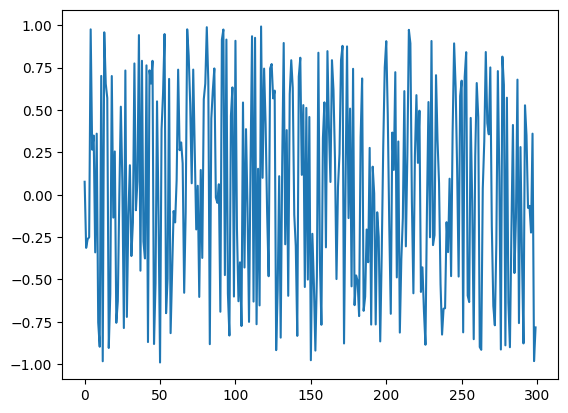

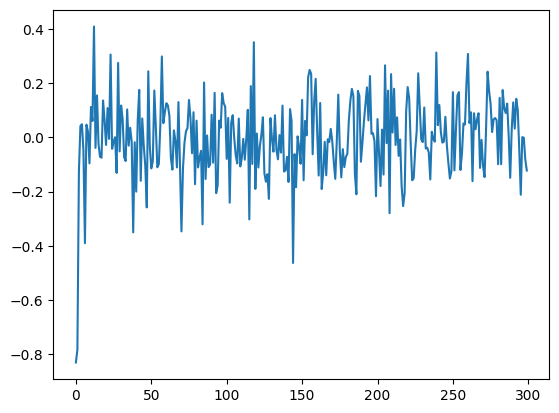

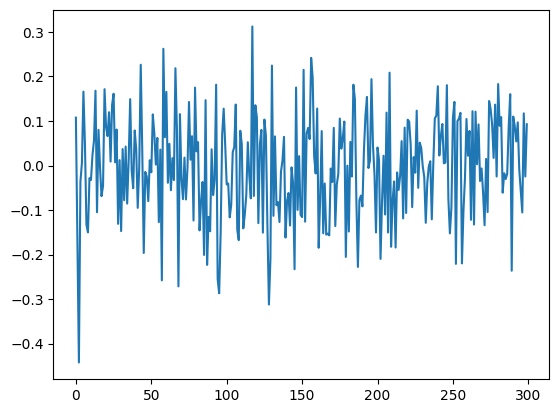

CMI: 0.0005027074470273711
Highest CMI score: 0.0005027074470273711
Adding original feature: 0
Highest CMI score: 0.0
[0]
CMI: 0.0005027074470273711
CMI: 0.00031518388457504746
Highest CMI score: 0.0005027074470273711
Adding original feature: 0
Highest CMI score: 0.0
[0]
CMI: 0.00018752356245232363
Highest CMI score: 0.00018752356245232363
Adding original feature: 0
Highest CMI score: 0.0
[0]



Only x0_t-2: 0.24761229548333952

Only x1_t-1: -0.05964376337812083

Only y_t-2: -0.07712544943772426

Only x0: 0.25037692137654377

Only x1: -0.05421767777251518

Only y: -0.08822490837761565

x0 and y: 0.2813006569331311



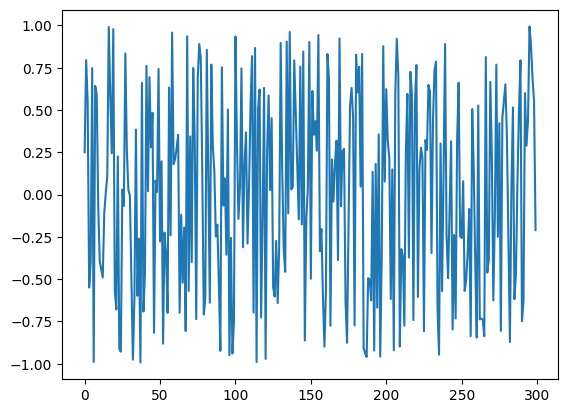

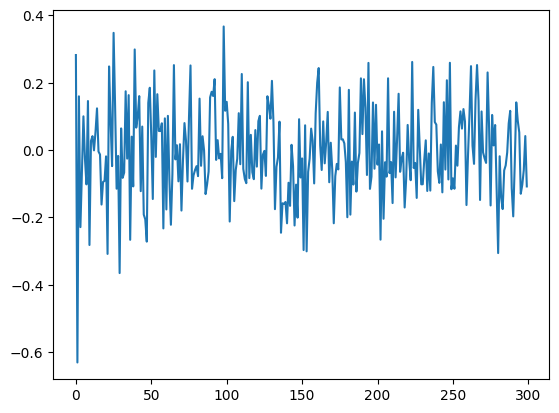

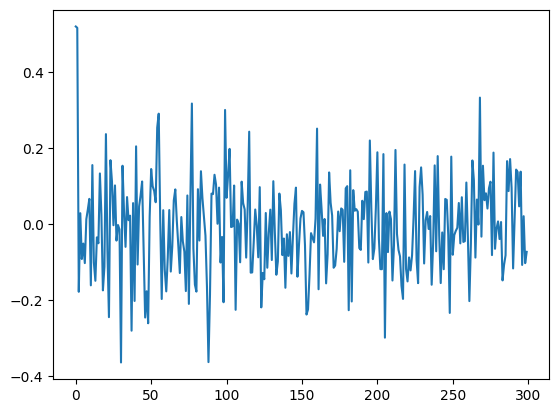

CMI: 6.640561385086279e-05
Highest CMI score: 6.640561385086279e-05
Adding original feature: 0
Highest CMI score: 0.0
[0]
CMI: 6.640561385086279e-05
Highest CMI score: 6.640561385086279e-05
Adding original feature: 0
Highest CMI score: 0.0
[0]
CMI: 0.007585970161962106
Highest CMI score: 0.007585970161962106
Adding original feature: 0
Highest CMI score: 0.0
[0]



Only x0_t-2: 0.45638372158479

Only x1_t-1: -0.007998524089715575

Only y_t-2: -0.034688139797175

Only x0: 0.45738879956471146

Only x1: -0.009656048302836728

Only y: -0.0347814178010033

x0 and y: 0.4525808974670791



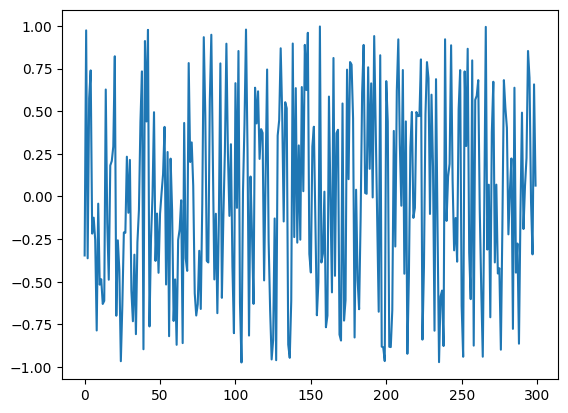

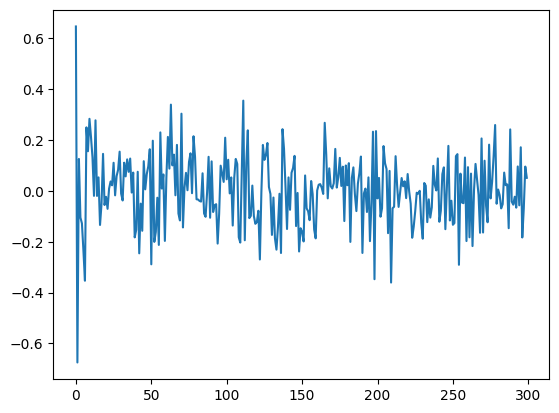

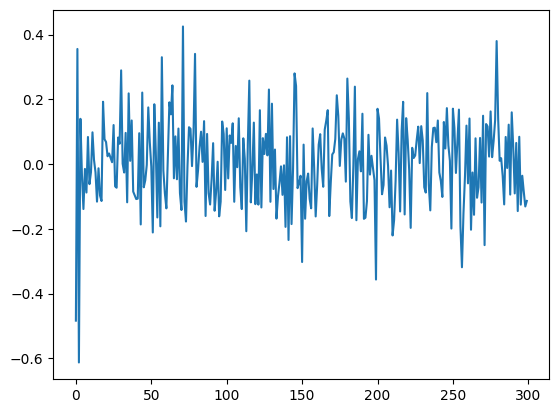

CMI: 6.645422703816808e-05
Highest CMI score: 6.645422703816808e-05
Adding original feature: 0
Highest CMI score: 0.0
[0]
CMI: 6.645422703816808e-05
CMI: 0.004725691139790324
Highest CMI score: 0.004725691139790324
Adding original feature: 2
CMI: 0.004725446260344986
Highest CMI score: 0.004725446260344986
Adding original feature: 1
Highest CMI score: -0.009384683173097142
[2, 1]
CMI: 0.004725446260344986
Highest CMI score: 0.004725446260344986
Adding original feature: 1
Highest CMI score: 0.0
[1]



Only x0_t-2: 0.4254941023457738

Only x1_t-1: 0.021625251006719082

Only y_t-2: -0.03461872999602922

Only x0: 0.42073269139717695

Only x1: 0.022960604633640247

Only y: -0.03433667230262927

x0 and y: 0.42623897253363086



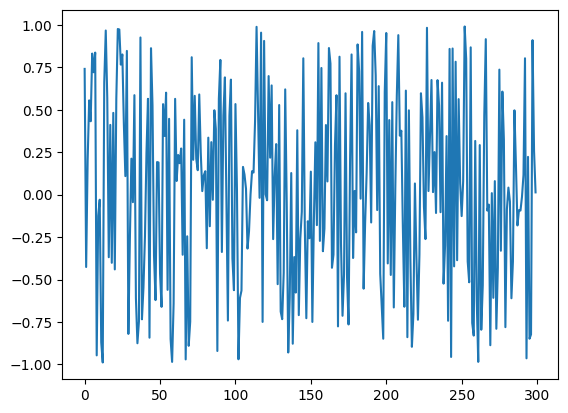

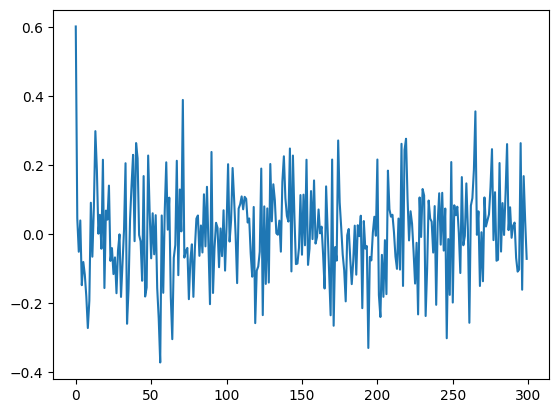

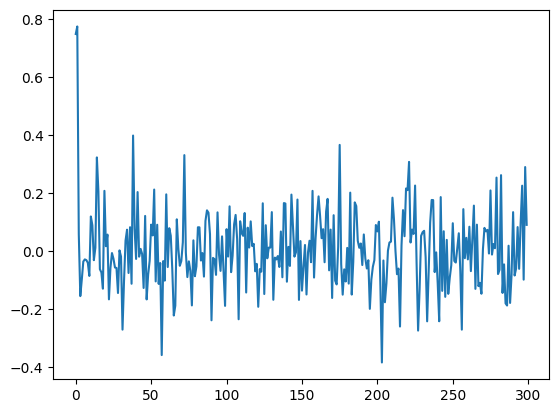

CMI: 0.00014637574071487986
Highest CMI score: 0.00014637574071487986
Adding original feature: 0
Highest CMI score: 0.0
[0]
CMI: 0.00014637574071487986
CMI: 0.008926486478075315
Highest CMI score: 0.008926486478075315
Adding original feature: 2
Highest CMI score: -0.008780110737360436
[2]
Highest CMI score: 0.0
[]



Only x0_t-2: 0.35766136336664067

Only x1_t-1: -0.009025071698193443

Only y_t-2: 0.007488776000693864

Only x0: 0.3612855928827422

Only x1: -0.0022366666493025544

Only y: 0.007557521797760813

x0 and y: 0.3922733348959436



In [18]:
for seed in range(10):#[6]:   
    rng = np.random.default_rng(seed=seed)
    random.seed(seed)
    np.random.seed(seed)
    
    x0 = rng.uniform(-1,1,size=300)
    plt.plot(x0)
    plt.show()
    
    y = list(rng.uniform(-1,1,size=2))
    c = [0.1, -0.15]#[rng.uniform(-1,1),rng.uniform(-1,1)]
    for i in range(300 - 2):
        next_val = y[-2]*c[0] + x0[i]*c[1] + np.random.randn() * 0.1
        y.append(next_val)
    plt.plot(y)
    plt.show()
    
    x1 = list(rng.uniform(-1,1,size=2))
    d = 0.55 #rng.uniform(-1,1)
    for i in range(300 - 2):
        next_val = y[i+1]*d + np.random.randn() * 0.1
        x1.append(next_val)
    plt.plot(x1)
    plt.show()
    
    x = np.concatenate((np.array(x0).reshape(-1,1),np.array(x1).reshape(-1,1)),axis=1)
    x0 = x0[20:]
    x1 = x1[20:]
    y = np.array(y)
    x = x[20:]
    y = y[20:]
    
    res = {
            "delta" : [], # list with all deltas
            "numSelected" : [], #
            "selectedFeatures" : [] 
        #    "accuracy" : [] # list of scores associated with the reduced problem
        }
    
    sel = forwardFeatureSelection(threshold=100,features=x,target=y,res=res,k=20, nproc=1, tau=5)
    print(sel)
    
    res = {
            "delta" : [], # list with all deltas
            "numSelected" : [], #
            "selectedFeatures" : [] 
        #    "accuracy" : [] # list of scores associated with the reduced problem
        }
    
    sel = forwardFeatureSelection(threshold=100,features=np.concatenate((x,y.reshape(-1,1)),axis=1),target=y,res=res,k=20, nproc=1, tau=5)
    print(sel)
    
    res = {
            "delta" : [], # list with all deltas
            "numSelected" : [], #
            "selectedFeatures" : [] 
        #    "accuracy" : [] # list of scores associated with the reduced problem
        }
    
    sel = TE_forwardFeatureSelection(threshold=100,features=np.concatenate((x,y.reshape(-1,1)),axis=1),target=y,res=res,k=20, nproc=1, tau=5)
    print(sel)
    print('\n\n')
    # confronto R2 fra x1, x0, y_past + x0
    
    x0 = np.array(x0)
    x1 = np.array(x1)
    y = np.array(y)
    reg_x0 = LinearRegression().fit(x0[:198].reshape(-1,1), y[2:200].reshape(-1,1))
    print(f'Only x0_t-2: {reg_x0.score(x0[200:-2].reshape(-1,1), y[202:].reshape(-1,1))}\n')
    
    reg_x1 = LinearRegression().fit(x1[:199].reshape(-1,1), y[1:200].reshape(-1,1))
    print(f'Only x1_t-1: {reg_x1.score(x1[200:-1].reshape(-1,1), y[201:].reshape(-1,1))}\n')
    
    reg_y = LinearRegression().fit(y[:198].reshape(-1,1), y[2:200].reshape(-1,1))
    print(f'Only y_t-2: {reg_y.score(y[200:-2].reshape(-1,1), y[202:].reshape(-1,1))}\n')

    x0_past2 = concatenate_past(x0,2)
    x1_past2 = concatenate_past(x1,2)
    y_past2 = concatenate_past(y,2)
    y_target2 = y[2:]
    
    reg_x0 = LinearRegression().fit(x0_past2[:200], y_target2[:200].reshape(-1,1))
    print(f'Only x0: {reg_x0.score(x0_past2[200:], y_target2[200:].reshape(-1,1))}\n')
    
    reg_x1 = LinearRegression().fit(x1_past2[:200], y_target2[:200].reshape(-1,1))
    print(f'Only x1: {reg_x1.score(x1_past2[200:], y_target2[200:].reshape(-1,1))}\n')
    
    reg_y = LinearRegression().fit(y_past2[:200], y_target2[:200].reshape(-1,1))
    print(f'Only y: {reg_y.score(y_past2[200:], y_target2[200:].reshape(-1,1))}\n')
    
    x0_y_past2 = np.concatenate((x0_past2,y_past2), axis=1)
    
    reg_x0_y = LinearRegression().fit(x0_y_past2[:200], y_target2[:200].reshape(-1,1))
    print(f'x0 and y: {reg_x0_y.score(x0_y_past2[200:], y_target2[200:].reshape(-1,1))}\n')


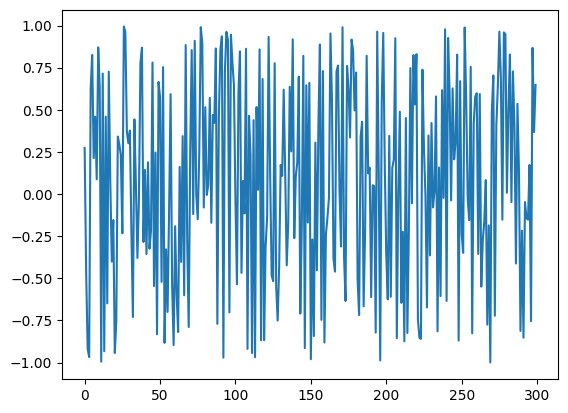

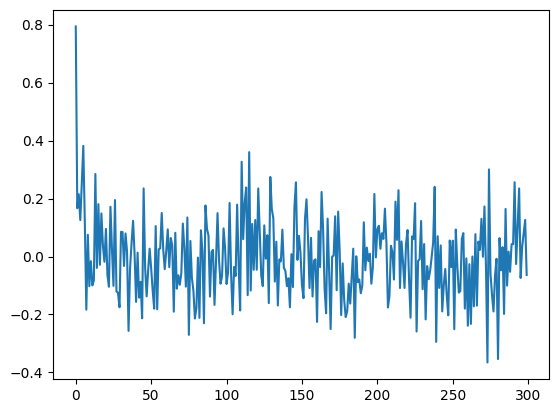

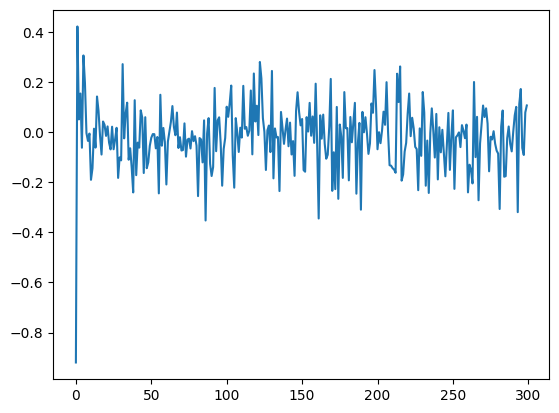

Only x0_t-2: 0.4644734854301753

Only x1_t-1: -0.007881515129633643

Only y_t-2: 0.018729818931188413

Only x0: 0.45867811787769475

Only x1: -0.008146069367378272

Only y: 0.01928236194850863

x0 and y: 0.45487499474970805



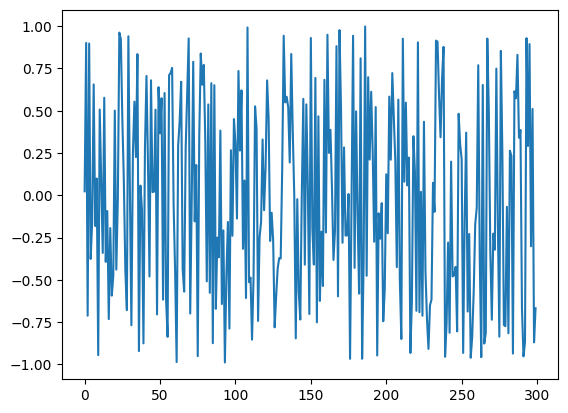

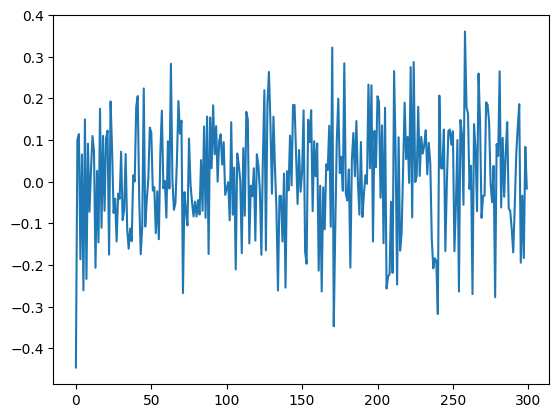

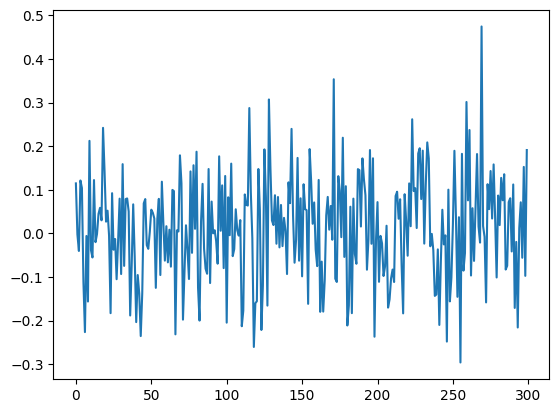

Only x0_t-2: 0.5032339862849494

Only x1_t-1: 0.0012938501046424467

Only y_t-2: 0.026151160626709635

Only x0: 0.49947789428363754

Only x1: 0.002543121895978384

Only y: 0.009891856358309692

x0 and y: 0.5273691268958346



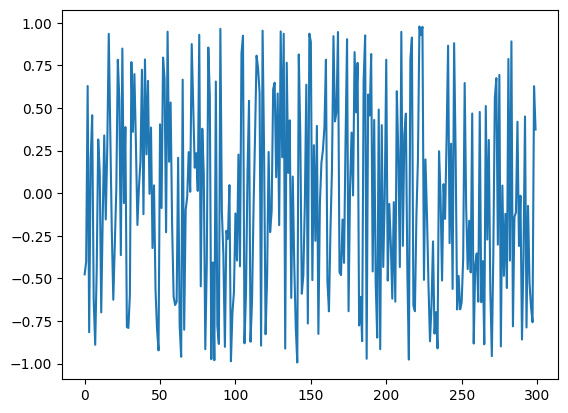

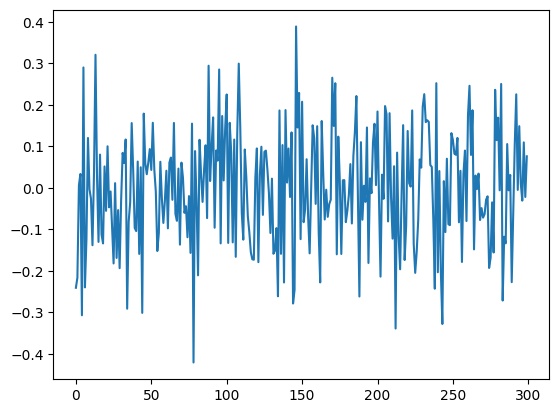

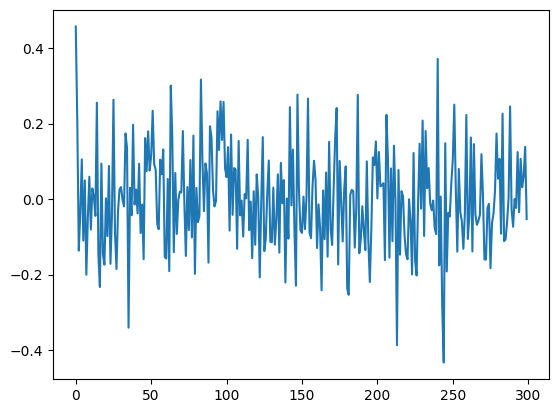

Only x0_t-2: 0.47218238404649027

Only x1_t-1: 0.0011677219073076284

Only y_t-2: 0.02016192754685464

Only x0: 0.4716312001700935

Only x1: 0.031763576453285536

Only y: -0.016657723612107267

x0 and y: 0.4556876351560434



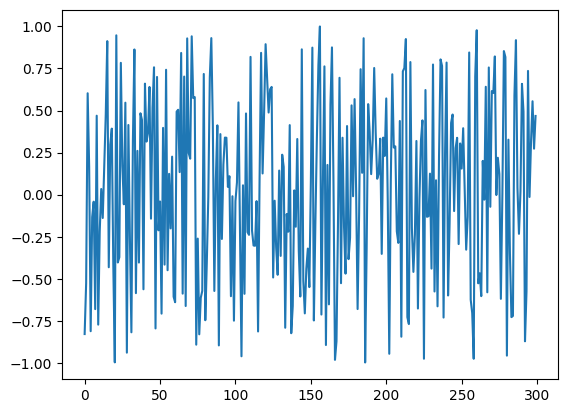

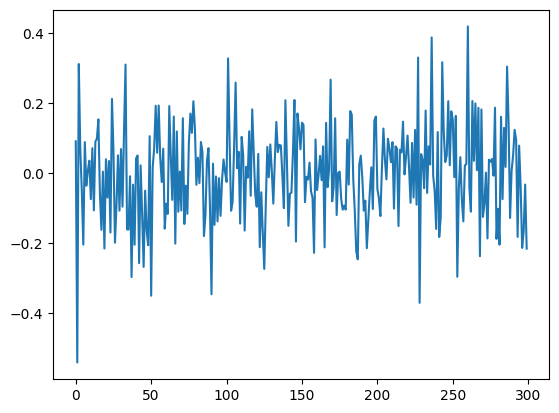

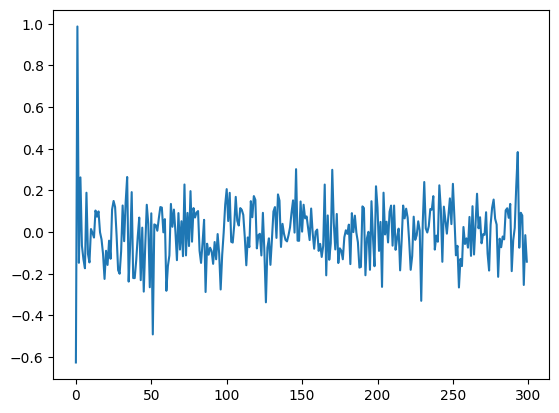

Only x0_t-2: 0.34062093828642115

Only x1_t-1: -0.033171290574850465

Only y_t-2: -0.023707854274945594

Only x0: 0.3101899689963803

Only x1: -0.02586304915782578

Only y: -0.022977813740894693

x0 and y: 0.3614286615719393



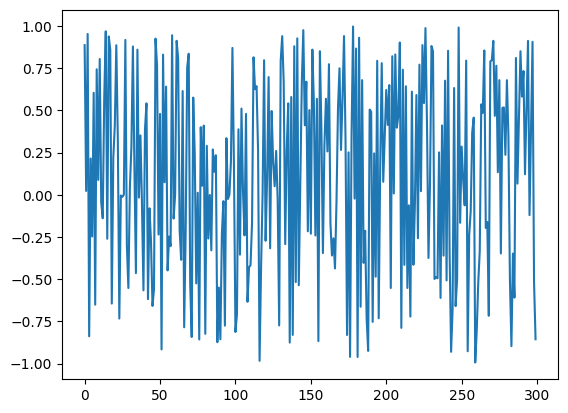

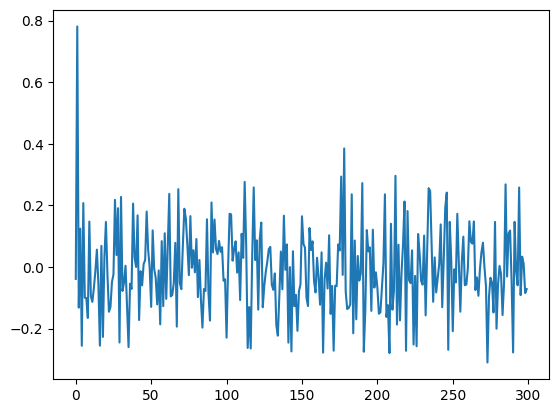

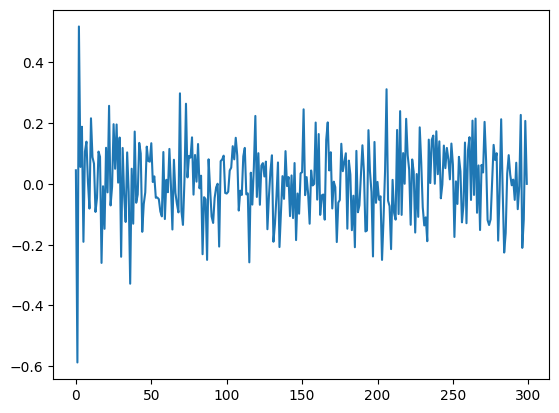

Only x0_t-2: 0.4103504158465737

Only x1_t-1: -0.03761413666941871

Only y_t-2: -0.030972682785783023

Only x0: 0.41118180156912887

Only x1: 0.0008157147666160158

Only y: -0.014021578720721406

x0 and y: 0.379783448757698



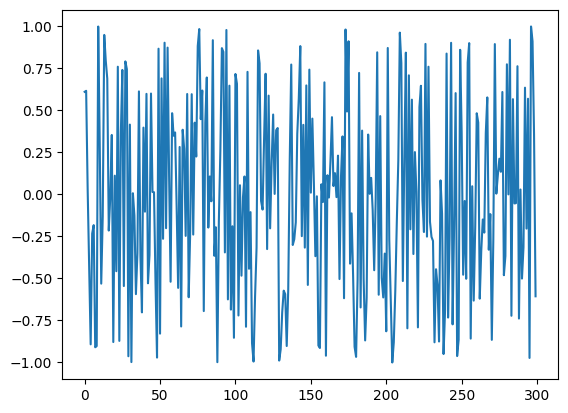

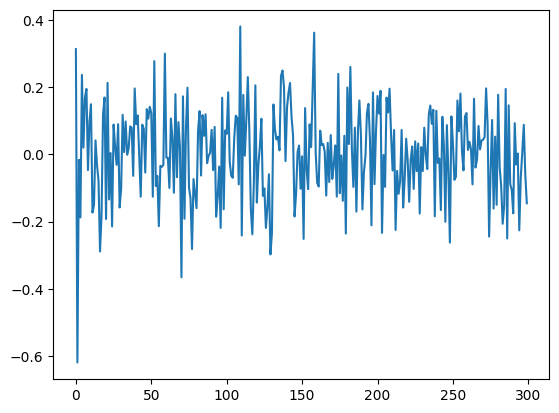

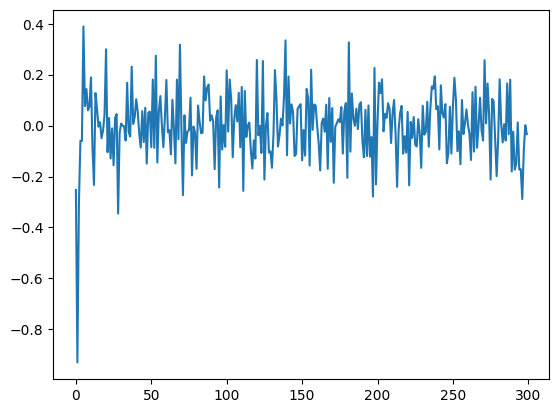

Only x0_t-2: 0.33275317903791235

Only x1_t-1: -0.004204743575136449

Only y_t-2: -0.014882962450571968

Only x0: 0.3227852732199461

Only x1: -0.006245447212303468

Only y: -0.015463492731824235

x0 and y: 0.35050433308573603



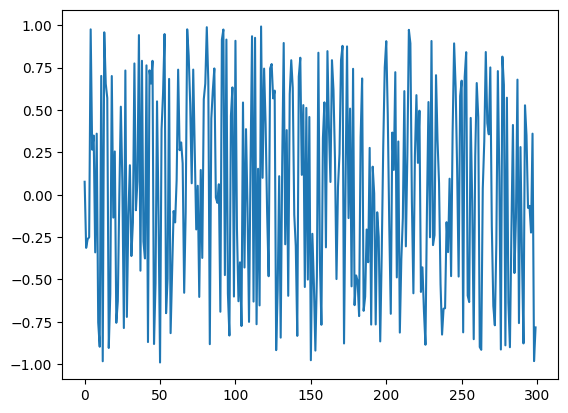

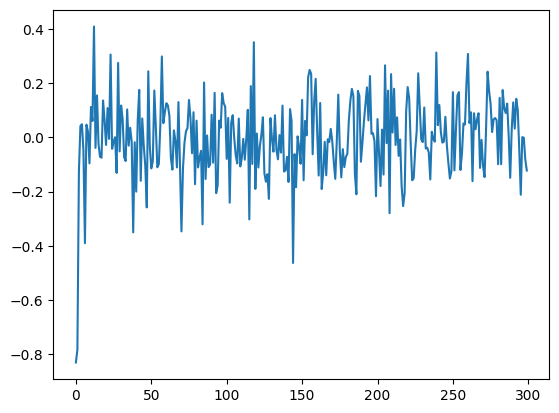

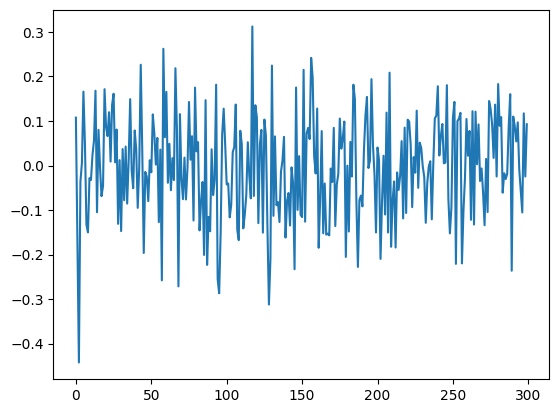

Only x0_t-2: 0.3484103920616991

Only x1_t-1: -0.0439656530707917

Only y_t-2: -0.019124769471995595

Only x0: 0.35210396737972016

Only x1: -0.037981404513866446

Only y: -0.024821386535944345

x0 and y: 0.3784398679746329



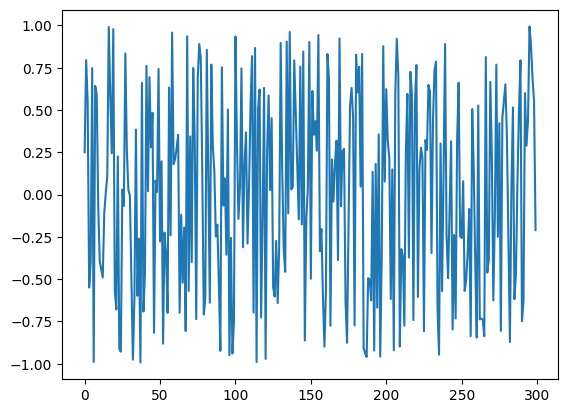

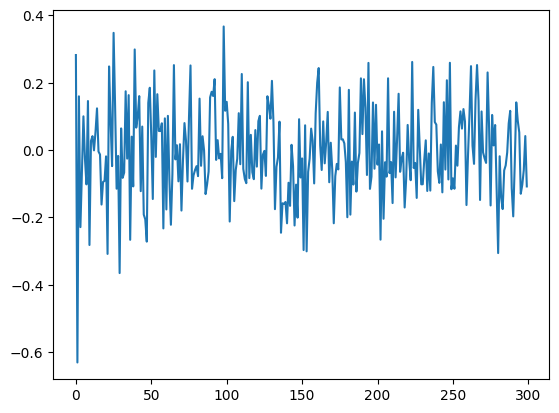

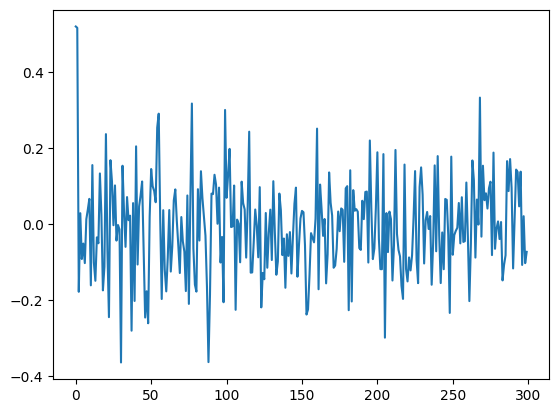

Only x0_t-2: 0.46696081544960133

Only x1_t-1: -0.0053408750705177255

Only y_t-2: -0.018268432154278313

Only x0: 0.46043003833631935

Only x1: 0.00067645918075665

Only y: -0.01875345375385762

x0 and y: 0.4656913822914772



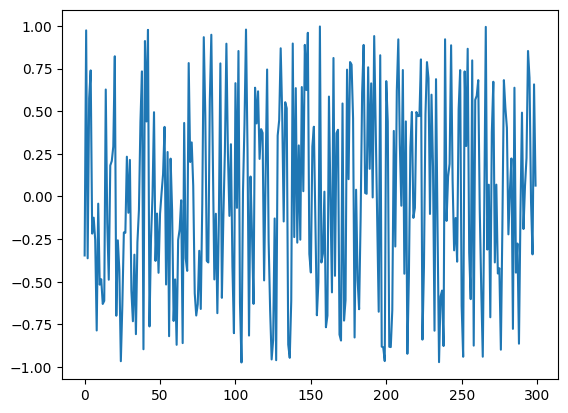

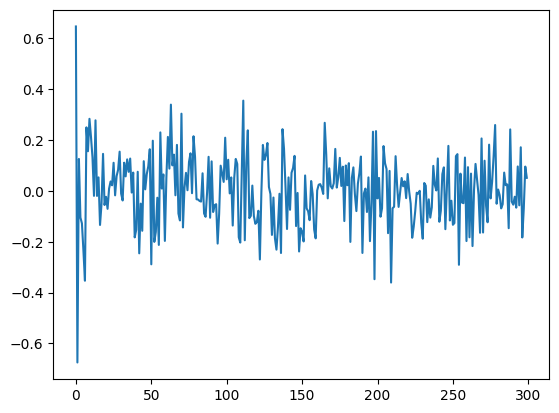

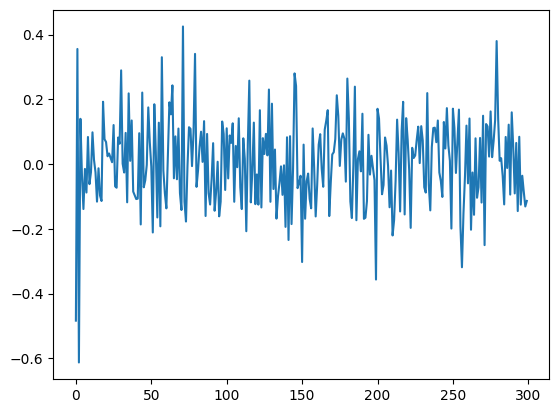

Only x0_t-2: 0.40966860846584796

Only x1_t-1: 0.023299813912205147

Only y_t-2: -0.033829842237777186

Only x0: 0.4100251962350667

Only x1: 0.014177189766558573

Only y: -0.0470653874435929

x0 and y: 0.41209403073648854



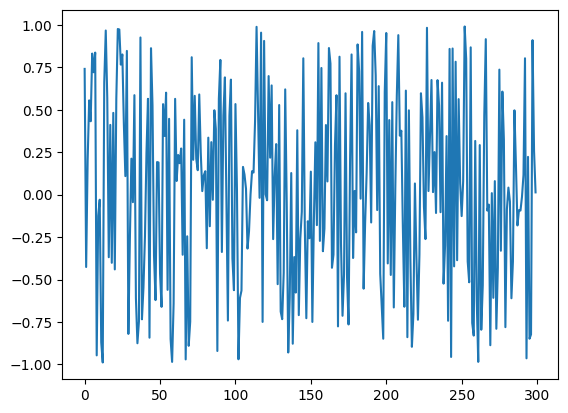

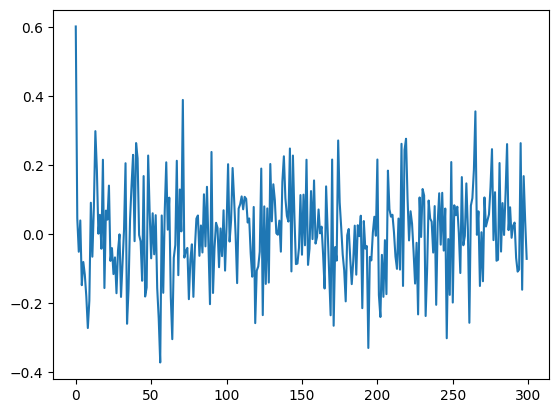

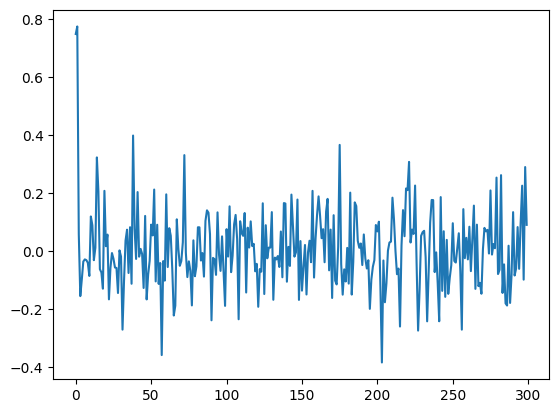

Only x0_t-2: 0.3891132953334554

Only x1_t-1: -0.008064741672767939

Only y_t-2: 0.01104056836135614

Only x0: 0.39064790560825635

Only x1: -0.006497316033626133

Only y: 0.009891157061131861

x0 and y: 0.42838181554066423



In [85]:
r2_x1 = []
r2_x0_y = []

for seed in range(10):   
    rng = np.random.default_rng(seed=seed)
    random.seed(seed)
    np.random.seed(seed)
    
    x0 = rng.uniform(-1,1,size=300)
    plt.plot(x0)
    plt.show()
    
    y = list(rng.uniform(-1,1,size=2))
    c = [0.1, -0.15]#[rng.uniform(-1,1),rng.uniform(-1,1)]
    for i in range(300 - 2):
        next_val = y[-2]*c[0] + x0[i]*c[1] + np.random.randn() * 0.1
        y.append(next_val)
    plt.plot(y)
    plt.show()
    
    x1 = list(rng.uniform(-1,1,size=2))
    d = 0.55 #rng.uniform(-1,1)
    for i in range(300 - 2):
        next_val = y[i+1]*d + np.random.randn() * 0.1
        x1.append(next_val)
    plt.plot(x1)
    plt.show()
    
    x = np.concatenate((np.array(x0).reshape(-1,1),np.array(x1).reshape(-1,1)),axis=1)
    y = np.array(y)

    x0 = np.array(x0)
    x1 = np.array(x1)
    y = np.array(y)
    reg_x0 = LinearRegression().fit(x0[:198].reshape(-1,1), y[2:200].reshape(-1,1))
    print(f'Only x0_t-2: {reg_x0.score(x0[200:-2].reshape(-1,1), y[202:].reshape(-1,1))}\n')
    
    reg_x1 = LinearRegression().fit(x1[:199].reshape(-1,1), y[1:200].reshape(-1,1))
    print(f'Only x1_t-1: {reg_x1.score(x1[200:-1].reshape(-1,1), y[201:].reshape(-1,1))}\n')
    
    reg_y = LinearRegression().fit(y[:198].reshape(-1,1), y[2:200].reshape(-1,1))
    print(f'Only y_t-2: {reg_y.score(y[200:-2].reshape(-1,1), y[202:].reshape(-1,1))}\n')

    x0_past2 = concatenate_past(x0,2)
    x1_past2 = concatenate_past(x1,2)
    y_past2 = concatenate_past(y,2)
    y_target2 = y[2:]
    
    reg_x0 = LinearRegression().fit(x0_past2[:200], y_target2[:200].reshape(-1,1))
    print(f'Only x0: {reg_x0.score(x0_past2[200:], y_target2[200:].reshape(-1,1))}\n')
    
    reg_x1 = LinearRegression().fit(x1_past2[:200], y_target2[:200].reshape(-1,1))
    print(f'Only x1: {reg_x1.score(x1_past2[200:], y_target2[200:].reshape(-1,1))}\n')
    
    reg_y = LinearRegression().fit(y_past2[:200], y_target2[:200].reshape(-1,1))
    print(f'Only y: {reg_y.score(y_past2[200:], y_target2[200:].reshape(-1,1))}\n')
    
    x0_y_past2 = np.concatenate((x0_past2,y_past2), axis=1)
    
    reg_x0_y = LinearRegression().fit(x0_y_past2[:200], y_target2[:200].reshape(-1,1))
    print(f'x0 and y: {reg_x0_y.score(x0_y_past2[200:], y_target2[200:].reshape(-1,1))}\n')
    
    r2_x1.append(reg_x1.score(x1_past2[200:], y_target2[200:].reshape(-1,1)))
    r2_x0_y.append(reg_x0_y.score(x0_y_past2[200:], y_target2[200:].reshape(-1,1)))

In [86]:
evaluate_CI(r2_x1)

[-0.014829799695957572, 0.007878354851596584]

In [87]:
evaluate_CI(r2_x0_y)

[0.38873227892966455, 0.45411878042237985]

### repeat with backward

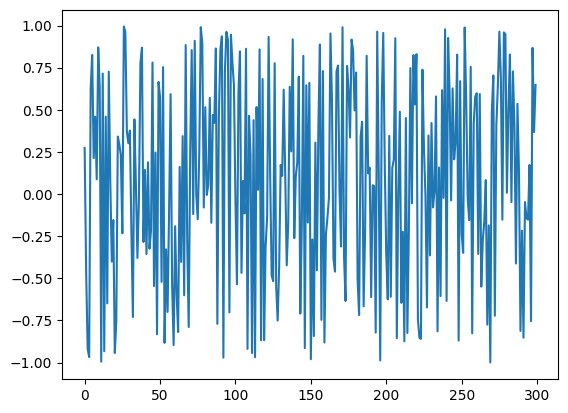

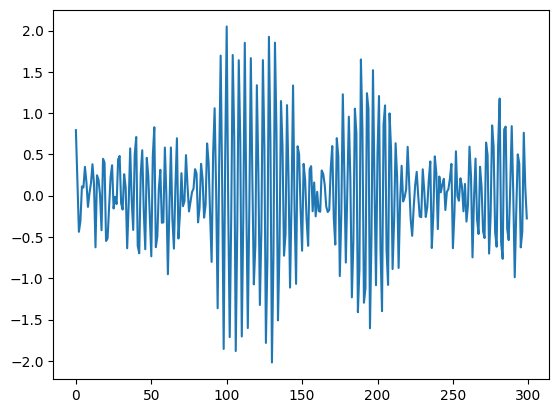

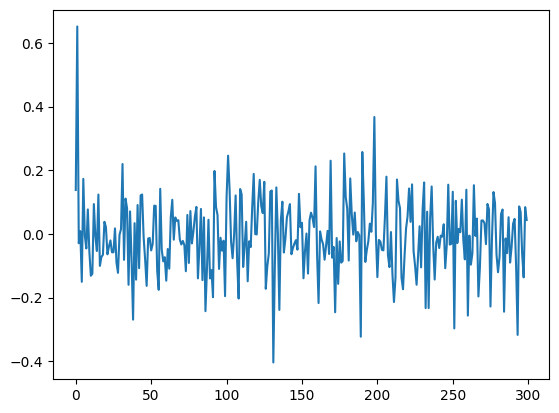

[(0, -0.005743433984368565), (1, 0.0)]
Removing original feature: 0
[1]
CMI: 0.250023173845596
[(0, -0.18794047734520591), (1, 0.0), (2, 0.250023173845596)]
Removing original feature: 0
CMI: 0.4322202172064334
[(0, -0.0008127161406974448), (1, 0.4322202172064334)]
Removing original feature: 1
[2]
[(0, -0.18794047734520591), (1, 0.0)]
Removing original feature: 0
[1]





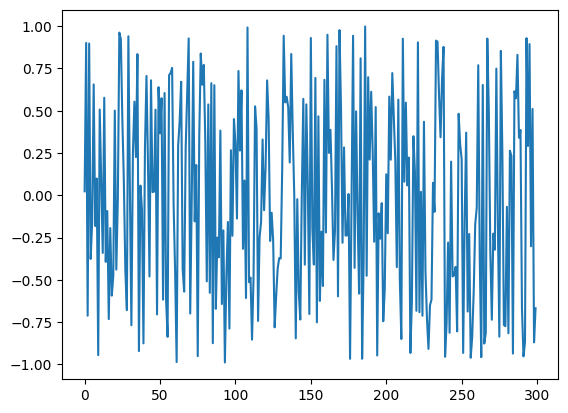

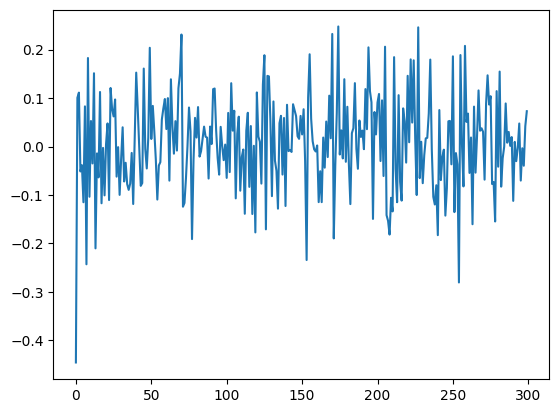

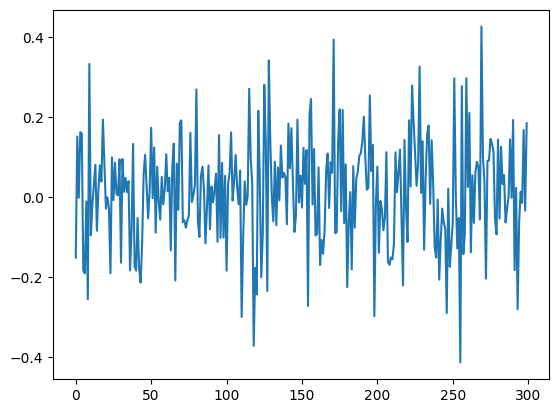

CMI: 0.00017841213202497664
[(0, -0.007791283067758707), (1, 0.00017841213202497664)]
Removing original feature: 0
[1]
CMI: 0.00017841213202497664
[(0, -0.024986251192425077), (2, 0.0), (1, 0.00017841213202497664)]
Removing original feature: 0
CMI: 0.017194968124666372
[(0, -0.002291530069641886), (1, 0.017194968124666372)]
Removing original feature: 1
[2]
CMI: 0.00017841213202497664
[(0, -0.024986251192425077), (1, 0.00017841213202497664)]
Removing original feature: 0
[1]





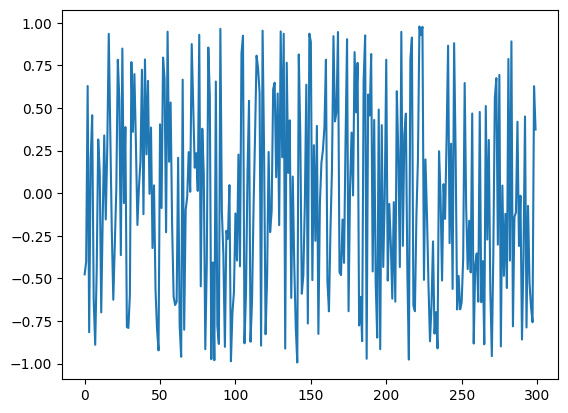

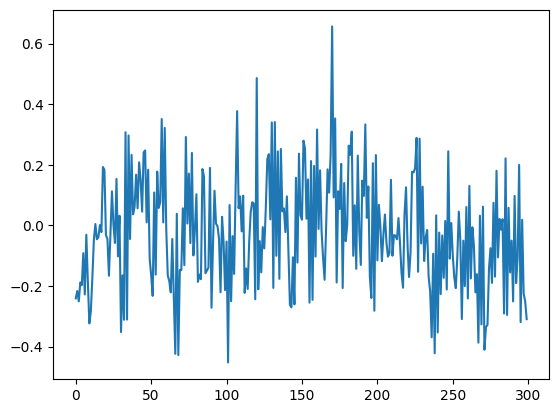

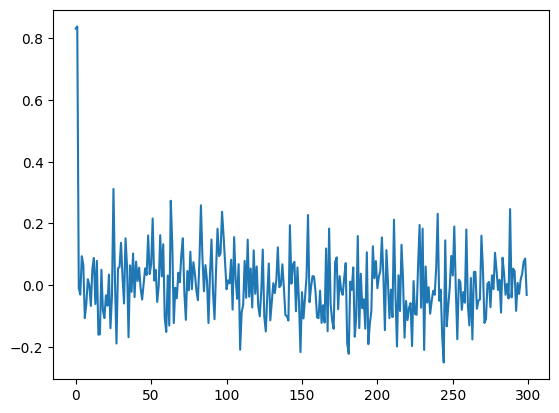

CMI: 0.004425383373519032
[(1, -4.643739595390668e-05), (0, 0.004425383373519032)]
Removing original feature: 1
[0]
[(0, -0.04440874352708106), (2, -0.0002810796810371373), (1, -4.672910729668165e-05)]
Removing original feature: 0
CMI: 0.04855304721956296
[(0, -0.015415854031247567), (1, 0.04855304721956296)]
Removing original feature: 1
[2]
[(0, -0.04440874352708106), (1, -4.672910729668165e-05)]
Removing original feature: 0
[1]





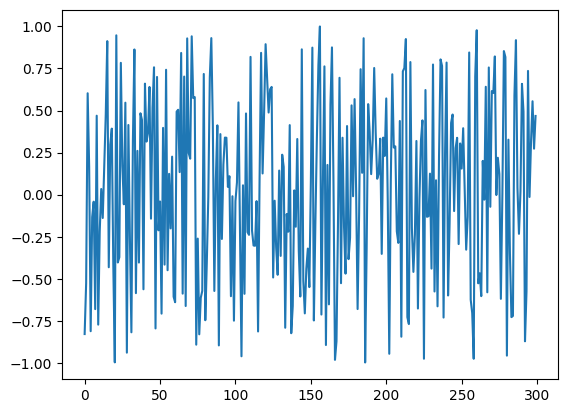

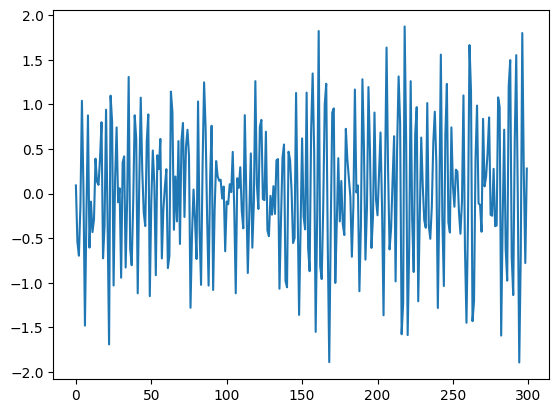

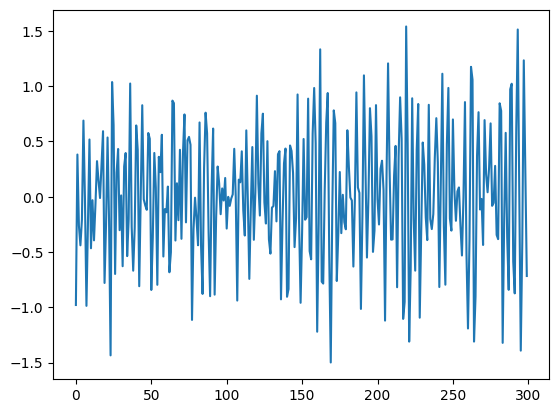

CMI: 0.16189969285405742
[(1, -0.022023728675622245), (0, 0.16189969285405742)]
Removing original feature: 1
[0]
CMI: 0.1159288267951809
[(2, -0.04555919662696156), (1, -0.022089521522456024), (0, 0.1159288267951809)]
Removing original feature: 2
CMI: 0.16189969285405742
[(1, -0.022023728675622245), (0, 0.16189969285405742)]
Removing original feature: 1
[0]
CMI: 0.1159288267951809
[(1, -0.022089521522456024), (0, 0.1159288267951809)]
Removing original feature: 1
[0]





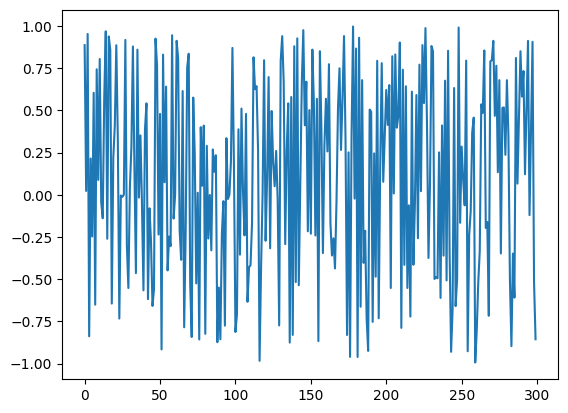

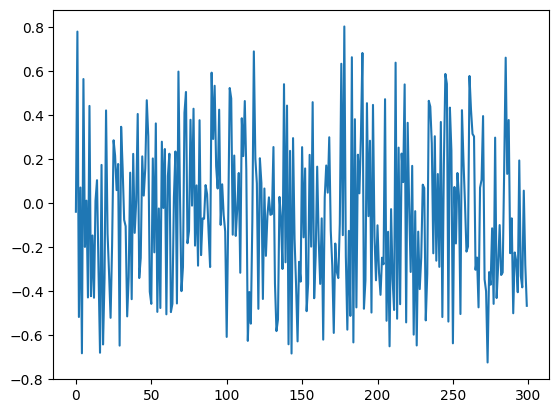

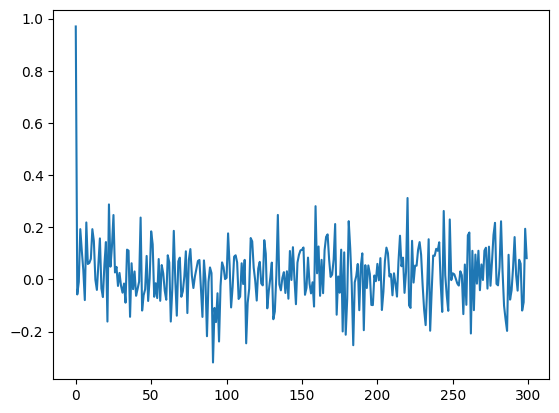

CMI: 0.19127507432547958
[(1, -0.0016106265107388162), (0, 0.19127507432547958)]
Removing original feature: 1
[0]
CMI: 0.12763406874579442
[(2, -0.049214737917192386), (1, -0.0008090716487821059), (0, 0.12763406874579442)]
Removing original feature: 2
CMI: 0.19127507432547958
[(1, -0.0016106265107388162), (0, 0.19127507432547958)]
Removing original feature: 1
[0]
CMI: 0.12763406874579442
[(1, -0.0008090716487821059), (0, 0.12763406874579442)]
Removing original feature: 1
[0]





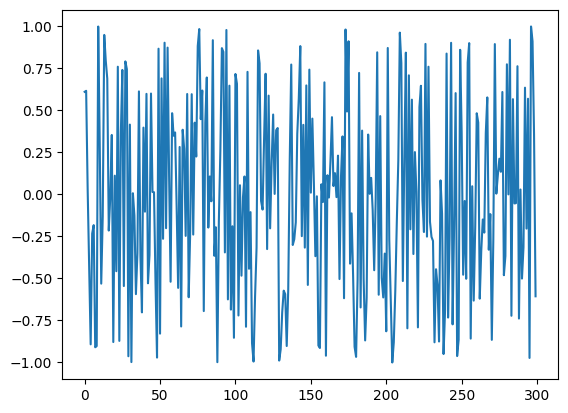

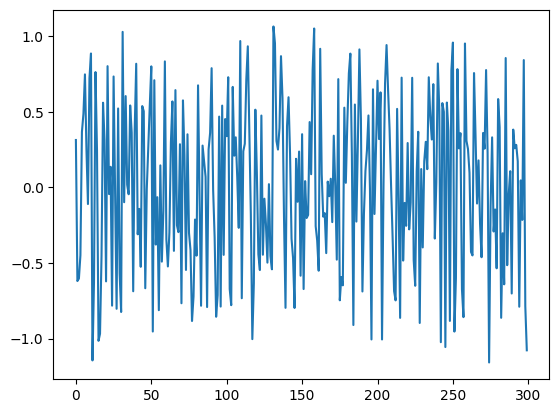

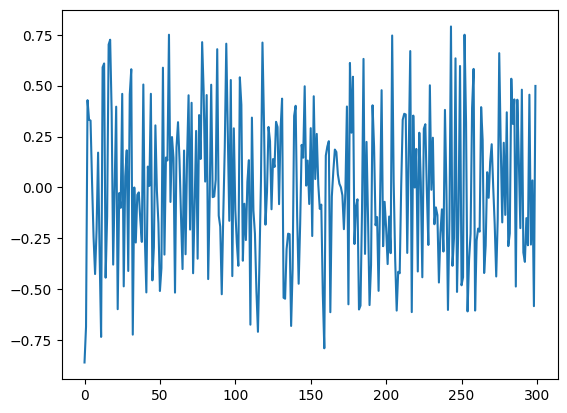

CMI: 0.35641684549792446
[(1, -0.07203008511376602), (0, 0.35641684549792446)]
Removing original feature: 1
[0]
CMI: 0.27617282206978383
[(2, -0.07613087059671758), (1, -0.012434293698884935), (0, 0.27617282206978383)]
Removing original feature: 2
CMI: 0.35641684549792446
[(1, -0.07203008511376602), (0, 0.35641684549792446)]
Removing original feature: 1
[0]
CMI: 0.27617282206978383
[(1, -0.012434293698884935), (0, 0.27617282206978383)]
Removing original feature: 1
[0]





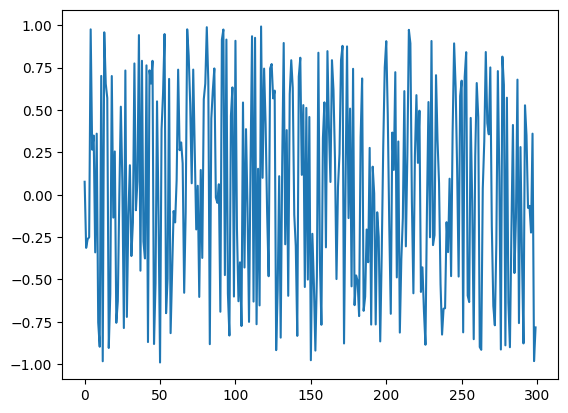

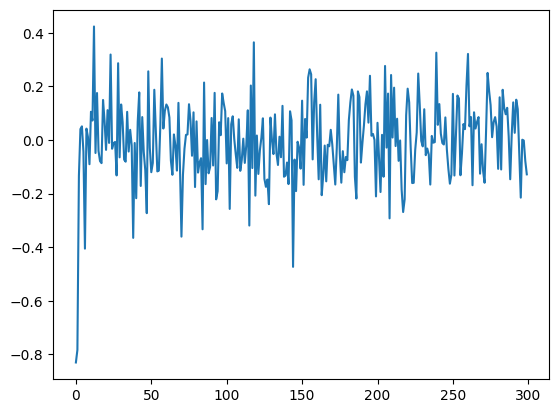

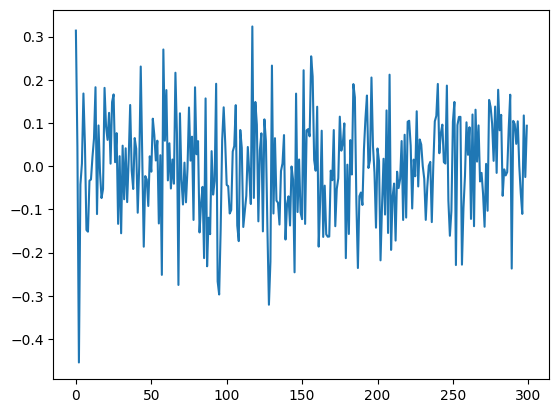

[(0, -0.0026922294132865707), (1, -7.225481959070293e-05)]
Removing original feature: 0
[1]
CMI: 0.00504339180995036
[(2, -0.00010557408344044096), (1, 0.0), (0, 0.00504339180995036)]
Removing original feature: 2
[(0, -0.0026922294132865707), (1, -7.225481959070293e-05)]
Removing original feature: 0
[1]
CMI: 0.00504339180995036
[(1, 0.0), (0, 0.00504339180995036)]
Removing original feature: 1
[0]





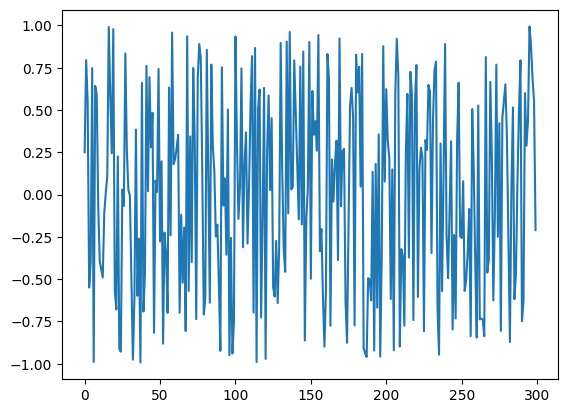

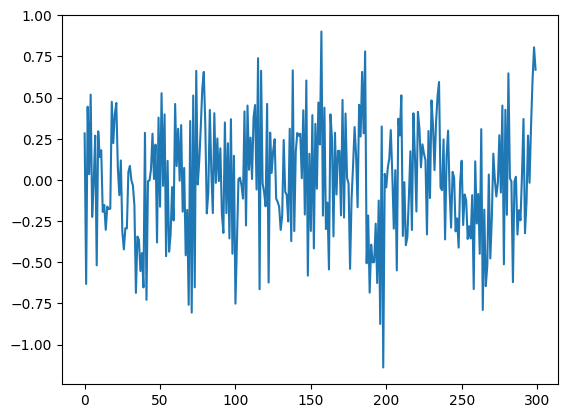

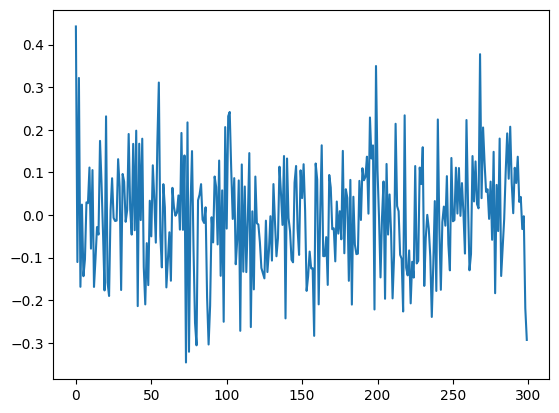

CMI: 0.1031429208176709
[(1, -5.1495054873673674e-05), (0, 0.1031429208176709)]
Removing original feature: 1
[0]
CMI: 0.05852007688582815
[(2, -0.022942037201427956), (1, -1.2462612163505193e-05), (0, 0.05852007688582815)]
Removing original feature: 2
CMI: 0.1031429208176709
[(1, -5.1495054873673674e-05), (0, 0.1031429208176709)]
Removing original feature: 1
[0]
CMI: 0.05852007688582815
[(1, -1.2462612163505193e-05), (0, 0.05852007688582815)]
Removing original feature: 1
[0]





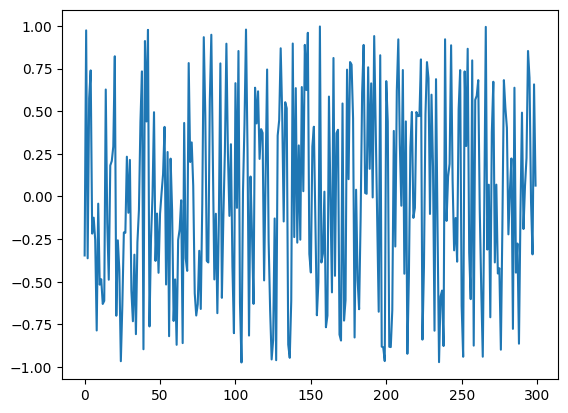

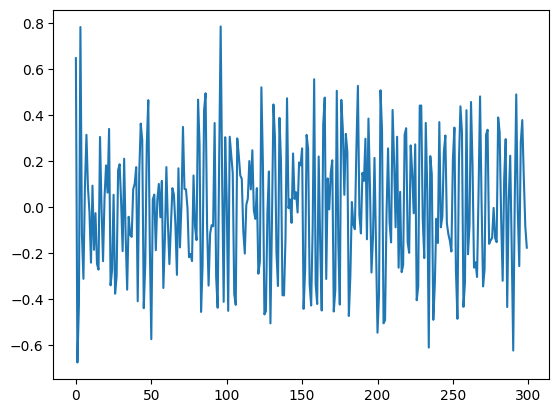

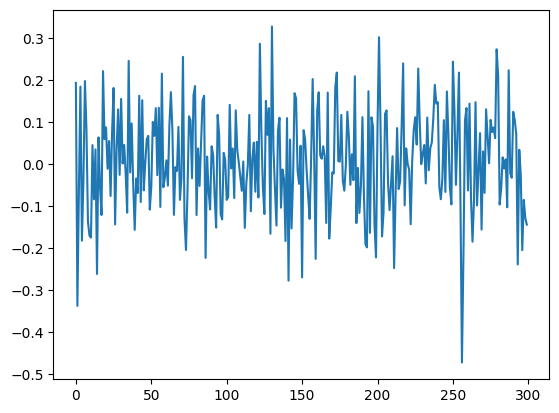

CMI: 0.03591632380842125
[(1, 0.0), (0, 0.03591632380842125)]
Removing original feature: 1
[0]
[(0, -0.04708848552550118), (2, -0.0062542697322693006), (1, 0.0)]
Removing original feature: 0
CMI: 0.0065461340245766275
CMI: 0.07675053960165312
[(0, 0.0065461340245766275), (1, 0.07675053960165312)]
Removing original feature: 1
[2]
[(0, -0.04708848552550118), (1, 0.0)]
Removing original feature: 0
[1]





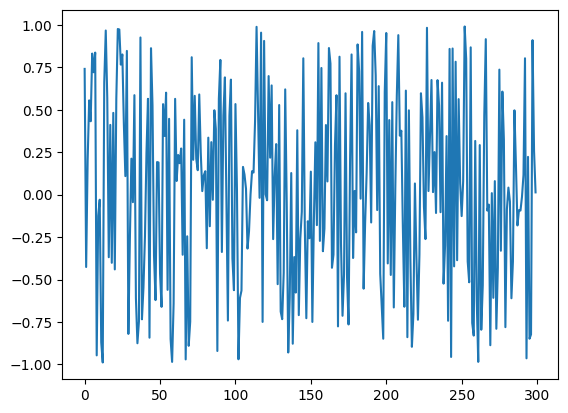

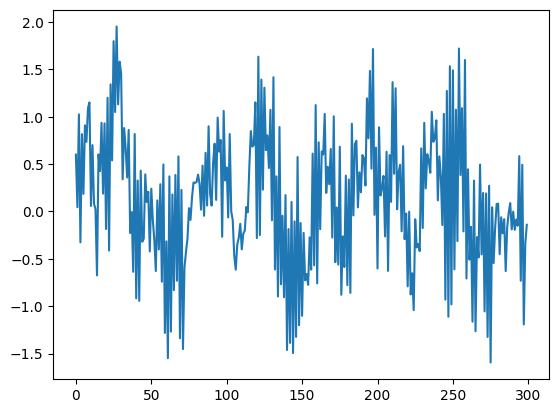

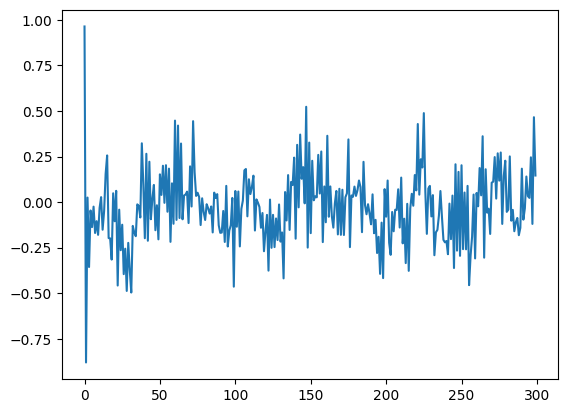

CMI: 0.09916191320869036
CMI: 0.002007061327469417
[(1, 0.002007061327469417), (0, 0.09916191320869036)]
Removing original feature: 1
[0]
CMI: 0.0443446209791038
CMI: 0.07124055288558429
[(1, -0.00020089855232463538), (0, 0.0443446209791038), (2, 0.07124055288558429)]
Removing original feature: 1
CMI: 0.04169527850779753
CMI: 0.07344851276537834
[(0, 0.04169527850779753), (1, 0.07344851276537834)]
Removing original feature: 0
[2]
CMI: 0.0443446209791038
[(1, -0.00020089855232463538), (0, 0.0443446209791038)]
Removing original feature: 1
[0]





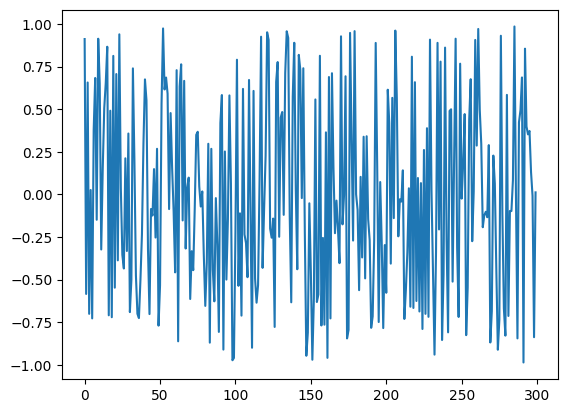

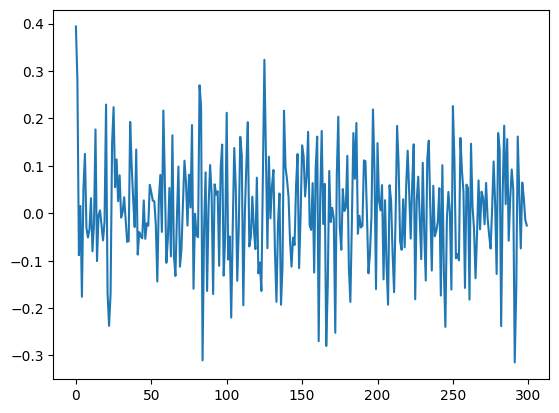

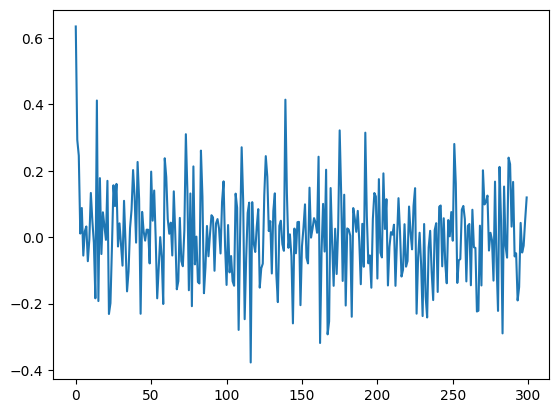

[(0, -0.023866730234719996), (1, 0.0)]
Removing original feature: 0
[1]
[(0, -0.026080273449852743), (1, 0.0), (2, 0.0)]
Removing original feature: 0
CMI: 0.002213543215132747
[(0, -0.020259727832332656), (1, 0.002213543215132747)]
Removing original feature: 1
[2]
[(0, -0.026080273449852743), (1, 0.0)]
Removing original feature: 0
[1]





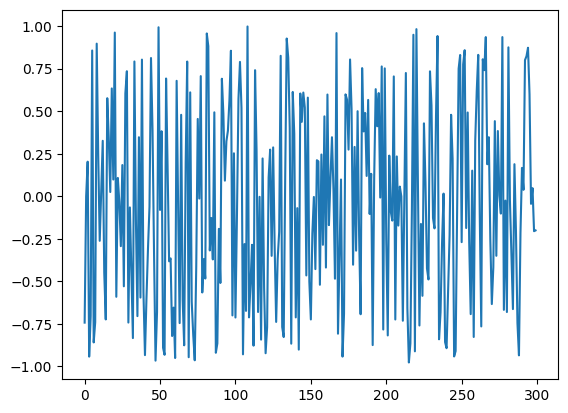

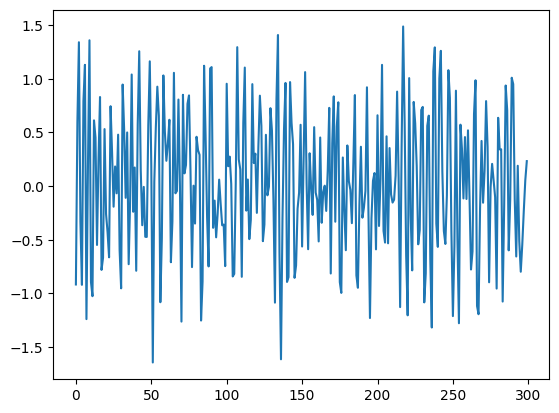

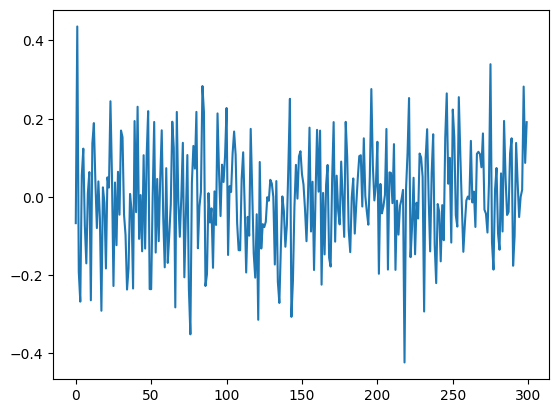

CMI: 0.4188533578257237
[(1, 0.0), (0, 0.4188533578257237)]
Removing original feature: 1
[0]
CMI: 0.20005538612955676
[(2, -0.14990538277959842), (1, 0.0), (0, 0.20005538612955676)]
Removing original feature: 2
CMI: 0.4188533578257237
[(1, 0.0), (0, 0.4188533578257237)]
Removing original feature: 1
[0]
CMI: 0.20005538612955676
[(1, 0.0), (0, 0.20005538612955676)]
Removing original feature: 1
[0]





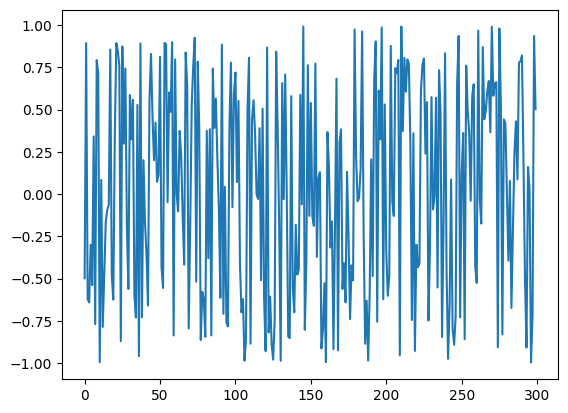

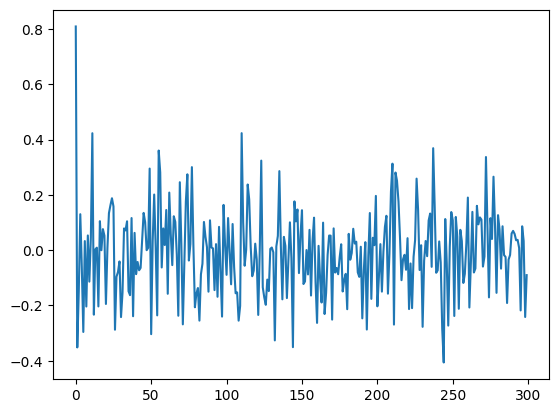

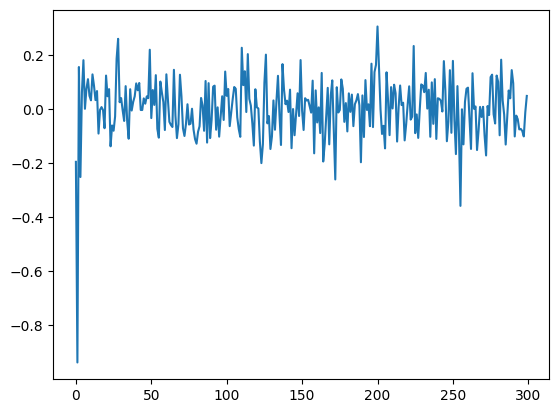

[(0, -0.0025483329188373737), (1, 0.0)]
Removing original feature: 0
[1]
CMI: 0.006739376597170909
[(1, 0.0), (2, 0.0), (0, 0.006739376597170909)]
Removing original feature: 1
CMI: 0.0004538897166210939
[(1, 0.0), (0, 0.0004538897166210939)]
Removing original feature: 2
[0]
CMI: 0.006739376597170909
[(1, 0.0), (0, 0.006739376597170909)]
Removing original feature: 1
[0]





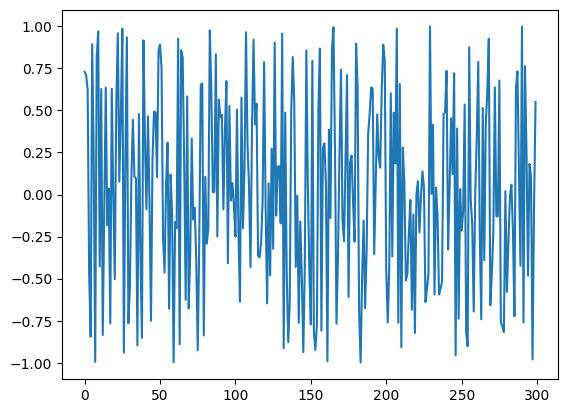

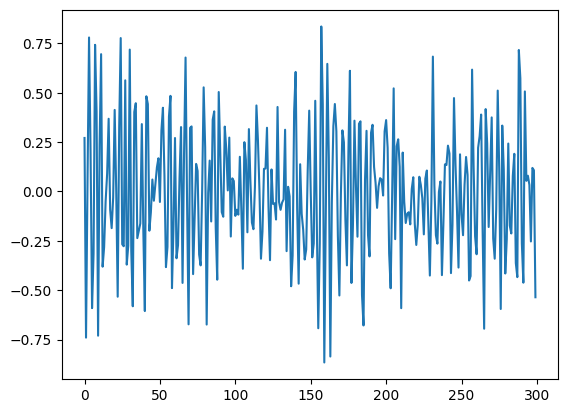

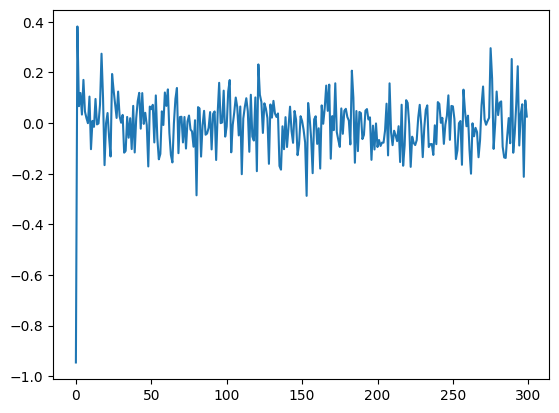

CMI: 0.0785818959961932
[(1, -0.0006606762322431681), (0, 0.0785818959961932)]
Removing original feature: 1
[0]
[(0, -0.041836123318683), (2, -0.020683193386236476), (1, -0.00019734770155943604)]
Removing original feature: 0
CMI: 0.09973482592863972
[(0, -0.004506023674769349), (1, 0.09973482592863972)]
Removing original feature: 1
[2]
[(0, -0.041836123318683), (1, -0.00019734770155943604)]
Removing original feature: 0
[1]





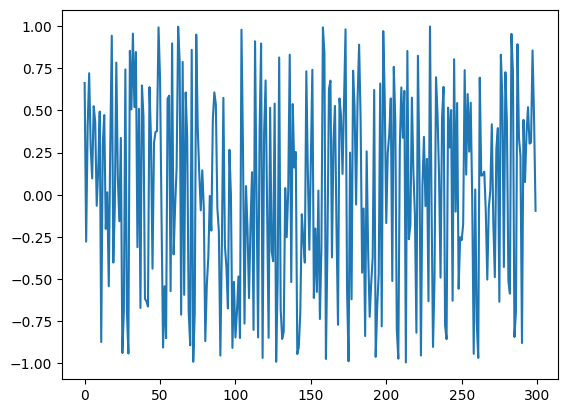

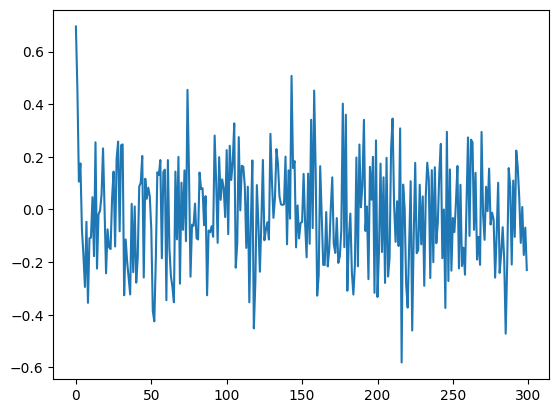

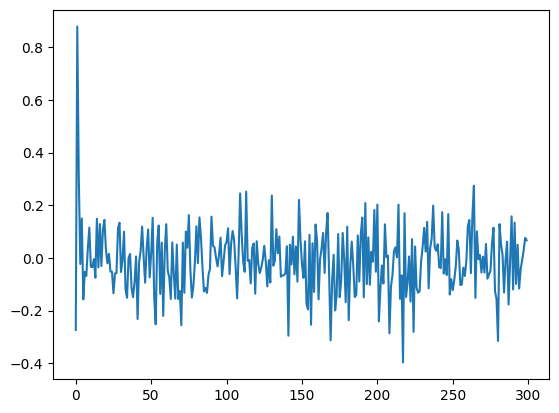

[(0, -0.009783903578411138), (1, -0.0005089800931436057)]
Removing original feature: 0
[1]
[(0, -0.004323326354430432), (1, -0.0002714501351287679), (2, -0.00017972436681939694)]
Removing original feature: 0
[(1, -0.005640301590800104), (0, -0.00046081800338029777)]
Removing original feature: 2
[1]
[(0, -0.004323326354430432), (1, -0.0002714501351287679)]
Removing original feature: 0
[1]





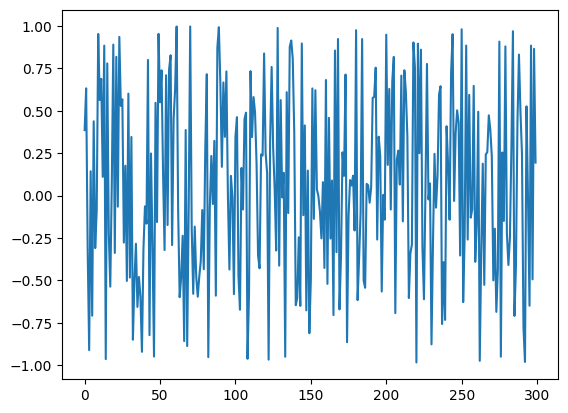

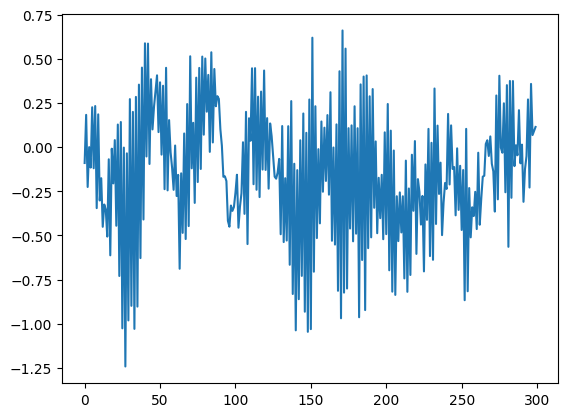

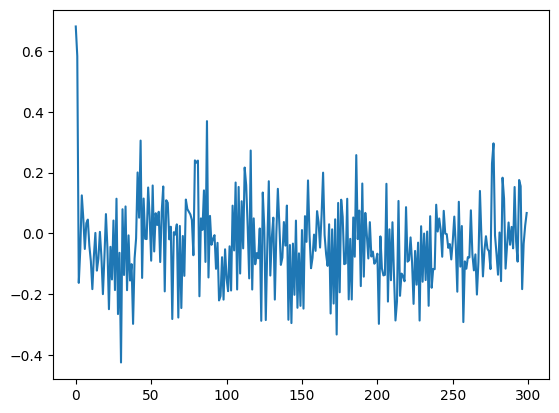

CMI: 8.629800716243585e-05
[(0, -0.14123006099899071), (1, 8.629800716243585e-05)]
Removing original feature: 0
[1]
CMI: 0.08861818183066601
[(0, -0.2896469546596333), (1, -0.00015932022954828762), (2, 0.08861818183066601)]
Removing original feature: 0
CMI: 3.8161025079641586e-05
CMI: 0.23703507549130862
[(0, 3.8161025079641586e-05), (1, 0.23703507549130862)]
Removing original feature: 1
[2]
[(0, -0.2896469546596333), (1, -0.00015932022954828762)]
Removing original feature: 0
[1]





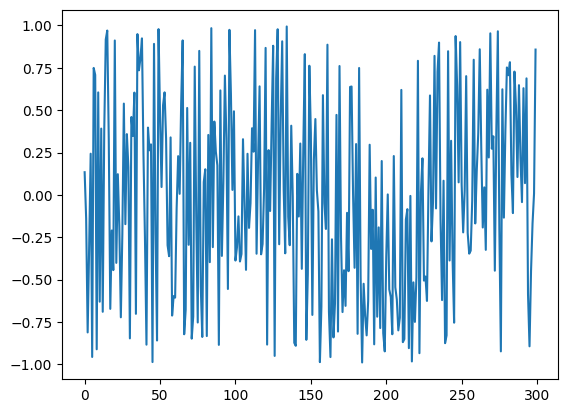

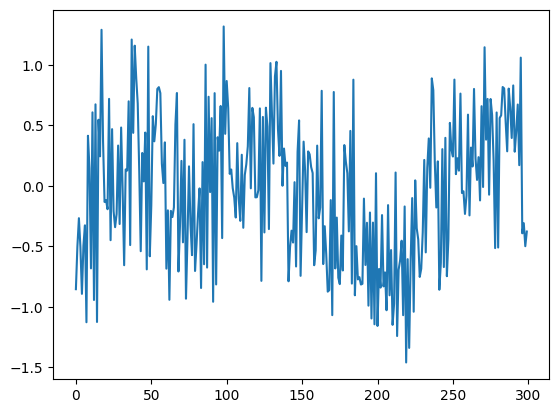

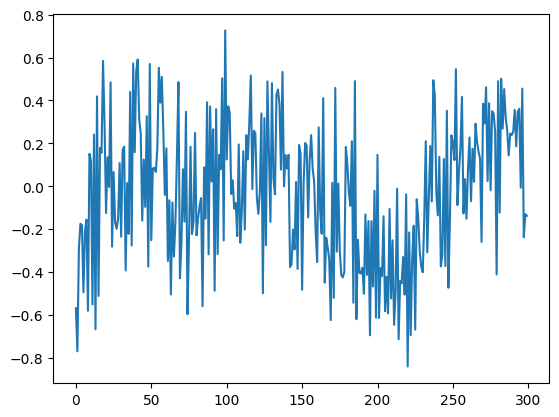

CMI: 0.2554465594294569
[(1, -0.019098049851433152), (0, 0.2554465594294569)]
Removing original feature: 1
[0]
CMI: 0.19674756452039313
[(2, -0.07609359693637757), (1, -0.0034561452237584778), (0, 0.19674756452039313)]
Removing original feature: 2
CMI: 0.2554465594294569
[(1, -0.019098049851433152), (0, 0.2554465594294569)]
Removing original feature: 1
[0]
CMI: 0.19674756452039313
[(1, -0.0034561452237584778), (0, 0.19674756452039313)]
Removing original feature: 1
[0]





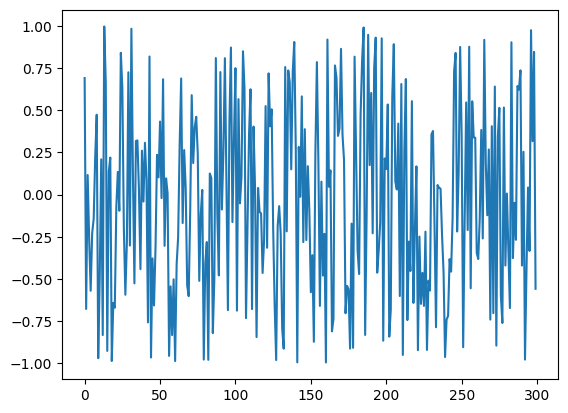

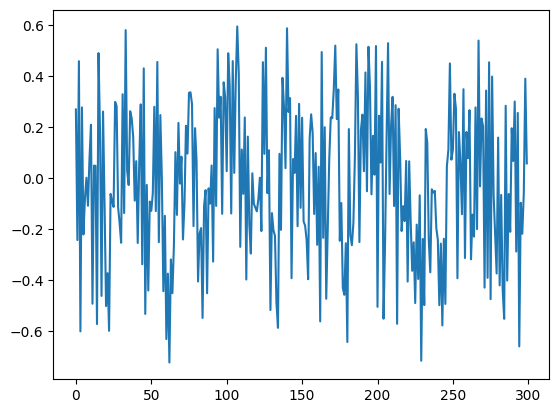

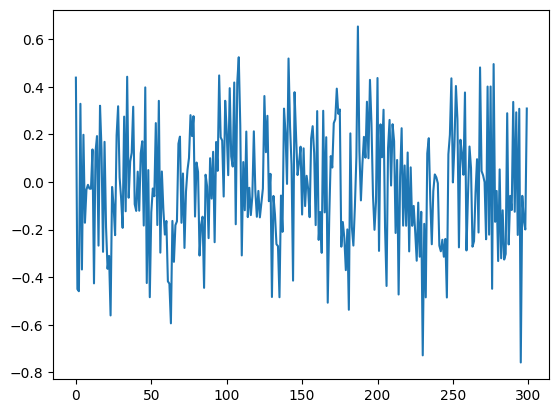

CMI: 0.05801050885825962
[(1, -0.01232467554605407), (0, 0.05801050885825962)]
Removing original feature: 1
[0]
CMI: 0.05575259506739932
[(2, -0.008312587241481484), (1, -0.004067814859073093), (0, 0.05575259506739932)]
Removing original feature: 2
CMI: 0.05801050885825962
[(1, -0.01232467554605407), (0, 0.05801050885825962)]
Removing original feature: 1
[0]
CMI: 0.05575259506739932
[(1, -0.004067814859073093), (0, 0.05575259506739932)]
Removing original feature: 1
[0]





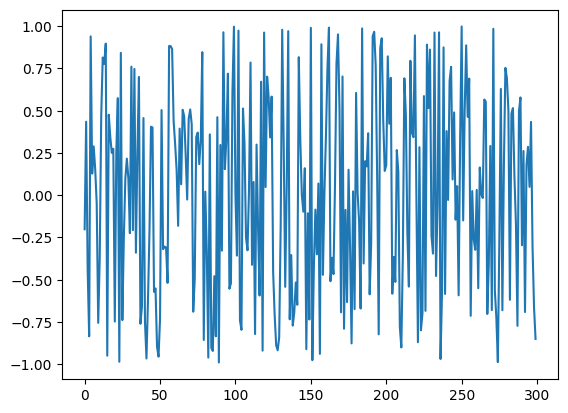

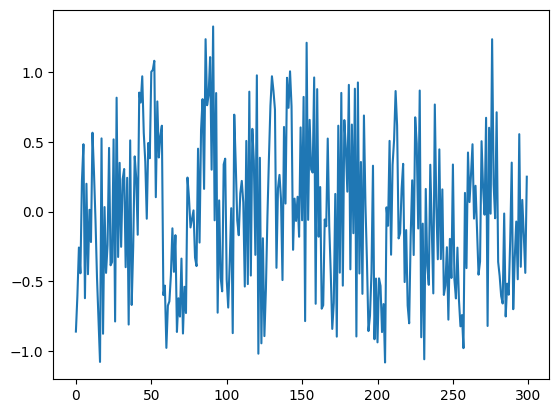

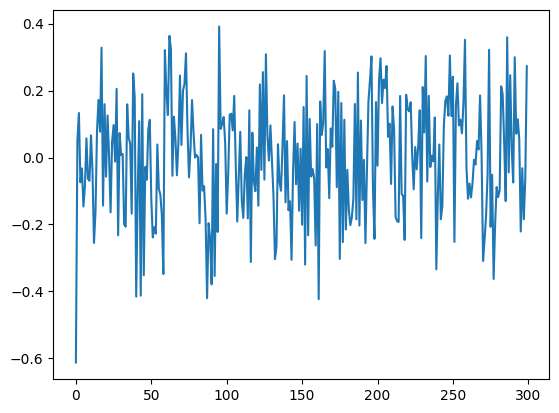

CMI: 0.33031393767615175
[(1, -0.0010397704845533928), (0, 0.33031393767615175)]
Removing original feature: 1
[0]
CMI: 0.21448460756367715
[(2, -0.09262291406459289), (1, -5.4347071412108594e-05), (0, 0.21448460756367715)]
Removing original feature: 2
CMI: 0.33031393767615175
[(1, -0.0010397704845533928), (0, 0.33031393767615175)]
Removing original feature: 1
[0]
CMI: 0.21448460756367715
[(1, -5.4347071412108594e-05), (0, 0.21448460756367715)]
Removing original feature: 1
[0]





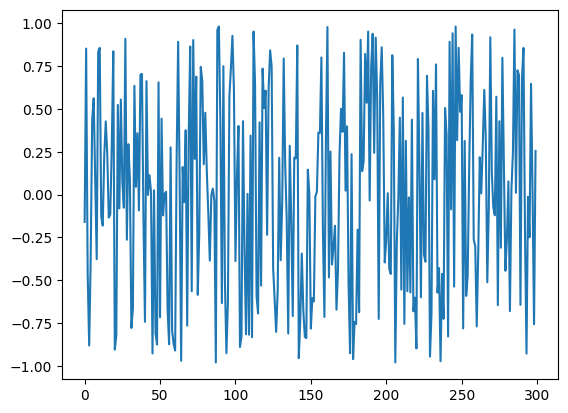

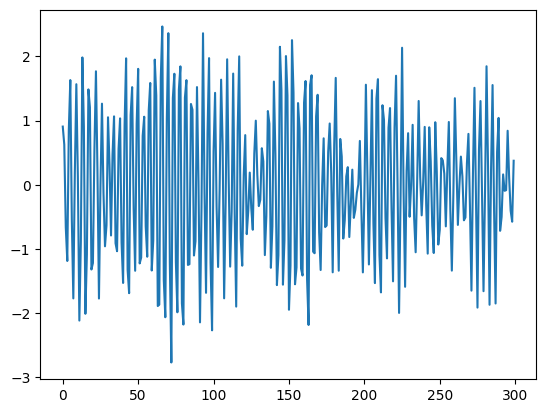

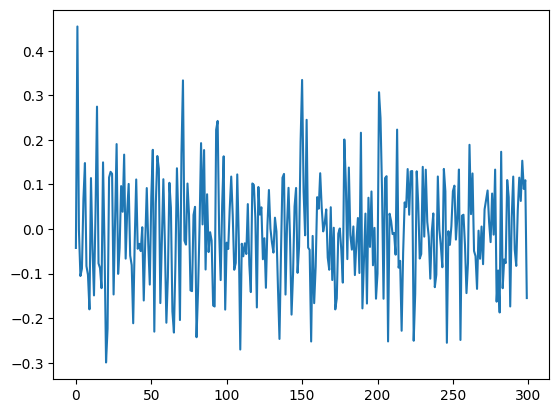

CMI: 0.04689055494813804
[(1, 0.0), (0, 0.04689055494813804)]
Removing original feature: 1
[0]
CMI: 0.4237622574225134
[(0, -0.0436353184533782), (1, 0.0), (2, 0.4237622574225134)]
Removing original feature: 0
CMI: 0.5142881308240297
[(0, 0.0), (1, 0.5142881308240297)]
Removing original feature: 1
[2]
[(0, -0.0436353184533782), (1, 0.0)]
Removing original feature: 0
[1]



13 18 31 40
7 2 9 40


In [40]:
### Same of above, keeping track on correct/wrong links detected

correct_CMI = 0
wrong_CMI = 0
correct_CMIwithTar = 0
wrong_CMIwithTar = 0
correct_TE = 0
wrong_TE = 0
tot_links = 0
correct_links = set([0,2])

for seed in range(20):   
    rng = np.random.default_rng(seed=seed)
    random.seed(seed)
    np.random.seed(seed)
    
    x0 = rng.uniform(-1,1,size=300)
    plt.plot(x0)
    plt.show()
    
    y = list(rng.uniform(-1,1,size=2))
    c = [rng.uniform(-1,1),rng.uniform(-1,1)]
    for i in range(300 - 2):
        next_val = y[-2]*c[0] + x0[i]*c[1] + np.random.randn() * 0.1
        y.append(next_val)
    plt.plot(y)
    plt.show()
    
    x1 = list(rng.uniform(-1,1,size=2))
    d = rng.uniform(-1,1)
    for i in range(300 - 2):
        next_val = y[i+1]*d + np.random.randn() * 0.1
        x1.append(next_val)
    plt.plot(x1)
    plt.show()
    
    x = np.concatenate((np.array(x0).reshape(-1,1),np.array(x1).reshape(-1,1)),axis=1)
    y = np.array(y)
    
    res = {
            "delta" : [], # list with all deltas
            "numSelected" : [], #
            "selectedFeatures" : [] 
        #    "accuracy" : [] # list of scores associated with the reduced problem
        }
    
    sel = backwardFeatureSelection(threshold=100,features=x,target=y,res=res,k=20, nproc=1, tau=5)
    print(sel)
    CMI_selected = set(sel)
    
    res = {
            "delta" : [], # list with all deltas
            "numSelected" : [], #
            "selectedFeatures" : [] 
        #    "accuracy" : [] # list of scores associated with the reduced problem
        }
    
    sel = backwardFeatureSelection(threshold=100,features=np.concatenate((x,y.reshape(-1,1)),axis=1),target=y,res=res,k=20, nproc=1, tau=5)
    print(sel)
    CMI_WithTar_selected = set(sel)
    
    res = {
            "delta" : [], # list with all deltas
            "numSelected" : [], #
            "selectedFeatures" : [] 
        #    "accuracy" : [] # list of scores associated with the reduced problem
        }
    
    sel = TE_backwardFeatureSelection(threshold=100,features=x,target=y,res=res,k=20, nproc=1, tau=5)
    print(sel)
    TE_selected = set(sel)
    print('\n\n')
    
    correct_CMI += len([found for found in CMI_selected if found in correct_links])
    wrong_CMI += len(CMI_selected) - len([found for found in CMI_selected if found in correct_links])
    correct_CMIwithTar += len([found for found in CMI_WithTar_selected if found in correct_links])
    wrong_CMIwithTar += len(CMI_WithTar_selected) - len([found for found in CMI_WithTar_selected if found in correct_links])
    correct_TE += len([found for found in TE_selected if found in correct_links])+1
    wrong_TE += len(TE_selected) - len([found for found in TE_selected if found in correct_links])
    tot_links += len(correct_links)

print(correct_CMI, correct_CMIwithTar, correct_TE, tot_links)
print(wrong_CMI, wrong_CMIwithTar, wrong_TE, tot_links)


### random networks with dimension 3

In [9]:
correct_CMI_forward = 0
correct_CMIwithTar_forward = 0
correct_TE_forward = 0
tot_links = 0

for i in range(5):
    x_start,x_end,x_lag,x_coeff,y_start,y_lag,y_coeff,x,y =  generate_dataset(n_data=300, n_variables=3, tau=2, n_xx=0, n_xy=1, n_yy=1, n_yx=1, seed=i)
    
    print(x,y)
    
    correct_links = set(y_start)
    
    ### forward CMI FS
    res = {
            "delta" : [], # list with all deltas
            "numSelected" : [], #
            "selectedFeatures" : [] 
        #    "accuracy" : [] # list of scores associated with the reduced problem
        }
    
    sel = forwardFeatureSelection(threshold=100,features=x,target=y,res=res,k=20, nproc=1, tau=5)
    CMI_forward_selected = set(sel)
    
    ### forward CMI FS with past target as candidate feature
    res = {
            "delta" : [], # list with all deltas
            "numSelected" : [], #
            "selectedFeatures" : [] 
        #    "accuracy" : [] # list of scores associated with the reduced problem
        }
    
    sel = forwardFeatureSelection(threshold=100,features=np.concatenate((x,y.reshape(-1,1)),axis=1),target=y,res=res,k=20, nproc=1, tau=5)
    CMI_forwardWithTar_selected = set(sel)
    
    ### forward TE FS
    res = {
            "delta" : [], # list with all deltas
            "numSelected" : [], #
            "selectedFeatures" : [] 
        #    "accuracy" : [] # list of scores associated with the reduced problem
        }
    
    sel = TE_forwardFeatureSelection(threshold=100,features=np.concatenate((x,y.reshape(-1,1)),axis=1),target=y,res=res,k=20, nproc=1, tau=5)
    TE_forward_selected = set(sel)
    
    correct_CMI_forward += len([found for found in CMI_forward_selected if found in correct_links])
    correct_CMIwithTar_forward += len([found for found in CMI_forwardWithTar_selected if found in correct_links])
    correct_TE_forward += len([found for found in TE_forward_selected if found in correct_links])+1
    tot_links += len(correct_links)
    
    print(correct_links, CMI_forward_selected, CMI_forwardWithTar_selected, TE_forward_selected)

    print(x_start,'\n',x_end,'\n',x_lag,'\n',x_coeff,'\n',y_start,'\n',y_lag,'\n',y_coeff)
    print(correct_CMI_forward, correct_CMIwithTar_forward, correct_TE_forward, tot_links)
    print('\n\n')

    

[[-9.66944729e-01  6.26540478e-01  8.25511155e-01]
 [ 2.13271552e-01  4.58993122e-01  8.72499829e-02]
 [ 1.44806727e-01  0.00000000e+00  0.00000000e+00]
 [-1.90829191e-01  0.00000000e+00  0.00000000e+00]
 [ 1.75191302e-01  0.00000000e+00  0.00000000e+00]
 [-1.60834892e-01  0.00000000e+00  0.00000000e+00]
 [ 1.47654947e-01  0.00000000e+00  0.00000000e+00]
 [-1.35555060e-01  0.00000000e+00  0.00000000e+00]
 [ 1.24446723e-01  0.00000000e+00  0.00000000e+00]
 [-1.14248682e-01  0.00000000e+00  0.00000000e+00]
 [ 1.04886340e-01  0.00000000e+00  0.00000000e+00]
 [-9.62912137e-02  0.00000000e+00  0.00000000e+00]
 [ 8.84004330e-02  0.00000000e+00  0.00000000e+00]
 [-8.11562784e-02  0.00000000e+00  0.00000000e+00]
 [ 7.45057610e-02  0.00000000e+00  0.00000000e+00]
 [-6.84002338e-02  0.00000000e+00  0.00000000e+00]
 [ 6.27950366e-02  0.00000000e+00  0.00000000e+00]
 [-5.76491687e-02  0.00000000e+00  0.00000000e+00]
 [ 5.29249895e-02  0.00000000e+00  0.00000000e+00]
 [-4.85879429e-02  0.00000000e+

CMI: 0.01196746579209218
Highest CMI score: 0.01196746579209218
Adding original feature: 2
Highest CMI score: 0.0
{1, 3} {0, 1} {2, 3} {2}
[3] 
 [0] 
 [1] 
 [0.2739233746429086] 
 [1, 3] 
 [1, 1] 
 [-0.4604265724722594, -0.9180529521276106]
1 1 1 2



[[ 8.97298894e-01 -3.76337096e-01 -1.53347102e-01]
 [ 6.55405188e-01 -1.81601727e-01  9.91873753e-02]
 [ 0.00000000e+00 -1.44221714e-02  0.00000000e+00]
 [ 0.00000000e+00  2.42246704e-02  0.00000000e+00]
 [ 0.00000000e+00 -1.72402322e-02  0.00000000e+00]
 [ 0.00000000e+00  1.22695418e-02  0.00000000e+00]
 [ 0.00000000e+00 -8.73199700e-03  0.00000000e+00]
 [ 0.00000000e+00  6.21439439e-03  0.00000000e+00]
 [ 0.00000000e+00 -4.42266501e-03  0.00000000e+00]
 [ 0.00000000e+00  3.14752566e-03  0.00000000e+00]
 [ 0.00000000e+00 -2.24003350e-03  0.00000000e+00]
 [ 0.00000000e+00  1.59418878e-03  0.00000000e+00]
 [ 0.00000000e+00 -1.13455350e-03  0.00000000e+00]
 [ 0.00000000e+00  8.07439916e-04  0.00000000e+00]
 [ 0.00000000e+00 -5.74639465e-04 

CMI: 0.006733462170660884
CMI: 0.3302660970024538
Highest CMI score: 0.3302660970024538
Adding original feature: 3
Highest CMI score: 0.0
Highest CMI score: 0.0
{0, 3} {0, 1} {3} set()
[3] 
 [1] 
 [1] 
 [0.023643249400513433] 
 [0, 3] 
 [1, 1] 
 [0.9009273926518706, -0.7116807745607325]
2 2 2 4



[[-8.16168116e-01  2.00201052e-01  4.57121054e-01]
 [-6.24197853e-01 -8.89706745e-01 -4.50061264e-01]
 [-6.03955474e-02  0.00000000e+00  0.00000000e+00]
 [-2.08911990e-01  0.00000000e+00  0.00000000e+00]
 [-1.31291050e-01  0.00000000e+00  0.00000000e+00]
 [-8.25100547e-02  0.00000000e+00  0.00000000e+00]
 [-5.18535661e-02  0.00000000e+00  0.00000000e+00]
 [-3.25874504e-02  0.00000000e+00  0.00000000e+00]
 [-2.04796315e-02  0.00000000e+00  0.00000000e+00]
 [-1.28704547e-02  0.00000000e+00  0.00000000e+00]
 [-8.08845635e-03  0.00000000e+00  0.00000000e+00]
 [-5.08320237e-03  0.00000000e+00  0.00000000e+00]
 [-3.19454606e-03  0.00000000e+00  0.00000000e+00]
 [-2.00761720e-03  0.00000000e+00  0.0

CMI: 0.024052472251821166
Highest CMI score: 0.024052472251821166
Adding original feature: 1
Highest CMI score: 0.0
CMI: 0.2317589768849406
CMI: 0.030651111707605226
CMI: 0.030651111707605226
CMI: 0.24483439061308634
Highest CMI score: 0.24483439061308634
Adding original feature: 3
CMI: 0.012026236125910639
CMI: 0.012026236125910639
Highest CMI score: 0.012026236125910639
Adding original feature: 1
Highest CMI score: 0.0
CMI: 0.012026236125910639
CMI: 0.012026236125910639
Highest CMI score: 0.012026236125910639
Adding original feature: 1
Highest CMI score: 0.0
{1, 3} {0, 1} {1, 3} {1}
[3] 
 [0] 
 [1] 
 [-0.4767757315013672] 
 [1, 3] 
 [1, 1] 
 [-0.4030177131717534, 0.6284514811885606]
3 4 4 6



[[ 1.64324072e-01 -8.11742716e-01 -1.33746120e-01]
 [-4.18974037e-02 -6.80522171e-01  4.69154303e-01]
 [ 0.00000000e+00  0.00000000e+00  5.66088948e-01]
 [ 0.00000000e+00  0.00000000e+00  3.22820176e-01]
 [ 0.00000000e+00  0.00000000e+00  1.94514952e-01]
 [ 0.00000000e+00  0.00000000e+00  1.172

Highest CMI score: 0.0
CMI: 0.018466914092013766
CMI: 0.02726128119913066
CMI: 0.21225928644425812
CMI: 0.21291309992044027
Highest CMI score: 0.21291309992044027
Adding original feature: 3
CMI: 0.01202623612591075
Highest CMI score: 0.01202623612591075
Adding original feature: 1
Highest CMI score: 0.0
CMI: 0.01202623612591075
Highest CMI score: 0.01202623612591075
Adding original feature: 1
Highest CMI score: 0.0
{0, 3} {1, 2} {1, 3} {1}
[3] 
 [2] 
 [1] 
 [-0.8287016657127513] 
 [0, 3] 
 [1, 1] 
 [-0.5263789868078006, 0.6025489304127938]
3 5 5 8



[[-8.38327952e-01  2.14711664e-01 -2.47026831e-01]
 [ 6.03802414e-01 -6.50944368e-01  7.43270548e-01]
 [ 0.00000000e+00  0.00000000e+00 -5.93282824e-01]
 [ 0.00000000e+00  0.00000000e+00 -5.50173290e-01]
 [ 0.00000000e+00  0.00000000e+00 -5.35943265e-01]
 [ 0.00000000e+00  0.00000000e+00 -5.21523924e-01]
 [ 0.00000000e+00  0.00000000e+00 -5.07504015e-01]
 [ 0.00000000e+00  0.00000000e+00 -4.93860760e-01]
 [ 0.00000000e+00  0.00000000e+00 -4

Highest CMI score: 0.012026236125910916
Adding original feature: 0
Highest CMI score: 0.0
CMI: 0.011342572183846045
CMI: 0.011342572183846045
Highest CMI score: 0.011342572183846045
Adding original feature: 0
Highest CMI score: 0.0
{2, 3} {0, 2} {0, 2} {0}
[3] 
 [2] 
 [1] 
 [0.8861122111447353] 
 [2, 3] 
 [1, 1] 
 [0.022655105628723193, 0.9524874114154083]
4 6 6 10





In [19]:
seed=1
n_data=10
n_variables=3
tau=4
n_xx=3
n_xy=0
n_yy=1
n_yx=1

rng = np.random.default_rng(seed=seed)
random.seed(seed)
np.random.seed(seed)

x = np.zeros((n_data,n_variables))
y = np.zeros((n_data))

x_start = list(np.random.randint(low=0, high=n_variables, size=n_xx))
x_end = list(np.random.randint(low=0, high=n_variables, size=n_xx))
x_lag = list(np.random.randint(low=1, high=tau, size=n_xx))
x_coeff = list(rng.uniform(-1,1,size=n_xx))

for i in range(n_yx):
    x_start.append(n_variables)
    x_end.append(np.random.randint(low=0, high=n_variables))
    x_lag.append(np.random.randint(low=1, high=tau))
    x_coeff.append(rng.uniform(-1,1))

y_start = list(np.random.randint(low=0, high=n_variables, size=n_xy))
y_lag = list(np.random.randint(low=1, high=tau, size=n_xy))
y_coeff = list(rng.uniform(-1,1,size=n_xy))

for i in range(n_yy):
    y_start.append(n_variables)
    y_lag.append(np.random.randint(low=1, high=tau))
    y_coeff.append(rng.uniform(-1,1))

print(x_start, x_end, x_lag, x_coeff, y_start, y_lag, y_coeff)

[1, 0, 0, 3] [1, 1, 0, 1] [1, 2, 1, 1] [0.023643249400513433, 0.9009273926518706, -0.7116807745607325, 0.8972988942744877] [3] [3] [-0.3763370959790291]


In [20]:
x

array([[0., 0., 0.],
       [0., 0., 0.],
       [0., 0., 0.],
       [0., 0., 0.],
       [0., 0., 0.],
       [0., 0., 0.],
       [0., 0., 0.],
       [0., 0., 0.],
       [0., 0., 0.],
       [0., 0., 0.]])

In [21]:
x[0:tau,:] = rng.uniform(-1,1,size=(tau,n_variables))#np.random.randn(tau,n_variables)
y[0:tau] = rng.uniform(-1,1,size=(tau))

no_inputs = [k for k in set(range(n_variables)).difference(set(x_end))]
if len(no_inputs)>0: 
    x[:,no_inputs] = rng.uniform(-1,1,size=(n_data,len(no_inputs)))

In [22]:
y

array([-0.19377403, -0.59308952, -0.47537332,  0.50072935,  0.        ,
        0.        ,  0.        ,  0.        ,  0.        ,  0.        ])

In [23]:
x

array([[-0.1533471 ,  0.65540519, -0.43918248],
       [ 0.09918738, -0.94488177, -0.02961805],
       [ 0.07628663, -0.34053657,  0.9614744 ],
       [-0.39361034, -0.09300422,  0.92331439],
       [ 0.        ,  0.        ,  0.44957988],
       [ 0.        ,  0.        ,  0.08245371],
       [ 0.        ,  0.        , -0.44621759],
       [ 0.        ,  0.        , -0.67869598],
       [ 0.        ,  0.        ,  0.93985083],
       [ 0.        ,  0.        ,  0.03213717]])

In [24]:
for i in range(n_data - tau):
    if n_xy>0:
        y[[tau+i]] = sum(x[[a - b for a, b in zip([tau+i]*n_xy, y_lag[0:n_xy])],y_start[0:n_xy]] * y_coeff[0:n_xy])
                
    if n_yy>0:
        y[[tau+i]] += sum(y[[a - b for a, b in zip([tau+i]*n_yy, y_lag[n_xy:])]] * y_coeff[n_xy:])


In [25]:
y

array([-0.19377403, -0.59308952, -0.47537332,  0.50072935,  0.22320159,
        0.17890061, -0.18844303, -0.08399904, -0.06732694,  0.0709181 ])

In [40]:





for i in range(n_data - tau):
        y[[tau+i]] = sum(x[[a - b for a, b in zip([tau+i]*n_xy, y_lag[0:n_xy])],y_start[0:n_xy]] * y_coeff[0:n_xy])
        y[[tau+i]] += sum(y[[a - b for a, b in zip([tau+i]*n_yy, y_lag[n_xy:])]] * y_coeff[n_xy:])
        #y[[tau+i]] += np.random.randn()*0.001
        #y[[tau+i]] -= (n_xy+n_yy)

        for j in range(n_variables):
            #bias = 0
            #compr = [a - b for a, b, c, d in zip(x_start,x_end,x_lag,x_coeff)]
            idx = [k for k in range(len(x_end)) if (x_end[k] == j) & (k<n_xx)]
            #bias = len(idx)
            x[[[tau+i]],j] = sum( x[[a - b for a, b in zip([tau+i]*len(idx), [x_lag[k] for k in idx])], [x_start[k] for k in idx]] * [x_coeff[k] for k in idx])
            idx = [k for k in range(len(x_end)) if (x_end[k] == j) & (k>=n_xx)]
            #bias += len(idx)
            x[[[tau+i]],j] += sum( y[[a - b for a, b in zip([tau+i]*len(idx), [x_lag[k] for k in idx])]] * [x_coeff[k] for k in idx])
            #x[[[tau+i]],j] += np.random.randn()*0.001
            #x[[[tau+i]],j] -= bias   


In [41]:
x

array([[ 0.27392337, -0.46042657, -0.91805295],
       [-0.96694473,  0.62654048,  0.82551115],
       [ 0.21327155,  0.45899312,  0.08724998],
       [ 0.87014485,  0.63170711, -0.994523  ],
       [-0.14360309, -0.09872945,  0.16410937],
       [ 0.03612162, -0.18406526, -0.02708355],
       [-0.16510208, -0.2198852 ,  0.00681254],
       [-0.13073624,  0.01155403, -0.03113826],
       [ 0.06717788,  0.04687223, -0.02465686],
       [-0.02419594,  0.08794701,  0.01266975]])

### hardcoded

In [3]:
seed=42
rng = np.random.default_rng(seed=seed)
random.seed(seed)
np.random.seed(seed)

In [4]:
x0 = rng.uniform(-1,1,size=300)
x1 = rng.uniform(-1,1,size=300)
x4 = rng.uniform(-1,1,size=300)

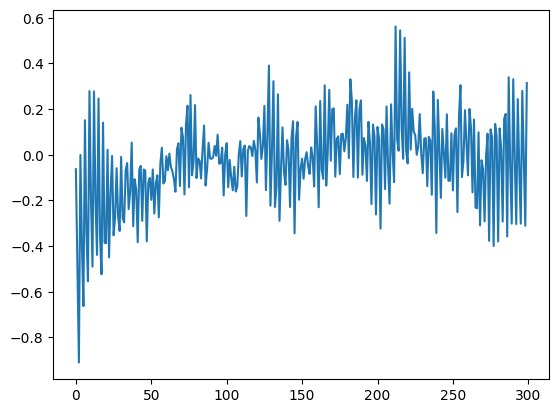

In [5]:
x3 = list(rng.uniform(-1,1,size=3))
for i in range(300 - 3):
    next_val = x3[-3]*0.8 + np.random.randn() * 0.1
    x3.append(next_val)
 
plt.plot(x3)

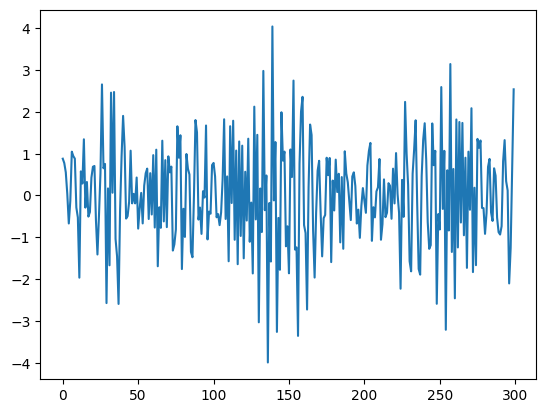

In [84]:
y = list(rng.uniform(-1,1,size=4))
for i in range(300 - 4):
    next_val = y[-3]*(-0.89) + x1[i+2]*(0.65) + x4[i]*(0.87) + np.random.randn() * 0.1
    y.append(next_val)
    
plt.plot(y)

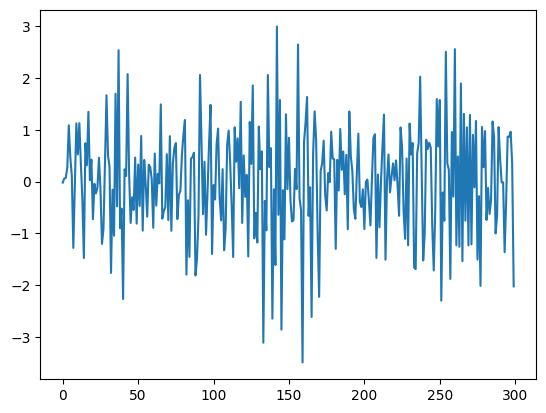

In [85]:
x2 = list(rng.uniform(-1,1,size=3))
for i in range(300 - 3):
    next_val = y[i]*0.8 + x1[i]*(-0.75) + np.random.randn() * 0.1
    x2.append(next_val)
 
plt.plot(x2)

In [86]:
from sklearn.linear_model import LinearRegression
x1 = np.array(x1)
y = np.array(y)
reg_x = LinearRegression().fit(x1[:198].reshape(-1,1), y[2:200].reshape(-1,1))
reg_x.score(x1[200:-2].reshape(-1,1), y[202:].reshape(-1,1))


0.05721418460887284

In [87]:
from sklearn.linear_model import LinearRegression
x4 = np.array(x4)
y = np.array(y)
reg_x = LinearRegression().fit(x4[:196].reshape(-1,1), y[4:200].reshape(-1,1))
reg_x.score(x4[200:-4].reshape(-1,1), y[204:].reshape(-1,1))


0.1823868216877269

In [49]:
reg_x = LinearRegression().fit(np.concatenate((x1[2:198].reshape(-1,1),x4[:196].reshape(-1,1)),axis=1), y[4:200].reshape(-1,1))


In [50]:
reg_x.score(np.concatenate((x1[202:-2].reshape(-1,1),x4[200:-4].reshape(-1,1)),axis=1), y[204:].reshape(-1,1))


0.13971093597167594

In [10]:
x1_past3 = np.concatenate((x1[2:-1].reshape(-1,1), x1[1:-2].reshape(-1,1), x1[0:-3].reshape(-1,1)),axis=1)
y_past3 = y[3:]

In [11]:
reg_x = LinearRegression().fit(x1_past3[:200], y_past3[:200].reshape(-1,1))
reg_x.score(x1_past3[200:], y_past3[200:].reshape(-1,1))



0.3281681278489452

In [22]:
reg_x.coef_

array([[ 0.51696554, -0.30566812]])

In [80]:
x = np.concatenate((np.array(x0).reshape(-1,1),np.array(x1).reshape(-1,1),np.array(x2).reshape(-1,1),np.array(x3).reshape(-1,1),np.array(x4).reshape(-1,1)),axis=1)
x

array([[ 0.5479121 ,  0.55799271, -0.50318719, -0.06316672, -0.04498825],
       [-0.12224312, -0.73089558, -0.510407  , -0.48112032,  0.52286513],
       [ 0.71719584,  0.07213607, -0.67749187, -0.90965377,  0.80665574],
       ...,
       [ 0.60405176,  0.26753955,  0.93399128, -0.01237375, -0.5958238 ],
       [ 0.55895508,  0.9636119 ,  0.53971429, -0.31059764, -0.62846773],
       [ 0.28496655,  0.24071542, -2.06036166,  0.31400766,  0.0440246 ]])

In [81]:
### forward CMI FS
res = {
            "delta" : [], # list with all deltas
            "numSelected" : [], #
            "selectedFeatures" : [] 
        #    "accuracy" : [] # list of scores associated with the reduced problem
        }
    
sel = forwardFeatureSelection(threshold=100,features=x,target=y,res=res,k=20, nproc=1, tau=5)
sel

CMI: 0.07004202236376907
CMI: 0.1606733263252647
CMI: 0.033493849444165294
Highest CMI score: 0.1606733263252647
Adding original feature: 2
CMI: 0.004554653064854225
Highest CMI score: 0.004554653064854225
Adding original feature: 1
Highest CMI score: -0.0003391247215399351


[2, 1]

In [82]:
res = {
            "delta" : [], # list with all deltas
            "numSelected" : [], #
            "selectedFeatures" : [] 
        #    "accuracy" : [] # list of scores associated with the reduced problem
        }
    
sel = forwardFeatureSelection(threshold=100,features=np.concatenate((x,y.reshape(-1,1)),axis=1),target=y,res=res,k=20, nproc=1, tau=5)
sel


CMI: 0.07004202236376907
CMI: 0.1606733263252647
CMI: 0.033493849444165294
CMI: 0.2664079327880074
Highest CMI score: 0.2664079327880074
Adding original feature: 5
CMI: 0.018086695991194612
CMI: 0.014901995389035638
Highest CMI score: 0.018086695991194612
Adding original feature: 1
Highest CMI score: -0.0006441048059259713


[5, 1]

In [83]:
res = {
            "delta" : [], # list with all deltas
            "numSelected" : [], #
            "selectedFeatures" : [] 
        #    "accuracy" : [] # list of scores associated with the reduced problem
        }
    
sel = TE_forwardFeatureSelection(threshold=100,features=np.concatenate((x,y.reshape(-1,1)),axis=1),target=y,res=res,k=20, nproc=1, tau=5)
sel 


CMI: 0.018086695991194612
CMI: 0.014901995389035638
Highest CMI score: 0.018086695991194612
Adding original feature: 1
Highest CMI score: 0.0


[1]

In [88]:
### metto un po' di coefficienti random per vedere cosa succede in vari casi

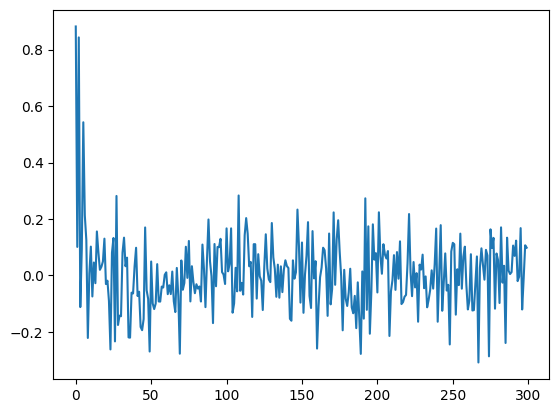

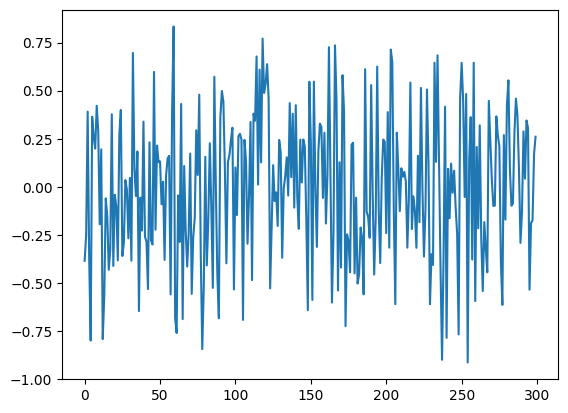

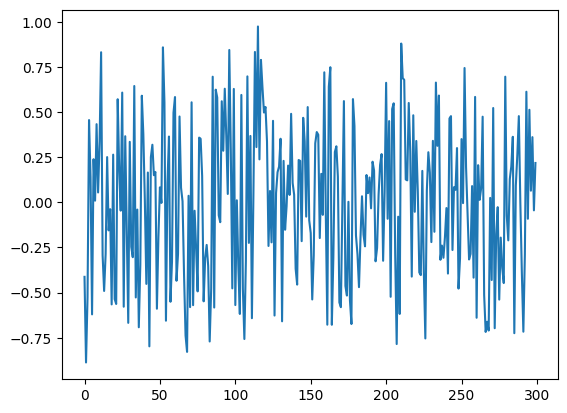

CMI: 0.037527909255362715
CMI: 0.003083526564119878
CMI: 0.0036608478225366005
CMI: 0.1674708485917383
Highest CMI score: 0.1674708485917383
Adding original feature: 4
Highest CMI score: -0.002979544107375387
[4]
CMI: 0.037527909255362715
CMI: 0.003083526564119878
CMI: 0.0036608478225366005
CMI: 0.1674708485917383
CMI: 0.01621978780883416
Highest CMI score: 0.1674708485917383
Adding original feature: 4
Highest CMI score: -0.002979544107375387
[4]
CMI: 0.020189702281934962
CMI: 0.0006653497888995732
CMI: 0.09495064067280726
Highest CMI score: 0.09495064067280726
Adding original feature: 4
Highest CMI score: 0.0
[4]





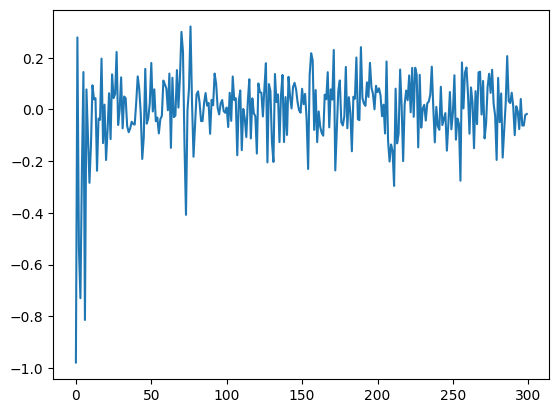

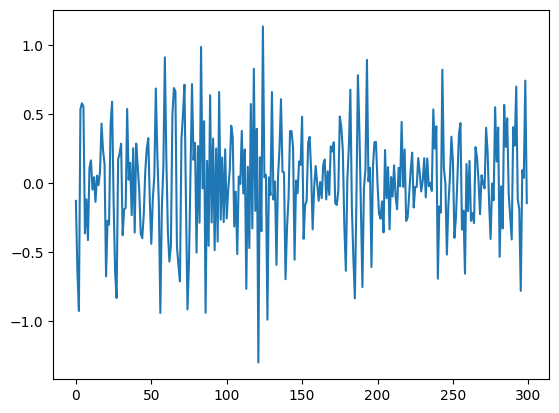

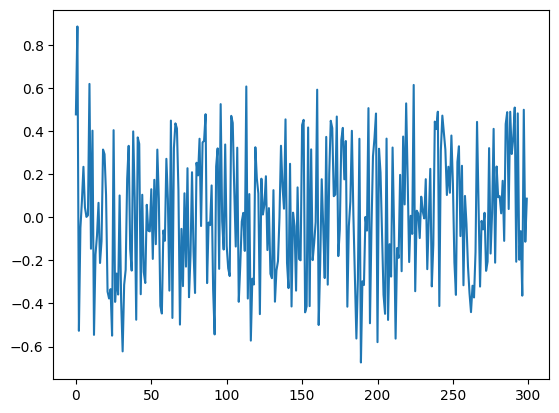

CMI: 0.07386025556135785
CMI: 0.07377250878475632
Highest CMI score: 0.07386025556135785
Adding original feature: 1
Highest CMI score: -6.168165020432881e-05
[1]
CMI: 0.07386025556135785
CMI: 0.07377250878475632
CMI: 0.27988698328654593
Highest CMI score: 0.27988698328654593
Adding original feature: 5
Highest CMI score: -0.005585512357859812
[5]
Highest CMI score: 0.0
[]





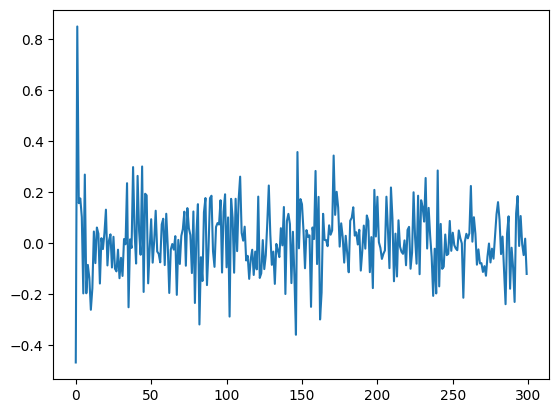

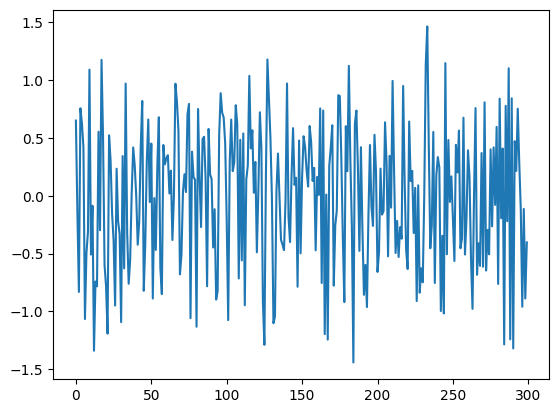

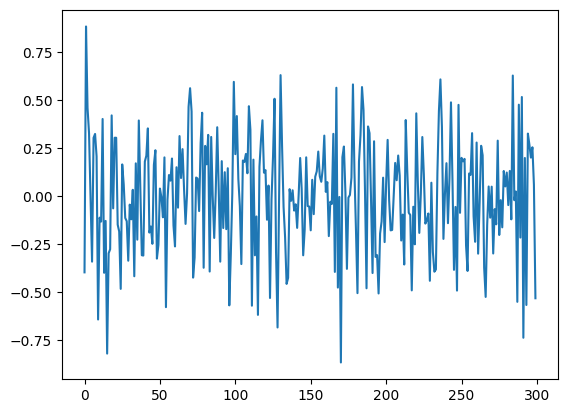

CMI: 0.022584053299330376
CMI: 0.018156663178325937
CMI: 0.32954227953090215
Highest CMI score: 0.32954227953090215
Adding original feature: 4
Highest CMI score: -0.0005461553317558376
[4]
CMI: 0.022584053299330376
CMI: 0.018156663178325937
CMI: 0.32954227953090215
CMI: 0.03081883194113606
Highest CMI score: 0.32954227953090215
Adding original feature: 4
Highest CMI score: -0.0005461553317558376
[4]
CMI: 0.1901569764033944
Highest CMI score: 0.1901569764033944
Adding original feature: 4
Highest CMI score: 0.0
[4]





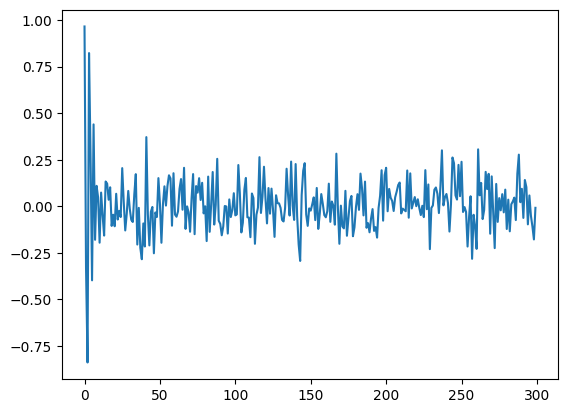

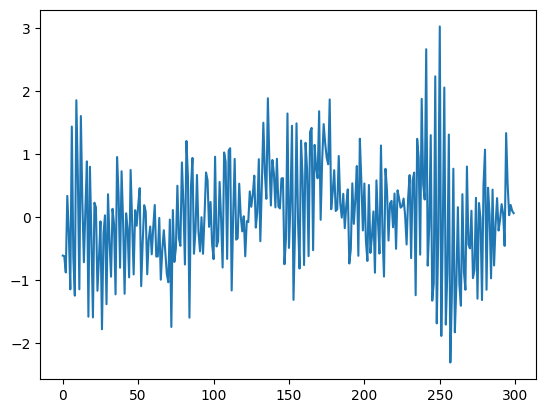

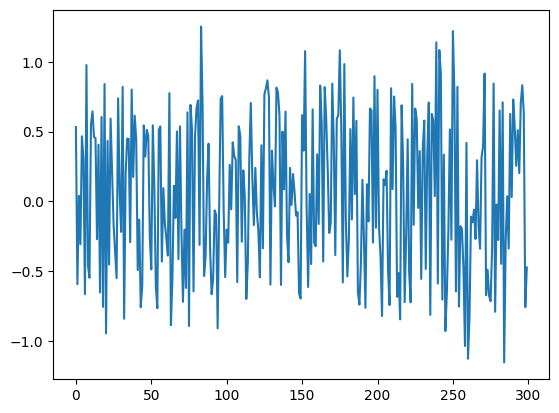

CMI: 0.15046060006740214
CMI: 0.07034410985399735
CMI: 0.018875315592455484
CMI: 0.013479952083315773
Highest CMI score: 0.15046060006740214
Adding original feature: 1
Highest CMI score: -0.0005007701162091371
[1]
CMI: 0.15046060006740214
CMI: 0.07034410985399735
CMI: 0.018875315592455484
CMI: 0.013479952083315773
CMI: 0.23823622893545643
Highest CMI score: 0.23823622893545643
Adding original feature: 5
CMI: 0.0015379054755896016
Highest CMI score: 0.0015379054755896016
Adding original feature: 1
Highest CMI score: -1.862544235425867e-05
[5, 1]
CMI: 0.0015379054755896016
Highest CMI score: 0.0015379054755896016
Adding original feature: 1
Highest CMI score: 0.0
[1]





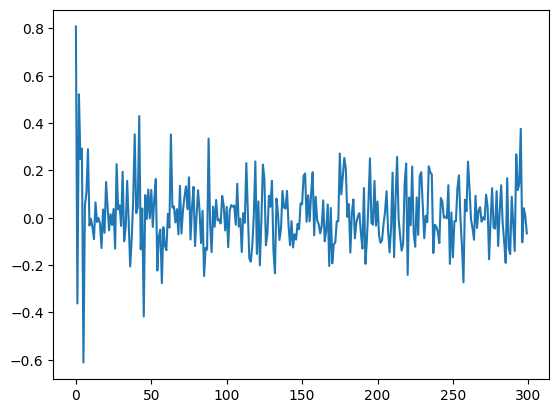

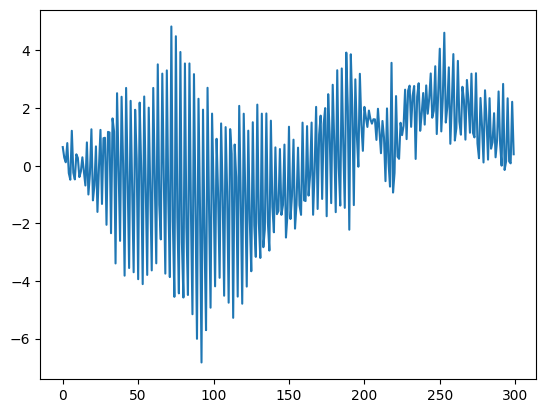

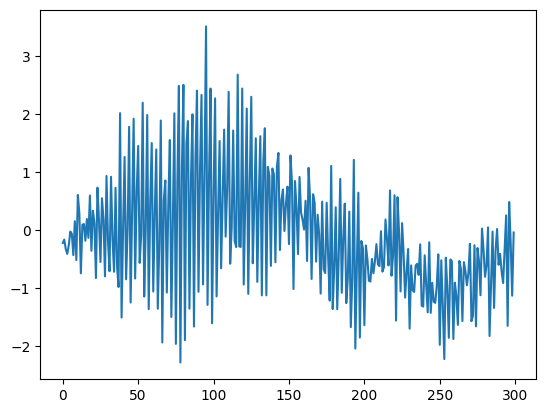

CMI: 0.01208837276238582
CMI: 0.6514783251072751
CMI: 0.015023785011722437
Highest CMI score: 0.6514783251072751
Adding original feature: 2
Highest CMI score: -0.0011086738751602265
[2]
CMI: 0.01208837276238582
CMI: 0.6514783251072751
CMI: 0.015023785011722437
CMI: 0.7463567511015373
Highest CMI score: 0.7463567511015373
Adding original feature: 5
Highest CMI score: 0.0
[5]
Highest CMI score: 0.0
[]





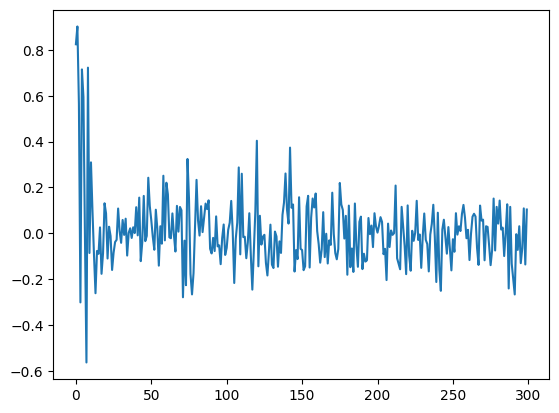

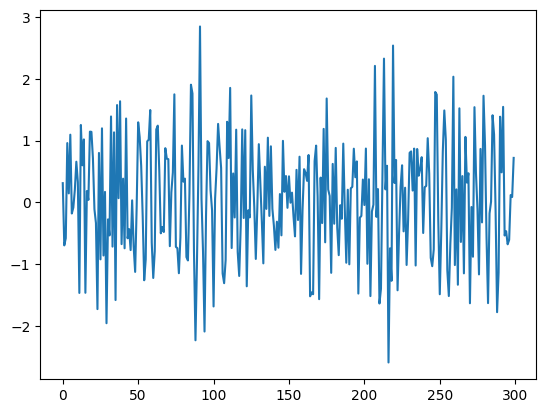

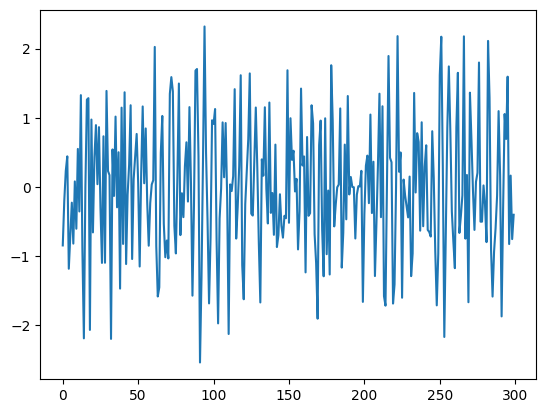

CMI: 0.002772237383950474
CMI: 0.07738251180981573
CMI: 0.07003941396523408
CMI: 0.15882248501455873
Highest CMI score: 0.15882248501455873
Adding original feature: 4
CMI: 0.023020448867411475
CMI: 0.0014665774486329053
Highest CMI score: 0.023020448867411475
Adding original feature: 1
Highest CMI score: -0.00046744936342771326
[4, 1]
CMI: 0.002772237383950474
CMI: 0.07738251180981573
CMI: 0.07003941396523408
CMI: 0.15882248501455873
CMI: 0.18782357860485463
Highest CMI score: 0.18782357860485463
Adding original feature: 5
CMI: 0.03228652329195103
Highest CMI score: 0.03228652329195103
Adding original feature: 4
CMI: 0.0002987934852341778
Highest CMI score: 0.0002987934852341778
Adding original feature: 3
Highest CMI score: -0.0120754141654561
[5, 4, 3]
CMI: 0.03228652329195103
Highest CMI score: 0.03228652329195103
Adding original feature: 4
CMI: 0.0002987934852341778
Highest CMI score: 0.0002987934852341778
Adding original feature: 3
Highest CMI score: 0.0
[4, 3]





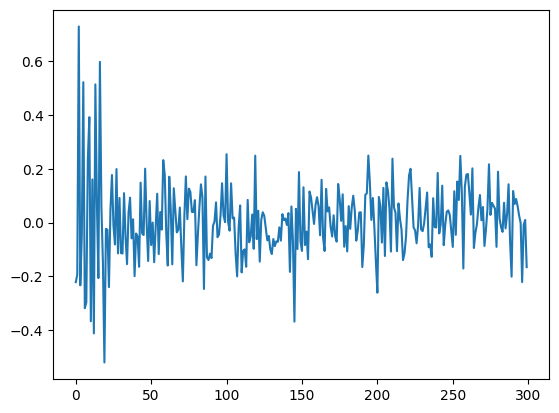

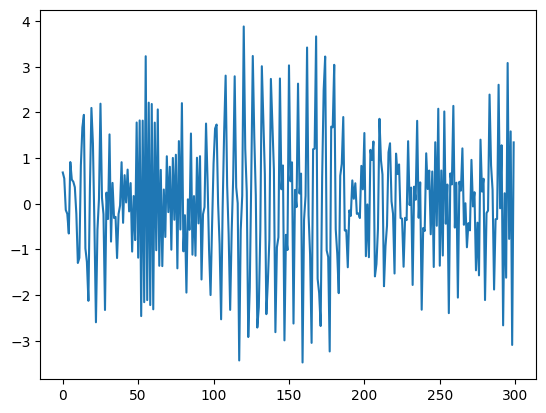

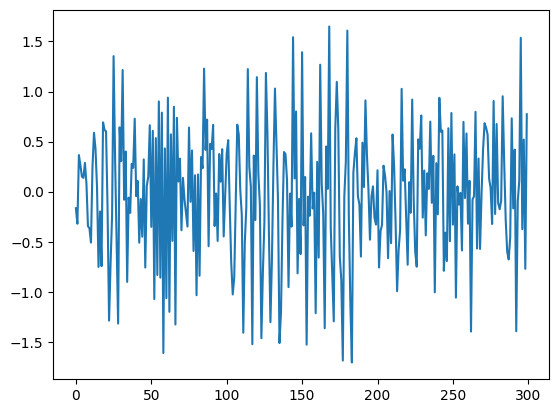

CMI: 0.040772285282906134
CMI: 0.2525813440285366
CMI: 0.043333188126139545
Highest CMI score: 0.2525813440285366
Adding original feature: 2
Highest CMI score: -0.0004945311577475575
[2]
CMI: 0.040772285282906134
CMI: 0.2525813440285366
CMI: 0.043333188126139545
CMI: 0.4828719770996612
Highest CMI score: 0.4828719770996612
Adding original feature: 5
Highest CMI score: 0.0
[5]
Highest CMI score: 0.0
[]





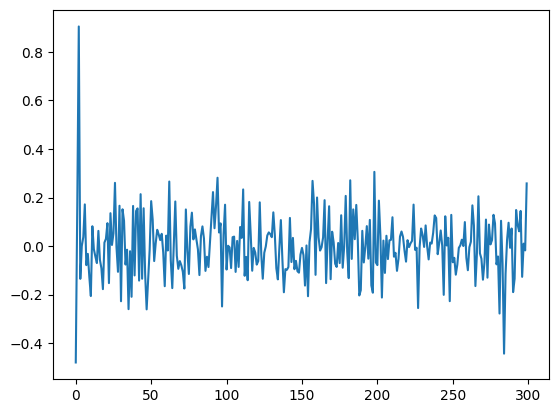

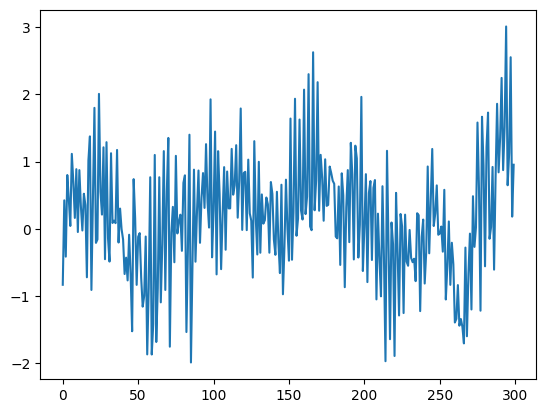

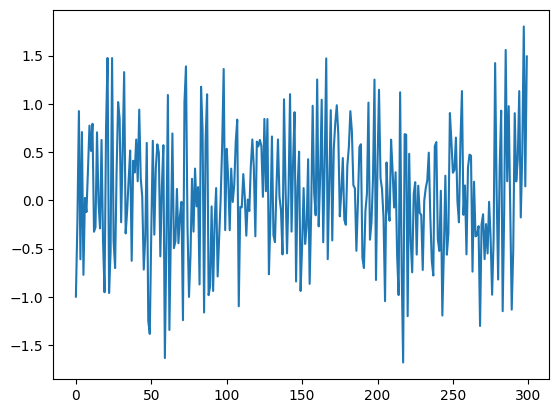

CMI: 0.012665186937937233
CMI: 0.17226260590040207
CMI: 0.050267489919797154
CMI: 0.015125633660181062
Highest CMI score: 0.17226260590040207
Adding original feature: 1
Highest CMI score: -0.0007060070636704385
[1]
CMI: 0.012665186937937233
CMI: 0.17226260590040207
CMI: 0.050267489919797154
CMI: 0.015125633660181062
CMI: 0.2637137663175821
Highest CMI score: 0.2637137663175821
Adding original feature: 5
CMI: 0.004647580469419765
Highest CMI score: 0.004647580469419765
Adding original feature: 1
Highest CMI score: -0.0004234382357505839
[5, 1]
CMI: 0.004647580469419765
Highest CMI score: 0.004647580469419765
Adding original feature: 1
Highest CMI score: 0.0
[1]





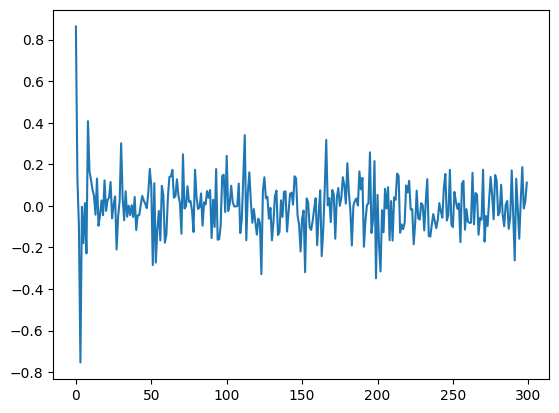

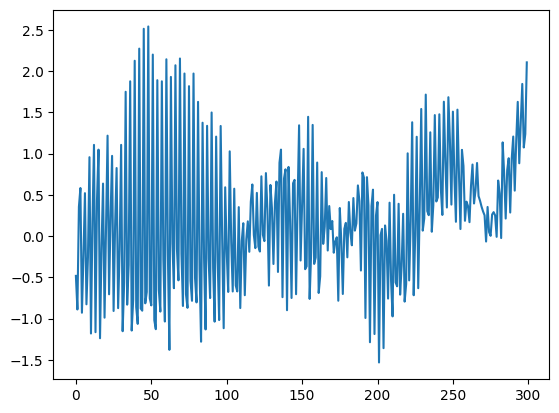

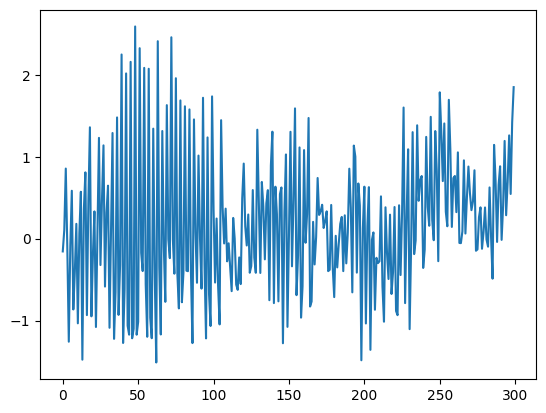

CMI: 0.05896310552427894
CMI: 0.39597053643907837
CMI: 0.016388451332785298
Highest CMI score: 0.39597053643907837
Adding original feature: 2
CMI: 0.0003432670511085423
Highest CMI score: 0.0003432670511085423
Adding original feature: 3
Highest CMI score: -0.08317956439221807
[2, 3]
CMI: 0.05896310552427894
CMI: 0.39597053643907837
CMI: 0.016388451332785298
CMI: 0.6059386407873251
Highest CMI score: 0.6059386407873251
Adding original feature: 5
Highest CMI score: -0.0011135849289214406
[5]
Highest CMI score: 0.0
[]





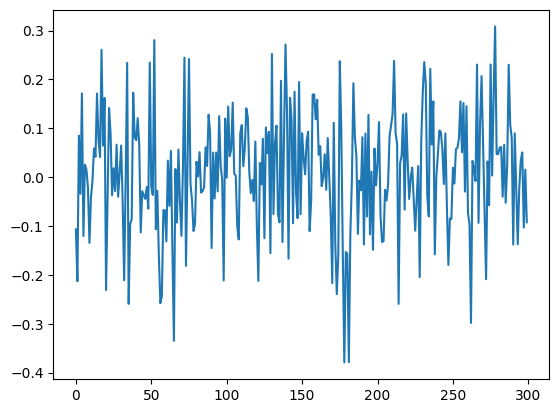

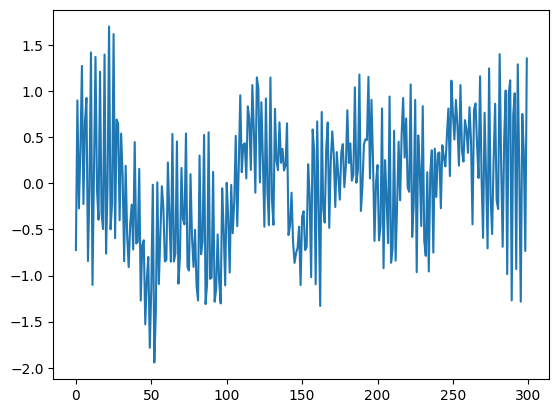

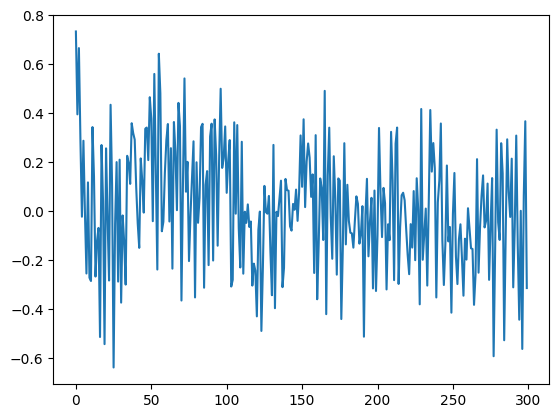

CMI: 0.059541232259011326
CMI: 0.2157224937026476
Highest CMI score: 0.2157224937026476
Adding original feature: 4
CMI: 0.00013559322033898646
Highest CMI score: 0.00013559322033898646
Adding original feature: 3
Highest CMI score: -0.00016540554327185153
[4, 3]
CMI: 0.059541232259011326
CMI: 0.2157224937026476
CMI: 0.3021695659495071
Highest CMI score: 0.3021695659495071
Adding original feature: 5
CMI: 0.005381412064058455
Highest CMI score: 0.005381412064058455
Adding original feature: 4
CMI: 0.0003114530067992449
Highest CMI score: 0.0003114530067992449
Adding original feature: 2
Highest CMI score: 0.0
[5, 4, 2]
CMI: 0.005381412064058455
Highest CMI score: 0.005381412064058455
Adding original feature: 4
CMI: 0.0003114530067992449
Highest CMI score: 0.0003114530067992449
Adding original feature: 2
Highest CMI score: 0.0
[4, 2]





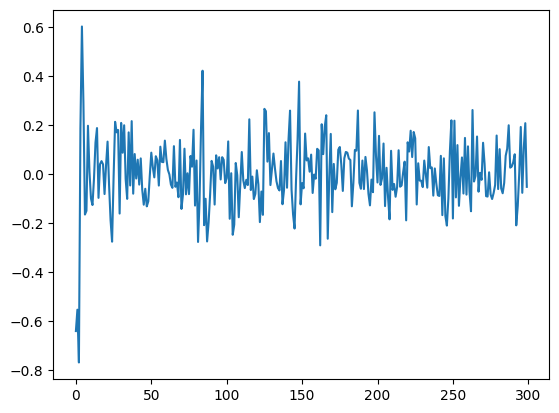

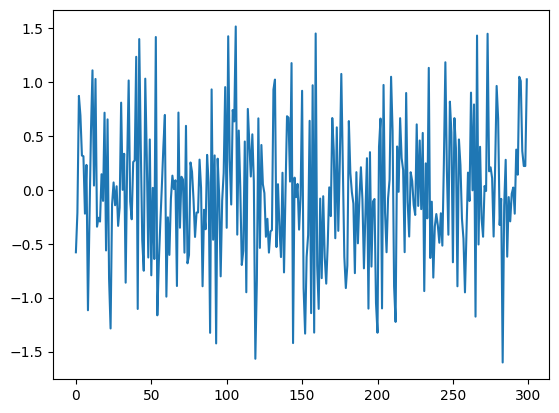

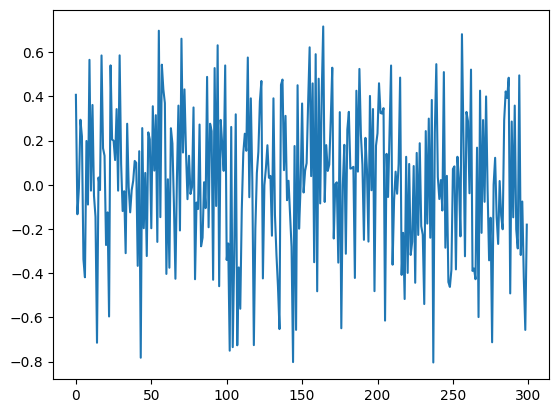

CMI: 0.027646962326424492
CMI: 0.16582617492322363
CMI: 0.16221348056060494
Highest CMI score: 0.16582617492322363
Adding original feature: 1
CMI: 0.00029758171911231646
CMI: 0.015085936854958848
Highest CMI score: 0.015085936854958848
Adding original feature: 4
Highest CMI score: 0.0
[1, 4]
CMI: 0.027646962326424492
CMI: 0.16582617492322363
CMI: 0.16221348056060494
Highest CMI score: 0.16582617492322363
Adding original feature: 1
CMI: 0.00029758171911231646
CMI: 0.015085936854958848
Highest CMI score: 0.015085936854958848
Adding original feature: 4
Highest CMI score: 0.0
[1, 4]
CMI: 0.025994159727547272
CMI: 0.09547923364697929
CMI: 0.0015262494380044493
CMI: 0.0011016992439763585
CMI: 0.09853573996038907
Highest CMI score: 0.09853573996038907
Adding original feature: 4
CMI: 0.028712116145418826
Highest CMI score: 0.028712116145418826
Adding original feature: 1
CMI: 0.0009746262959007823
Highest CMI score: 0.0009746262959007823
Adding original feature: 2
Highest CMI score: 0.0
[4, 1, 

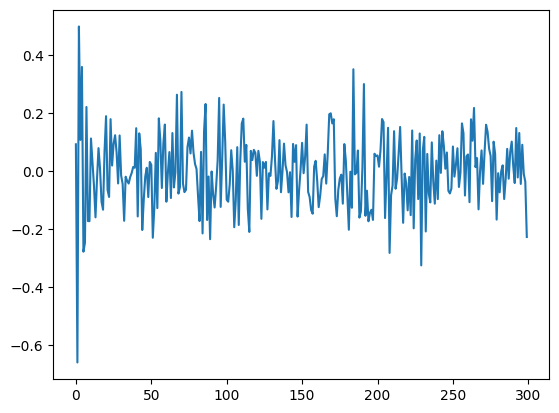

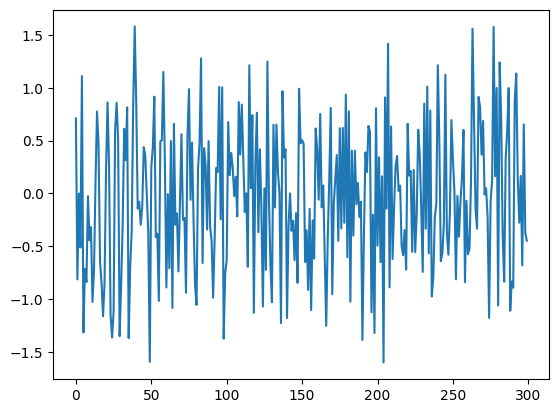

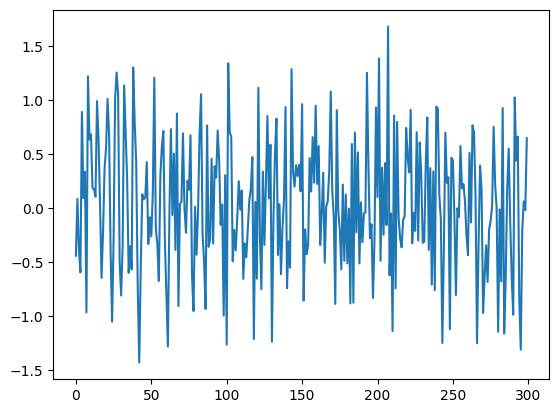

CMI: 0.008000729213514291
CMI: 0.042512072155820244
CMI: 0.027485166051255807
CMI: 0.0034389717593582116
CMI: 0.2514401654004372
Highest CMI score: 0.2514401654004372
Adding original feature: 4
Highest CMI score: -0.0004530355260710661
[4]
CMI: 0.008000729213514291
CMI: 0.042512072155820244
CMI: 0.027485166051255807
CMI: 0.0034389717593582116
CMI: 0.2514401654004372
CMI: 0.06731055449987387
Highest CMI score: 0.2514401654004372
Adding original feature: 4
Highest CMI score: -0.0004530355260710661
[4]
CMI: 0.005663737525955753
CMI: 0.00013037809647978293
CMI: 0.09692481021541337
Highest CMI score: 0.09692481021541337
Adding original feature: 4
Highest CMI score: 0.0
[4]





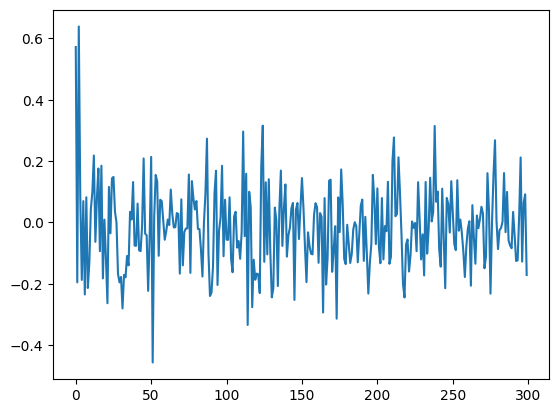

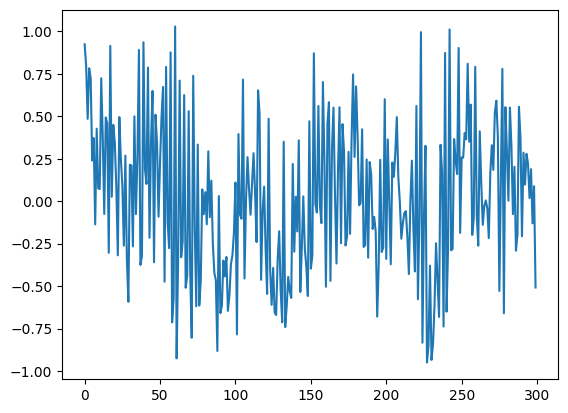

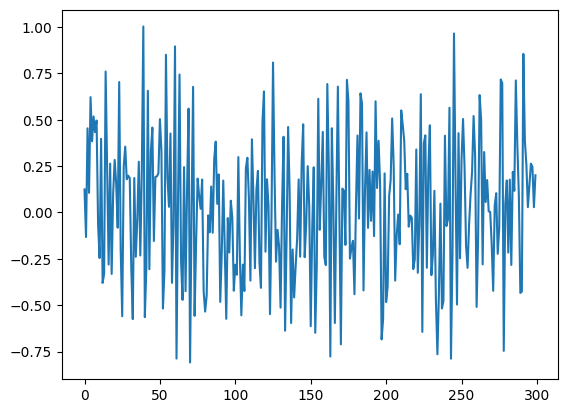

CMI: 0.0006805884295219449
CMI: 0.17906008718842217
CMI: 0.0690116612212337
CMI: 0.04489094834989684
Highest CMI score: 0.17906008718842217
Adding original feature: 1
Highest CMI score: -0.000426028987291438
[1]
CMI: 0.0006805884295219449
CMI: 0.17906008718842217
CMI: 0.0690116612212337
CMI: 0.04489094834989684
CMI: 0.1415503825383896
Highest CMI score: 0.17906008718842217
Adding original feature: 1
Highest CMI score: -0.000426028987291438
[1]
CMI: 0.006056781590626337
CMI: 0.0019322626226593864
Highest CMI score: 0.006056781590626337
Adding original feature: 1
Highest CMI score: 0.0
[1]





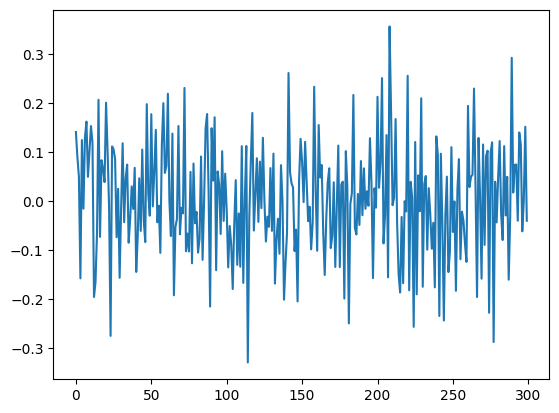

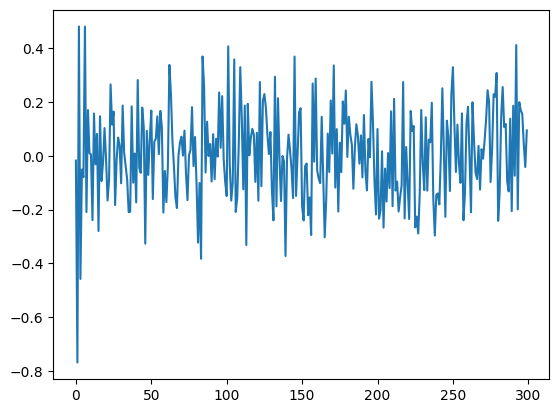

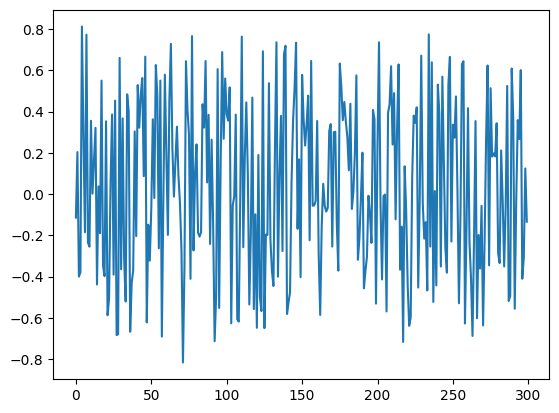

CMI: 0.0005553558729903916
CMI: 0.0002580517720155689
CMI: 0.0017591291415177152
Highest CMI score: 0.0017591291415177152
Adding original feature: 4
Highest CMI score: 0.0
[4]
CMI: 0.0005553558729903916
CMI: 0.0002580517720155689
CMI: 0.0017591291415177152
CMI: 0.016828794261207706
Highest CMI score: 0.016828794261207706
Adding original feature: 5
Highest CMI score: -0.012571798224344097
[5]
Highest CMI score: 0.0
[]





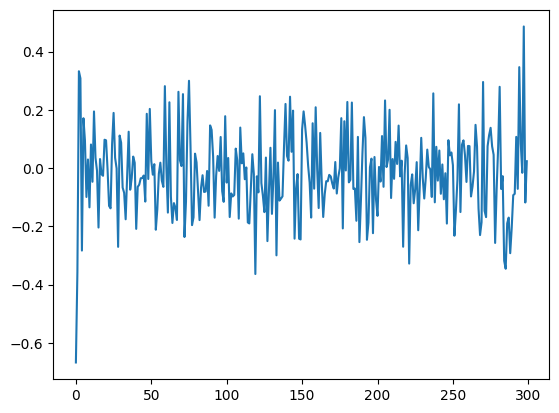

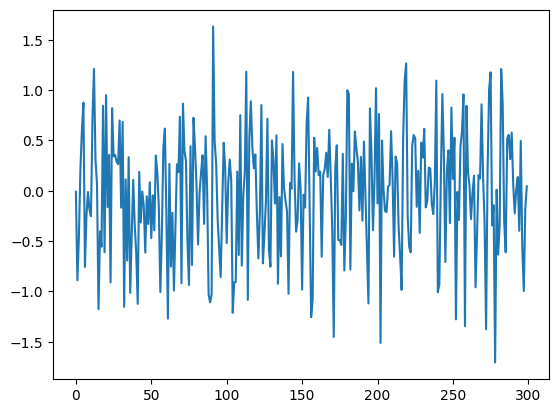

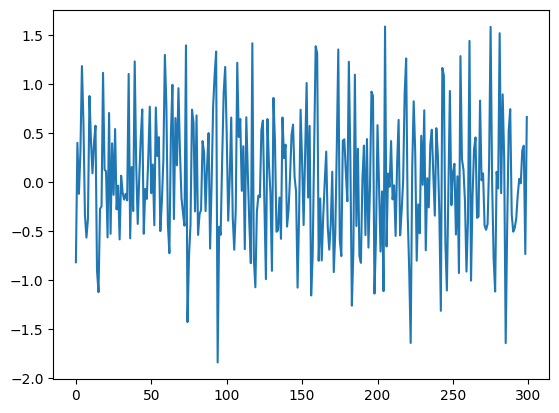

CMI: 0.09662432411617228
CMI: 0.18370544673141181
Highest CMI score: 0.18370544673141181
Adding original feature: 4
CMI: 0.00024010985100741955
Highest CMI score: 0.00024010985100741955
Adding original feature: 3
Highest CMI score: -0.02561117018081102
[4, 3]
CMI: 0.09662432411617228
CMI: 0.18370544673141181
CMI: 0.012079142281861589
Highest CMI score: 0.18370544673141181
Adding original feature: 4
CMI: 0.00024010985100741955
Highest CMI score: 0.00024010985100741955
Adding original feature: 3
Highest CMI score: -0.02561117018081102
[4, 3]
CMI: 0.0479471795009639
CMI: 0.00017758711140992978
CMI: 0.09875386007182671
Highest CMI score: 0.09875386007182671
Adding original feature: 4
CMI: 0.0007530708697086885
Highest CMI score: 0.0007530708697086885
Adding original feature: 1
Highest CMI score: 0.0
[4, 1]





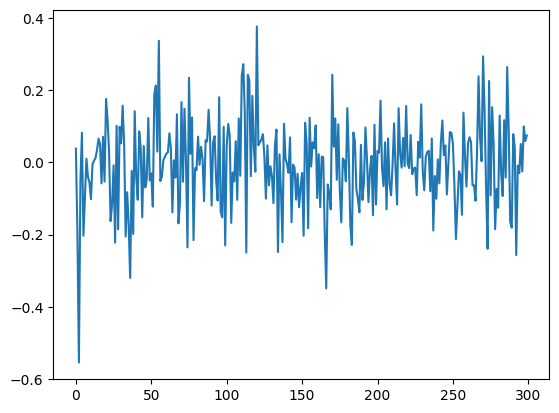

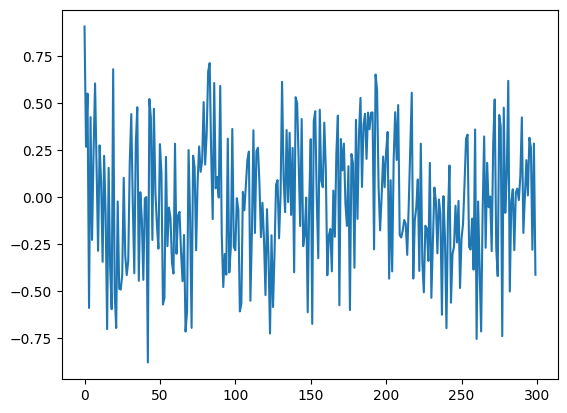

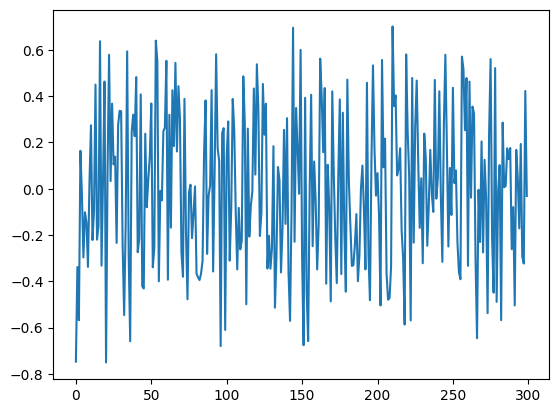

CMI: 0.004914186463849021
CMI: 0.15802854729263027
CMI: 0.03861840965611154
CMI: 0.001432036711851308
CMI: 0.0007802359547270383
Highest CMI score: 0.15802854729263027
Adding original feature: 1
Highest CMI score: -0.0003607442170614761
[1]
CMI: 0.004914186463849021
CMI: 0.15802854729263027
CMI: 0.03861840965611154
CMI: 0.001432036711851308
CMI: 0.0007802359547270383
CMI: 0.02943332314814904
Highest CMI score: 0.15802854729263027
Adding original feature: 1
Highest CMI score: -0.0003607442170614761
[1]
CMI: 0.09450000789723922
CMI: 0.005632316378036715
Highest CMI score: 0.09450000789723922
Adding original feature: 1
Highest CMI score: 0.0
[1]





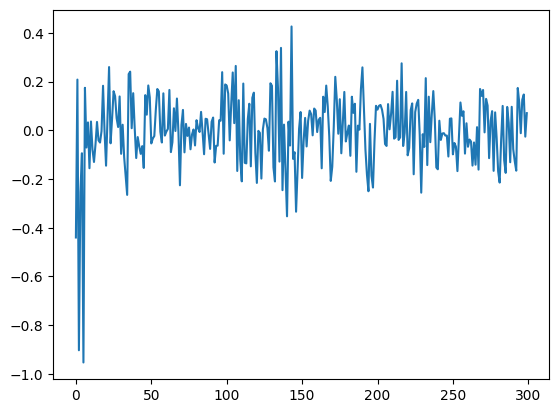

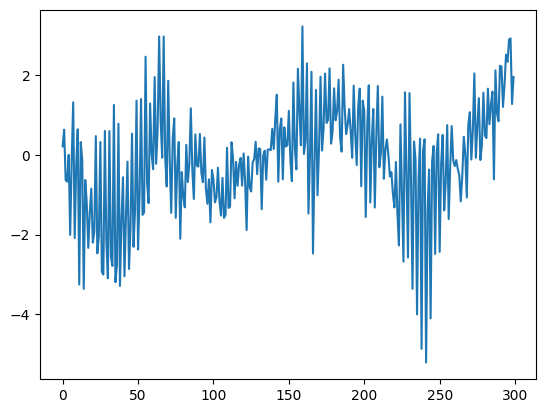

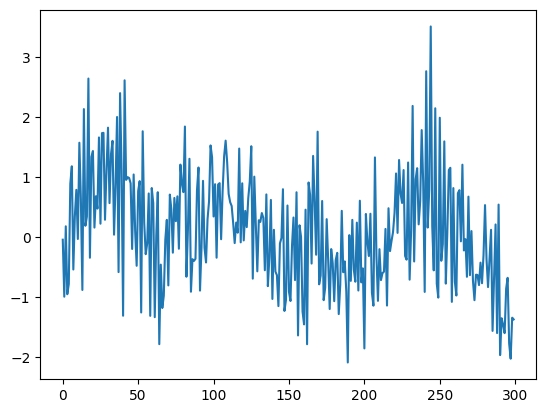

CMI: 0.03307862991883765
CMI: 0.16419081961513984
CMI: 0.010269596152592611
CMI: 0.02405624809504571
Highest CMI score: 0.16419081961513984
Adding original feature: 2
CMI: 0.011874523241737656
CMI: 0.0005114938438459393
CMI: 0.006994576727291313
Highest CMI score: 0.011874523241737656
Adding original feature: 1
CMI: 0.0002135058370974774
Highest CMI score: 0.0002135058370974774
Adding original feature: 3
Highest CMI score: -0.006233195266269587
[2, 1, 3]
CMI: 0.03307862991883765
CMI: 0.16419081961513984
CMI: 0.010269596152592611
CMI: 0.02405624809504571
CMI: 0.40588898666719636
Highest CMI score: 0.40588898666719636
Adding original feature: 5
CMI: 0.0002581336450419025
Highest CMI score: 0.0002581336450419025
Adding original feature: 3
Highest CMI score: -0.007710031018229924
[5, 3]
CMI: 0.0002581336450419025
Highest CMI score: 0.0002581336450419025
Adding original feature: 3
Highest CMI score: 0.0
[3]





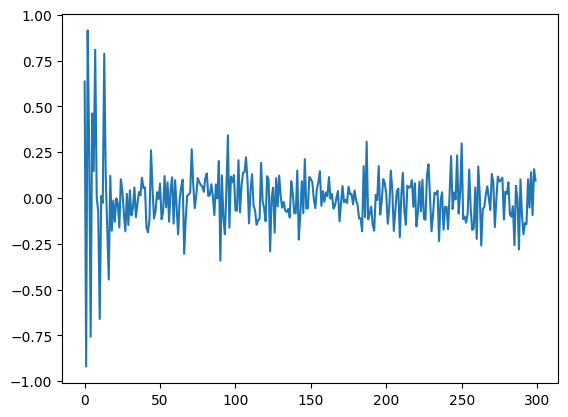

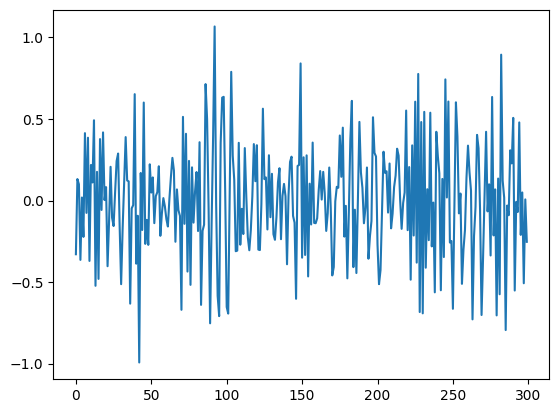

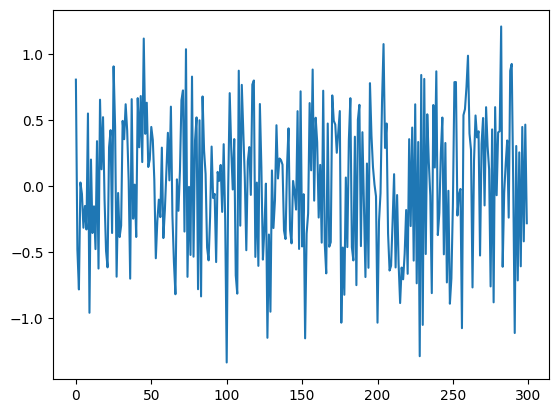

CMI: 0.0029505617808454152
CMI: 0.10040205726140441
CMI: 0.05730483197234982
CMI: 0.004731305042088656
CMI: 0.007187816328219772
Highest CMI score: 0.10040205726140441
Adding original feature: 1
Highest CMI score: -0.0046055758411562425
[1]
CMI: 0.0029505617808454152
CMI: 0.10040205726140441
CMI: 0.05730483197234982
CMI: 0.004731305042088656
CMI: 0.007187816328219772
CMI: 0.1853409955650396
Highest CMI score: 0.1853409955650396
Adding original feature: 5
Highest CMI score: -0.016385987708006033
[5]
Highest CMI score: 0.0
[]





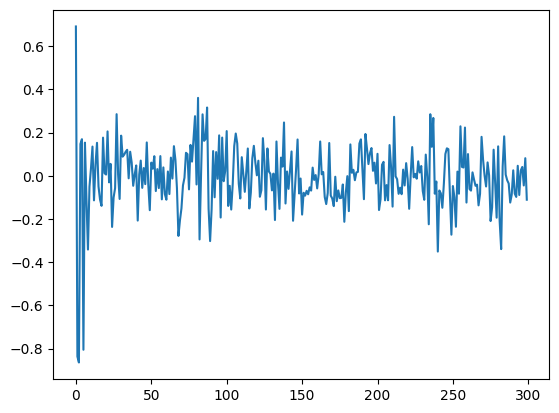

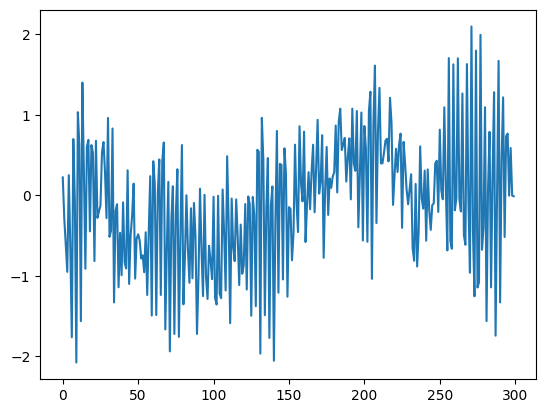

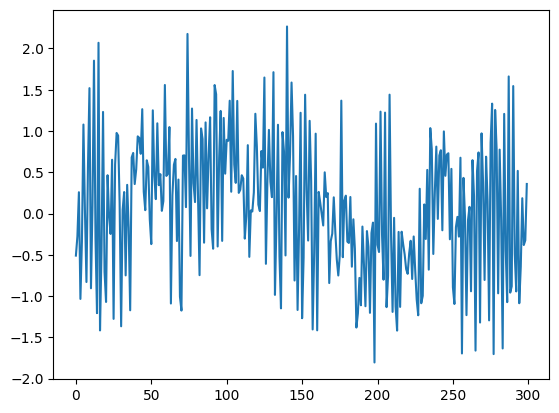

CMI: 0.0022680975815237417
CMI: 0.1222859712316263
CMI: 0.010799084632234241
CMI: 0.1057213095319766
Highest CMI score: 0.1222859712316263
Adding original feature: 2
CMI: 0.0023442274355237602
CMI: 0.012260800797597643
Highest CMI score: 0.012260800797597643
Adding original feature: 4
Highest CMI score: 0.0
[2, 4]
CMI: 0.0022680975815237417
CMI: 0.1222859712316263
CMI: 0.010799084632234241
CMI: 0.1057213095319766
CMI: 0.33940430272505867
Highest CMI score: 0.33940430272505867
Adding original feature: 5
Highest CMI score: -0.0006866534499579968
[5]
Highest CMI score: 0.0
[]





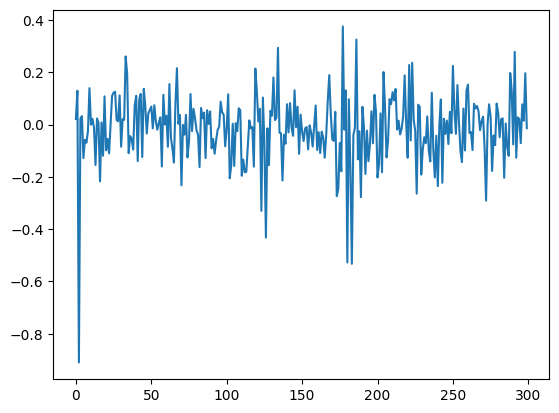

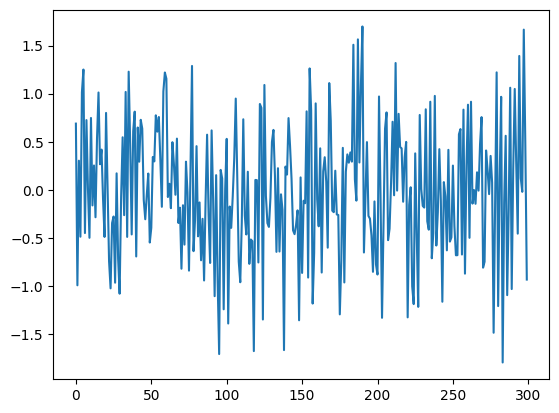

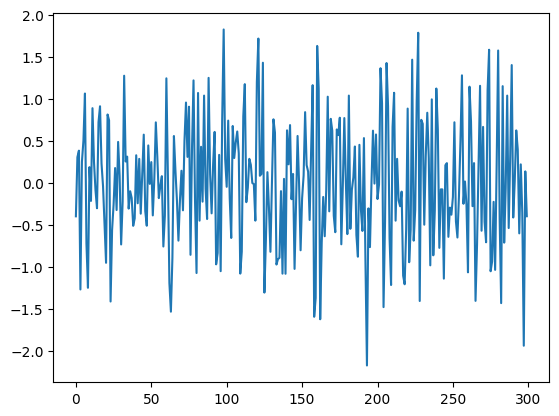

CMI: 0.10509703170471203
CMI: 0.005688815061331003
CMI: 0.17850585661379498
Highest CMI score: 0.17850585661379498
Adding original feature: 4
Highest CMI score: -0.003823767706964659
[4]
CMI: 0.10509703170471203
CMI: 0.005688815061331003
CMI: 0.17850585661379498
CMI: 0.028250656236619678
Highest CMI score: 0.17850585661379498
Adding original feature: 4
Highest CMI score: -0.003823767706964659
[4]
CMI: 0.06392876597507177
CMI: 0.09069918518792172
Highest CMI score: 0.09069918518792172
Adding original feature: 4
CMI: 0.01660097532391938
Highest CMI score: 0.01660097532391938
Adding original feature: 1
Highest CMI score: 0.0
[4, 1]





In [9]:
for seed in range(20):   
    rng = np.random.default_rng(seed=seed)
    random.seed(seed)
    np.random.seed(seed)
    
    x0 = rng.uniform(-1,1,size=300)
    x1 = rng.uniform(-1,1,size=300)
    x4 = rng.uniform(-1,1,size=300)
    
    x3 = list(rng.uniform(-1,1,size=3))
    for i in range(300 - 3):
        next_val = x3[-3]*rng.uniform(-1,1) + np.random.randn() * 0.1
        x3.append(next_val)
    plt.plot(x3)
    plt.show()
    
    
    y = list(rng.uniform(-1,1,size=4))
    c = [rng.uniform(-1,1),rng.uniform(-1,1),rng.uniform(-1,1)]
    for i in range(300 - 4):
        next_val = y[-3]*c[0] + x1[i+2]*c[1] + x4[i]*c[2] + np.random.randn() * 0.1
        y.append(next_val)
    plt.plot(y)
    plt.show()
    
    x2 = list(rng.uniform(-1,1,size=3))
    d = [rng.uniform(-1,1),rng.uniform(-1,1)]
    for i in range(300 - 3):
        next_val = y[i]*d[0] + x1[i]*d[1] + np.random.randn() * 0.1
        x2.append(next_val)
    plt.plot(x2)
    plt.show()
    
    x = np.concatenate((np.array(x0).reshape(-1,1),np.array(x1).reshape(-1,1),np.array(x2).reshape(-1,1),np.array(x3).reshape(-1,1),np.array(x4).reshape(-1,1)),axis=1)
    y = np.array(y)
    
    res = {
            "delta" : [], # list with all deltas
            "numSelected" : [], #
            "selectedFeatures" : [] 
        #    "accuracy" : [] # list of scores associated with the reduced problem
        }
    
    sel = forwardFeatureSelection(threshold=100,features=x,target=y,res=res,k=20, nproc=1, tau=5)
    print(sel)
    
    res = {
            "delta" : [], # list with all deltas
            "numSelected" : [], #
            "selectedFeatures" : [] 
        #    "accuracy" : [] # list of scores associated with the reduced problem
        }
    
    sel = forwardFeatureSelection(threshold=100,features=np.concatenate((x,y.reshape(-1,1)),axis=1),target=y,res=res,k=20, nproc=1, tau=5)
    print(sel)
    
    res = {
            "delta" : [], # list with all deltas
            "numSelected" : [], #
            "selectedFeatures" : [] 
        #    "accuracy" : [] # list of scores associated with the reduced problem
        }
    
    sel = TE_forwardFeatureSelection(threshold=100,features=np.concatenate((x,y.reshape(-1,1)),axis=1),target=y,res=res,k=20, nproc=1, tau=5)
    print(sel)
    print('\n\n')



# 5 features

## Single experiment

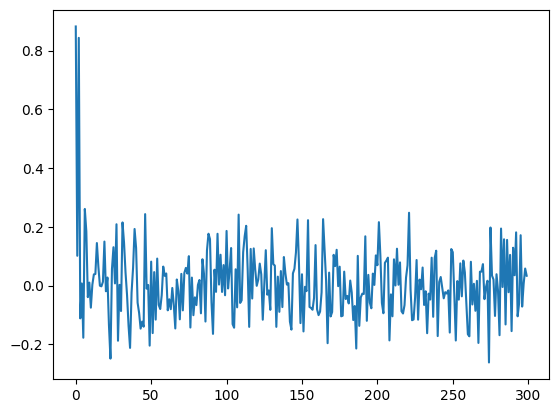

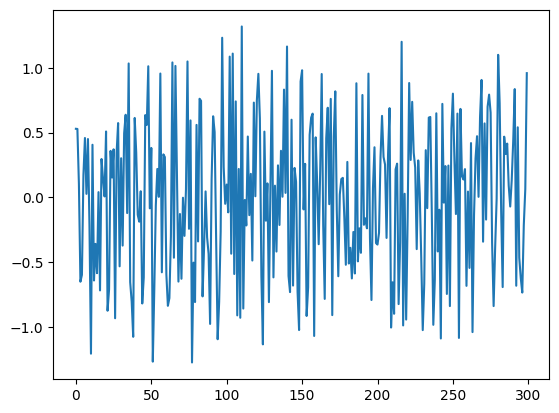

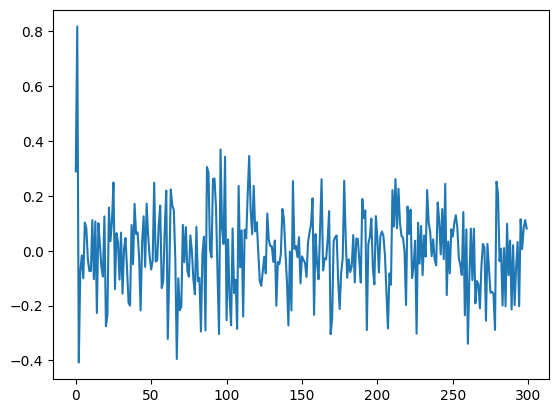

CMI: 0.03293848009151939
CMI: 0.005407929948942541
CMI: 0.010021645936980007
CMI: 0.3261259467462351
Highest CMI score: 0.3261259467462351
Adding original feature: 4
Highest CMI score: -0.0013204808542224278
[4]
CMI: 0.03293848009151939
CMI: 0.005407929948942541
CMI: 0.010021645936980007
CMI: 0.3261259467462351
CMI: 0.006362615211307253
Highest CMI score: 0.3261259467462351
Adding original feature: 4
Highest CMI score: -0.0013204808542224278
[4]
CMI: 0.014818767834799058
CMI: 0.16332831656633529
Highest CMI score: 0.16332831656633529
Adding original feature: 4
Highest CMI score: 0.0
[4]





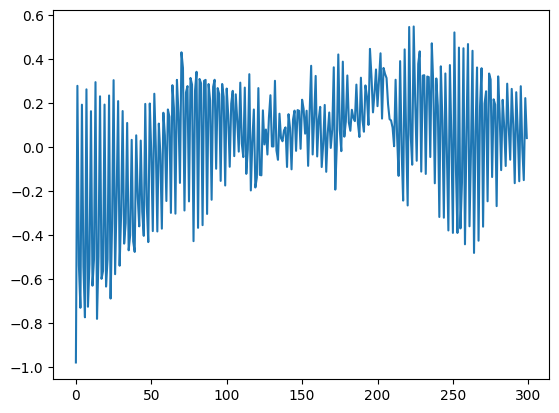

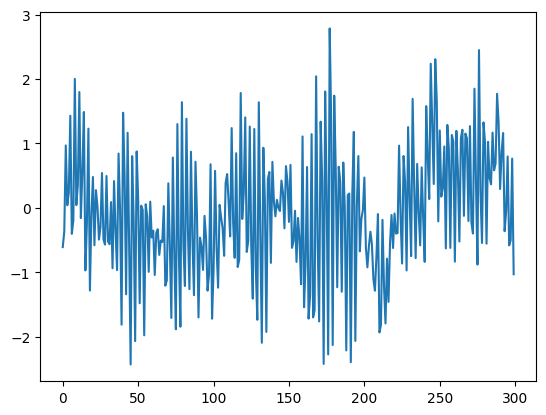

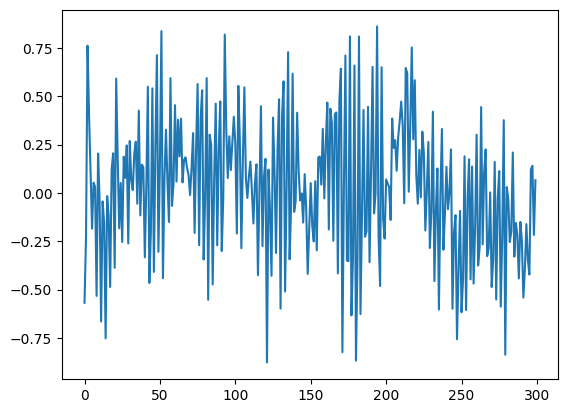

CMI: 0.01636531877003429
CMI: 0.1790646668098122
CMI: 0.06712541612686891
CMI: 0.10071566210482114
Highest CMI score: 0.1790646668098122
Adding original feature: 2
CMI: 0.0026340045242024546
Highest CMI score: 0.0026340045242024546
Adding original feature: 3
Highest CMI score: -0.05429134535914751
[2, 3]
CMI: 0.01636531877003429
CMI: 0.1790646668098122
CMI: 0.06712541612686891
CMI: 0.10071566210482114
CMI: 0.3660352147780809
Highest CMI score: 0.3660352147780809
Adding original feature: 5
CMI: 6.609638590893141e-05
Highest CMI score: 6.609638590893141e-05
Adding original feature: 3
Highest CMI score: -0.001923982376332234
[5, 3]
CMI: 6.609638590893141e-05
Highest CMI score: 6.609638590893141e-05
Adding original feature: 3
Highest CMI score: 0.0
[3]





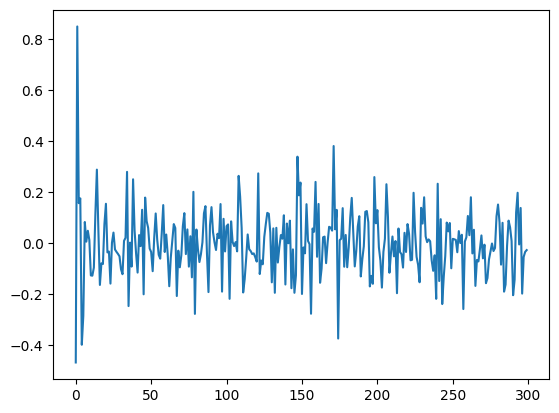

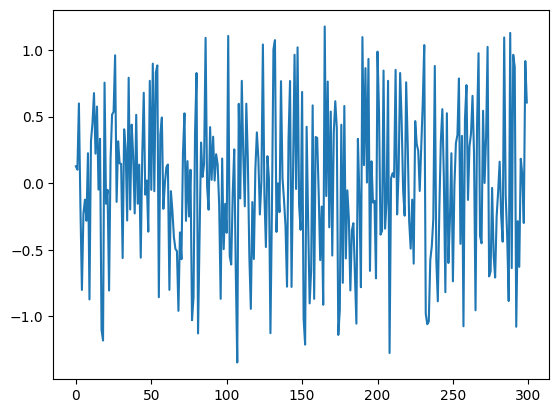

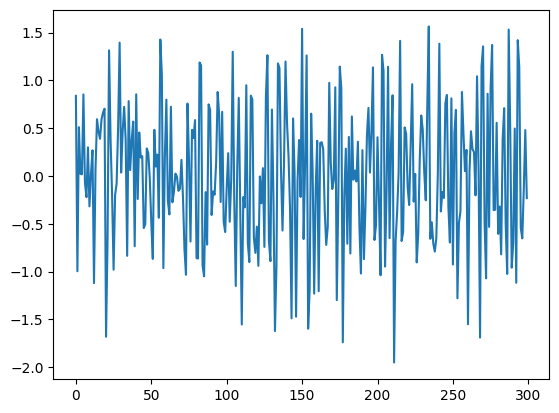

CMI: 0.16139189971809997
CMI: 0.0033429257849307177
CMI: 0.016931020451002674
CMI: 0.1603243890482322
Highest CMI score: 0.16139189971809997
Adding original feature: 1
CMI: 0.02203332733081148
Highest CMI score: 0.02203332733081148
Adding original feature: 4
Highest CMI score: -0.00019545056437683672
[1, 4]
CMI: 0.16139189971809997
CMI: 0.0033429257849307177
CMI: 0.016931020451002674
CMI: 0.1603243890482322
CMI: 0.0023352482779056844
Highest CMI score: 0.16139189971809997
Adding original feature: 1
CMI: 0.02203332733081148
Highest CMI score: 0.02203332733081148
Adding original feature: 4
Highest CMI score: -0.00019545056437683672
[1, 4]
CMI: 0.08568460336487826
CMI: 0.07521257022236456
Highest CMI score: 0.08568460336487826
Adding original feature: 1
CMI: 0.0004459755230880602
CMI: 0.03243855597648995
Highest CMI score: 0.03243855597648995
Adding original feature: 4
Highest CMI score: 0.0
[1, 4]





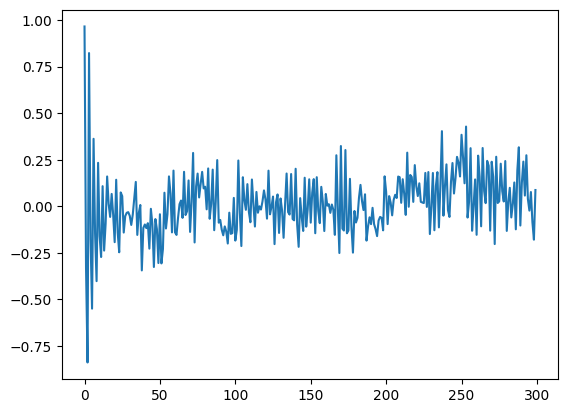

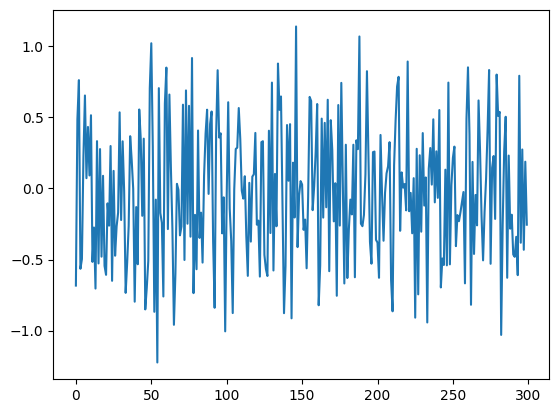

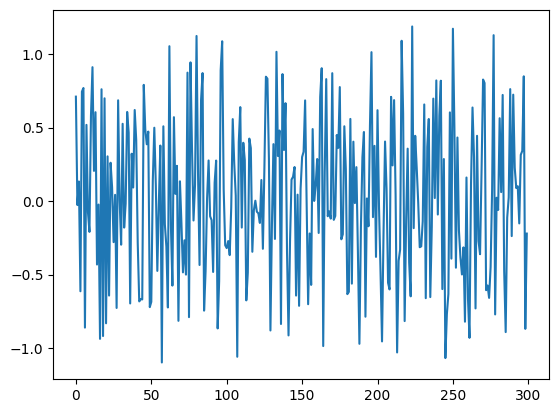

CMI: 0.0007535070038638444
CMI: 0.011836230155948542
CMI: 0.008255907446504755
CMI: 0.2644332505492922
Highest CMI score: 0.2644332505492922
Adding original feature: 4
Highest CMI score: -0.004908594966105129
[4]
CMI: 0.0007535070038638444
CMI: 0.011836230155948542
CMI: 0.008255907446504755
CMI: 0.2644332505492922
CMI: 0.03885790774550541
Highest CMI score: 0.2644332505492922
Adding original feature: 4
Highest CMI score: -0.004908594966105129
[4]
CMI: 0.13473174142204705
Highest CMI score: 0.13473174142204705
Adding original feature: 4
Highest CMI score: 0.0
[4]





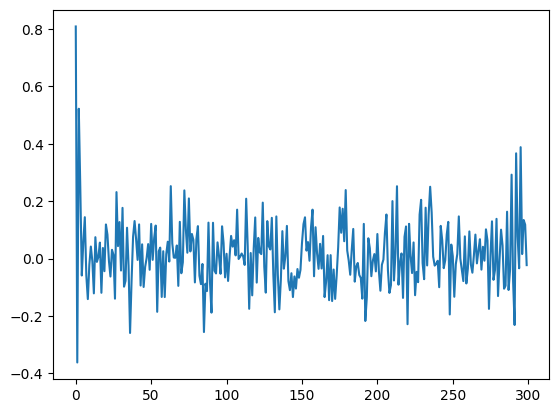

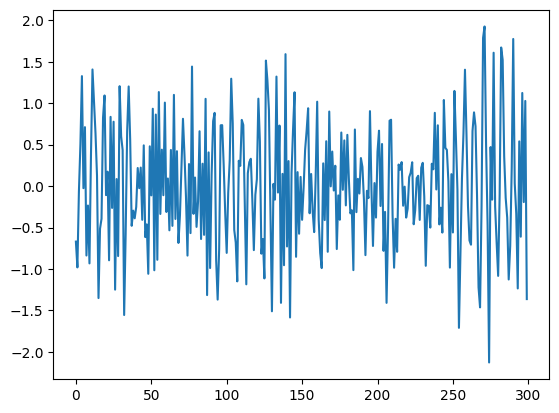

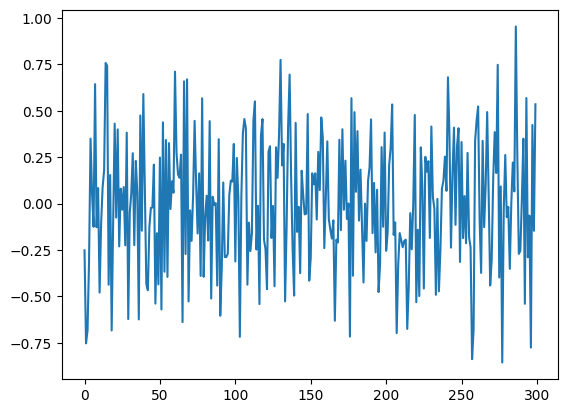

CMI: 0.17037386186263537
CMI: 0.042256277880554076
CMI: 0.08483202579967346
Highest CMI score: 0.17037386186263537
Adding original feature: 1
Highest CMI score: -9.11457073954347e-06
[1]
CMI: 0.17037386186263537
CMI: 0.042256277880554076
CMI: 0.08483202579967346
CMI: 0.1741513065186856
Highest CMI score: 0.1741513065186856
Adding original feature: 5
CMI: 0.026260416503546713
CMI: 6.406237585596108e-05
CMI: 0.00363646760490427
Highest CMI score: 0.026260416503546713
Adding original feature: 1
Highest CMI score: 0.0
[5, 1]
CMI: 0.026260416503546713
CMI: 6.406237585596108e-05
CMI: 0.00363646760490427
Highest CMI score: 0.026260416503546713
Adding original feature: 1
Highest CMI score: 0.0
[1]





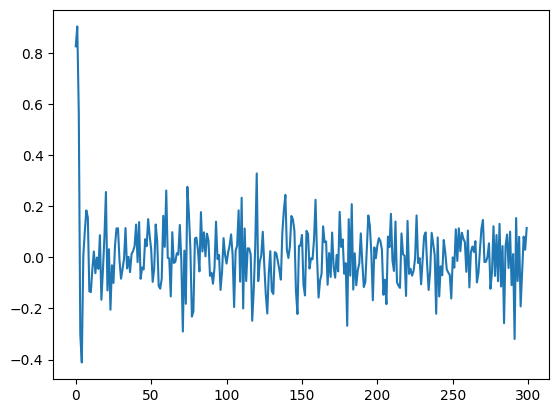

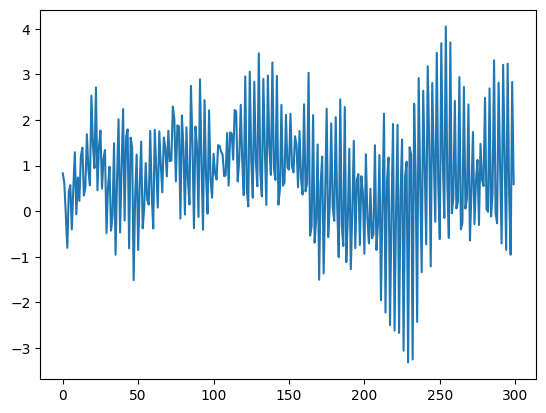

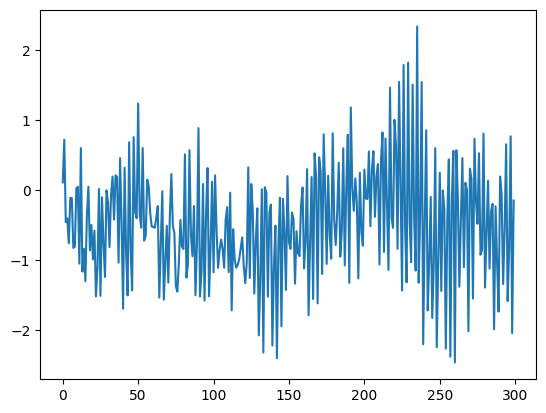

CMI: 0.012842984861617376
CMI: 0.314497803855624
CMI: 0.008925855592596598
CMI: 0.018146784926612734
Highest CMI score: 0.314497803855624
Adding original feature: 2
CMI: 0.0008317434287318792
Highest CMI score: 0.0008317434287318792
Adding original feature: 3
Highest CMI score: -0.054771041744226145
[2, 3]
CMI: 0.012842984861617376
CMI: 0.314497803855624
CMI: 0.008925855592596598
CMI: 0.018146784926612734
CMI: 0.5320770939062254
Highest CMI score: 0.5320770939062254
Adding original feature: 5
Highest CMI score: 0.0
[5]
Highest CMI score: 0.0
[]





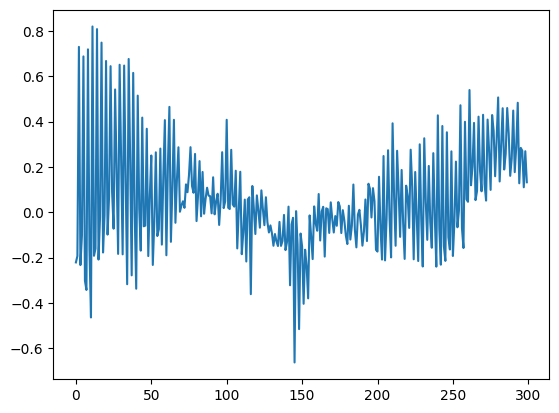

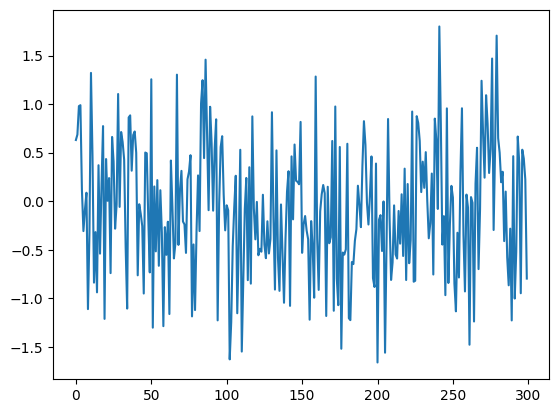

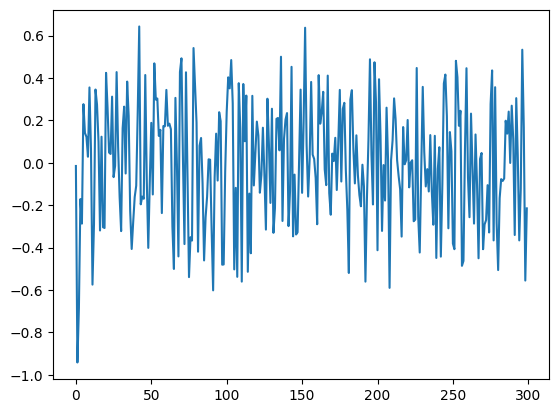

CMI: 0.22901801725827342
CMI: 0.015111839544807461
CMI: 0.013830623490955698
CMI: 0.11829644832692494
Highest CMI score: 0.22901801725827342
Adding original feature: 1
CMI: 0.004810409583373865
Highest CMI score: 0.004810409583373865
Adding original feature: 4
Highest CMI score: -0.0008946439193009137
[1, 4]
CMI: 0.22901801725827342
CMI: 0.015111839544807461
CMI: 0.013830623490955698
CMI: 0.11829644832692494
CMI: 0.021342371158489474
Highest CMI score: 0.22901801725827342
Adding original feature: 1
CMI: 0.004810409583373865
Highest CMI score: 0.004810409583373865
Adding original feature: 4
Highest CMI score: -0.0008946439193009137
[1, 4]
CMI: 0.11508113831000705
CMI: 0.0016299673168400017
CMI: 0.0021320510012025583
CMI: 0.0480905356267579
Highest CMI score: 0.11508113831000705
Adding original feature: 1
CMI: 0.0017659269373961617
CMI: 0.010229373737879355
Highest CMI score: 0.010229373737879355
Adding original feature: 4
Highest CMI score: 0.0
[1, 4]





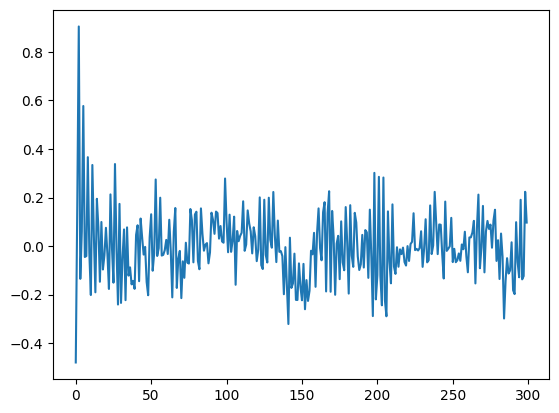

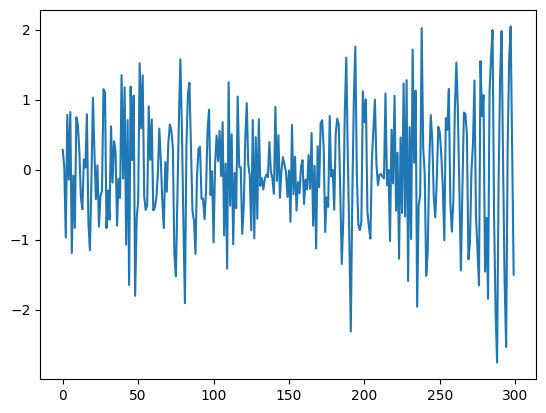

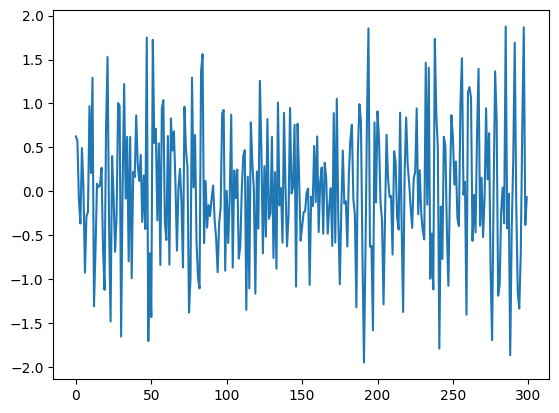

CMI: 0.0014506839656963416
CMI: 0.13241562510154184
CMI: 0.12239381732974587
CMI: 0.026795643619460446
Highest CMI score: 0.13241562510154184
Adding original feature: 1
CMI: 0.029154583118171318
CMI: 0.004058567461941054
Highest CMI score: 0.029154583118171318
Adding original feature: 2
CMI: 0.00012554424653818397
Highest CMI score: 0.00012554424653818397
Adding original feature: 3
Highest CMI score: -0.03201372430514354
[1, 2, 3]
CMI: 0.0014506839656963416
CMI: 0.13241562510154184
CMI: 0.12239381732974587
CMI: 0.026795643619460446
CMI: 0.29050227629295494
Highest CMI score: 0.29050227629295494
Adding original feature: 5
Highest CMI score: -0.001174851439792679
[5]
Highest CMI score: 0.0
[]





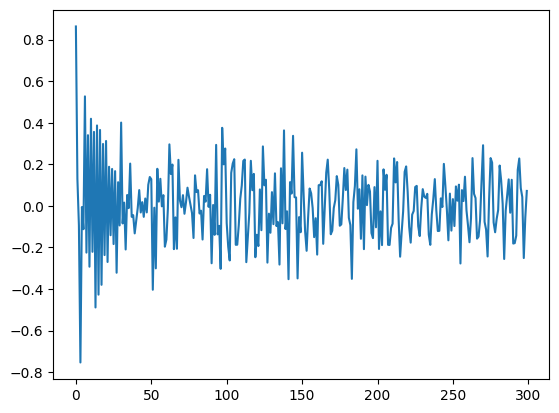

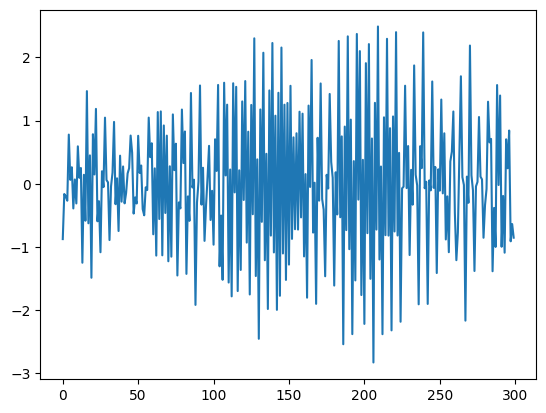

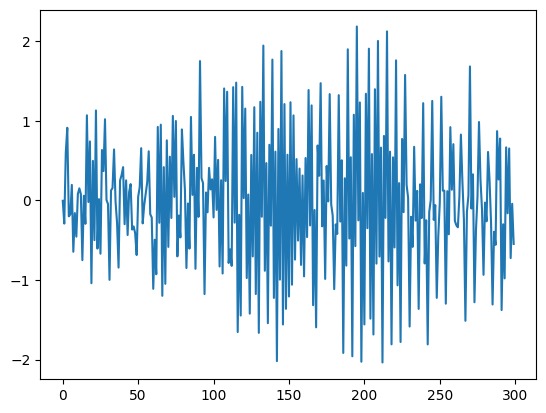

CMI: 0.008129419061414735
CMI: 0.00968856913617888
CMI: 0.48895077202788756
CMI: 0.016909858889122192
CMI: 0.07377954873611273
Highest CMI score: 0.48895077202788756
Adding original feature: 2
CMI: 0.001879789221800543
Highest CMI score: 0.001879789221800543
Adding original feature: 3
Highest CMI score: -0.07234012050662186
[2, 3]
CMI: 0.008129419061414735
CMI: 0.00968856913617888
CMI: 0.48895077202788756
CMI: 0.016909858889122192
CMI: 0.07377954873611273
CMI: 0.6347325476275828
Highest CMI score: 0.6347325476275828
Adding original feature: 5
Highest CMI score: -0.0019131986983349503
[5]
Highest CMI score: 0.0
[]





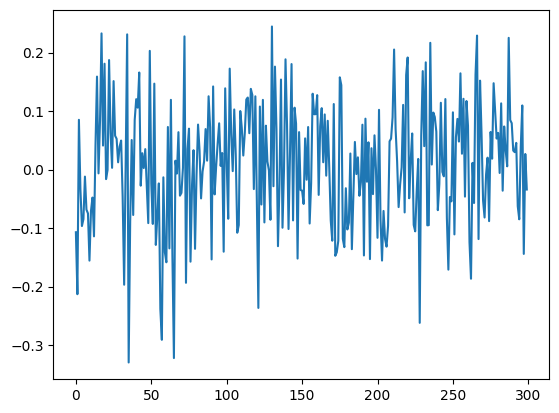

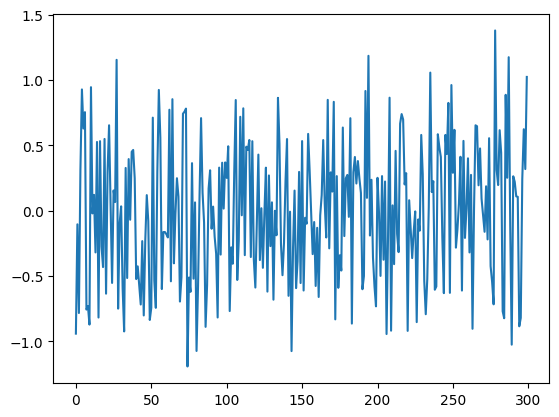

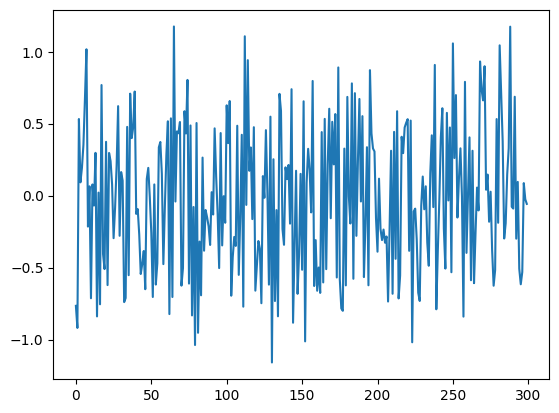

CMI: 0.004283457117029765
CMI: 0.2565751873061442
CMI: 0.006016923466467416
CMI: 0.001414853042818105
CMI: 0.09467495592571518
Highest CMI score: 0.2565751873061442
Adding original feature: 1
Highest CMI score: 0.0
[1]
CMI: 0.004283457117029765
CMI: 0.2565751873061442
CMI: 0.006016923466467416
CMI: 0.001414853042818105
CMI: 0.09467495592571518
CMI: 0.01945412775138383
Highest CMI score: 0.2565751873061442
Adding original feature: 1
Highest CMI score: 0.0
[1]
CMI: 0.1329668157511538
CMI: 0.052623218433594125
Highest CMI score: 0.1329668157511538
Adding original feature: 1
Highest CMI score: 0.0
[1]





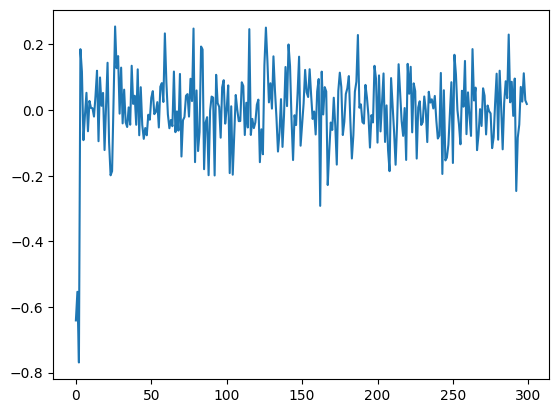

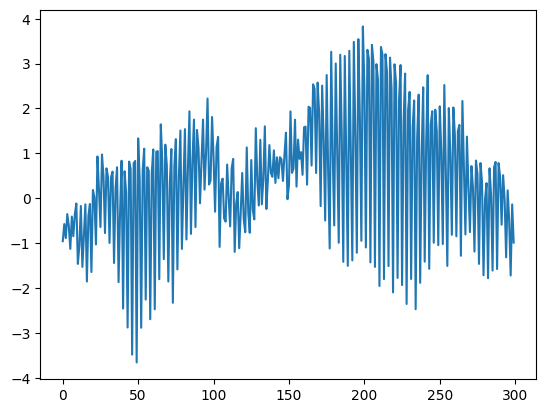

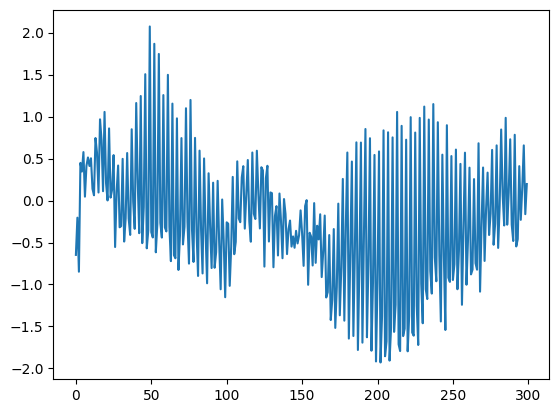

CMI: 0.007405478237392382
CMI: 0.5885994507709948
CMI: 0.046248135127838964
Highest CMI score: 0.5885994507709948
Adding original feature: 2
CMI: 0.0002452635206874332
Highest CMI score: 0.0002452635206874332
Adding original feature: 3
Highest CMI score: -0.14024004815908836
[2, 3]
CMI: 0.007405478237392382
CMI: 0.5885994507709948
CMI: 0.046248135127838964
CMI: 0.6322010801108616
Highest CMI score: 0.6322010801108616
Adding original feature: 5
Highest CMI score: 0.0
[5]
Highest CMI score: 0.0
[]





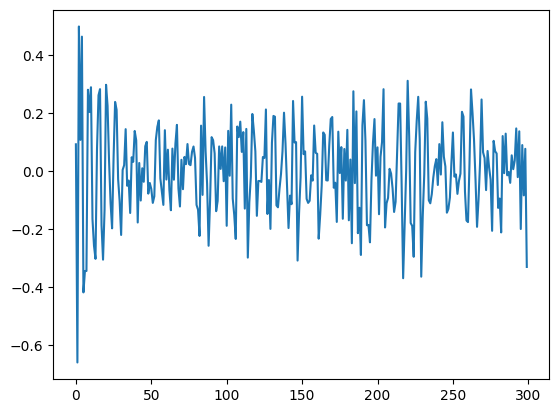

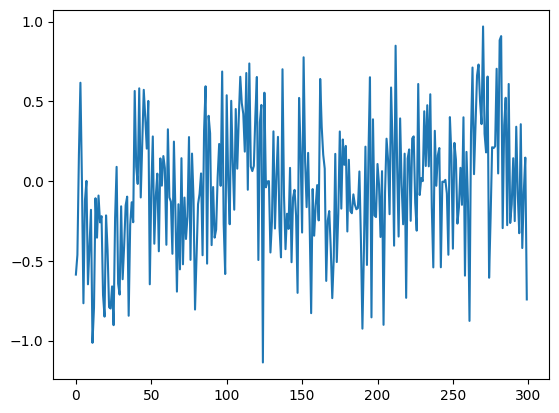

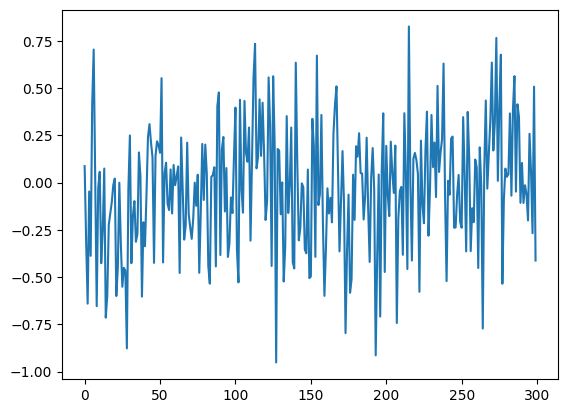

CMI: 0.12506292872102587
CMI: 0.03037325991080392
CMI: 0.009295926848225788
CMI: 0.0425786366125763
Highest CMI score: 0.12506292872102587
Adding original feature: 1
Highest CMI score: -6.996375707285507e-05
[1]
CMI: 0.12506292872102587
CMI: 0.03037325991080392
CMI: 0.009295926848225788
CMI: 0.0425786366125763
CMI: 0.06338319913333287
Highest CMI score: 0.12506292872102587
Adding original feature: 1
Highest CMI score: -6.996375707285507e-05
[1]
CMI: 0.037581488855983156
CMI: 0.0041082610917273915
Highest CMI score: 0.037581488855983156
Adding original feature: 1
CMI: 2.9326972090848447e-05
Highest CMI score: 2.9326972090848447e-05
Adding original feature: 3
Highest CMI score: 0.0
[1, 3]





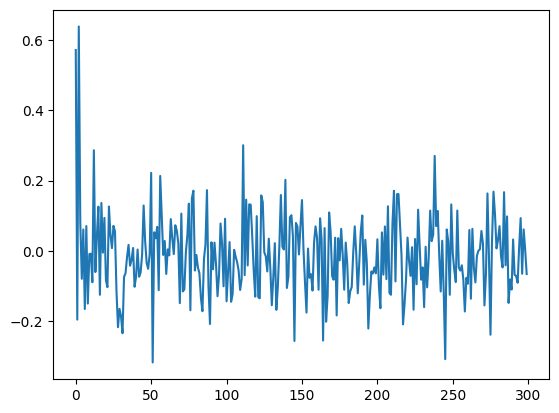

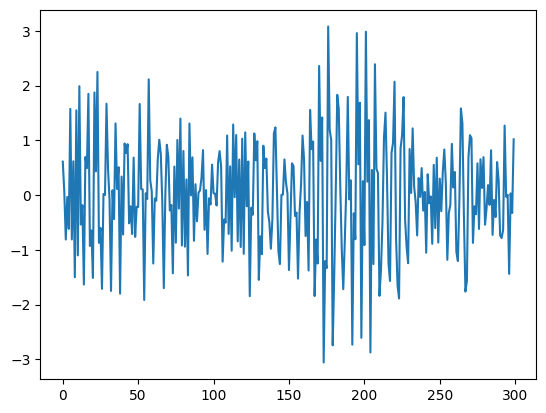

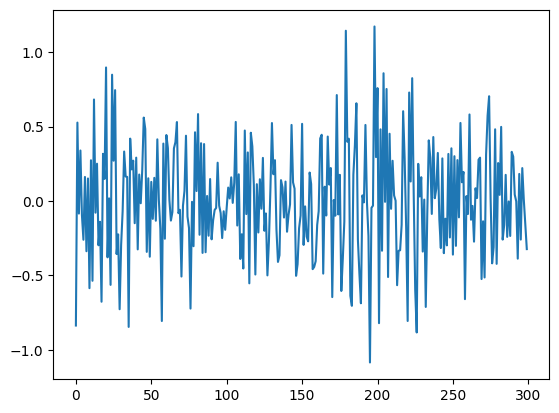

CMI: 0.060127759518365444
CMI: 0.14683420780817785
CMI: 0.024648091469684594
Highest CMI score: 0.14683420780817785
Adding original feature: 2
CMI: 0.002895910922339595
Highest CMI score: 0.002895910922339595
Adding original feature: 3
Highest CMI score: -0.05801235022100329
[2, 3]
CMI: 0.060127759518365444
CMI: 0.14683420780817785
CMI: 0.024648091469684594
CMI: 0.348862868090189
Highest CMI score: 0.348862868090189
Adding original feature: 5
CMI: 0.00014124293785311437
Highest CMI score: 0.00014124293785311437
Adding original feature: 3
Highest CMI score: -0.00018906935715051754
[5, 3]
CMI: 0.00014124293785311437
Highest CMI score: 0.00014124293785311437
Adding original feature: 3
Highest CMI score: 0.0
[3]





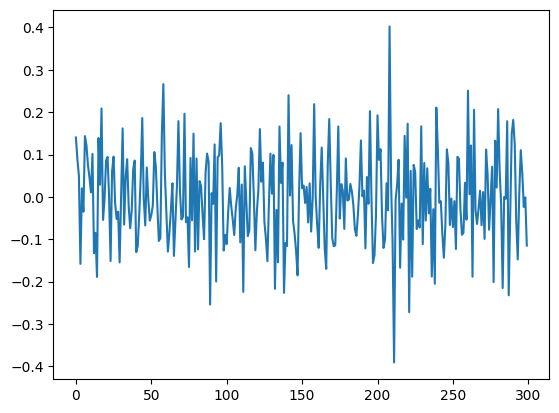

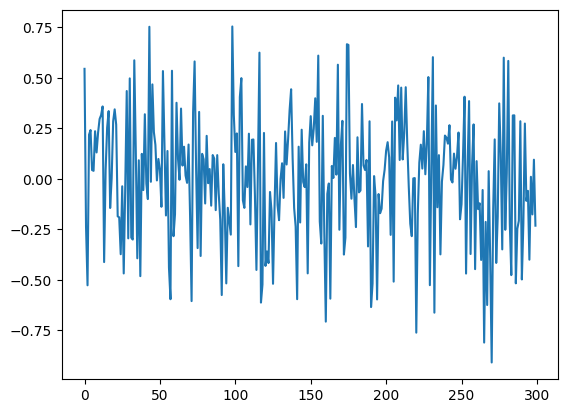

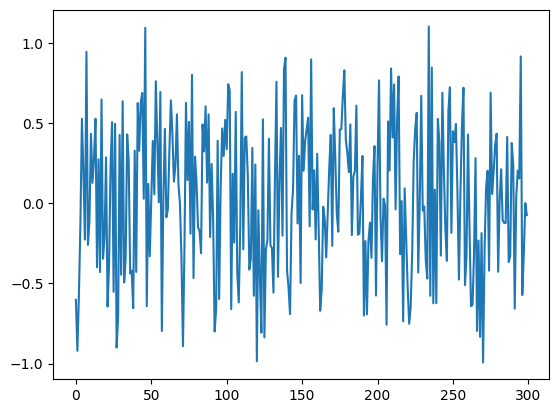

CMI: 0.05077521595321955
CMI: 0.006317777203214166
CMI: 0.08394086947949084
Highest CMI score: 0.08394086947949084
Adding original feature: 4
Highest CMI score: -9.111638212572215e-05
[4]
CMI: 0.05077521595321955
CMI: 0.006317777203214166
CMI: 0.08394086947949084
CMI: 0.032362055296684726
Highest CMI score: 0.08394086947949084
Adding original feature: 4
Highest CMI score: -9.111638212572215e-05
[4]
CMI: 0.009500876552926384
CMI: 0.03271337052946846
Highest CMI score: 0.03271337052946846
Adding original feature: 4
Highest CMI score: 0.0
[4]





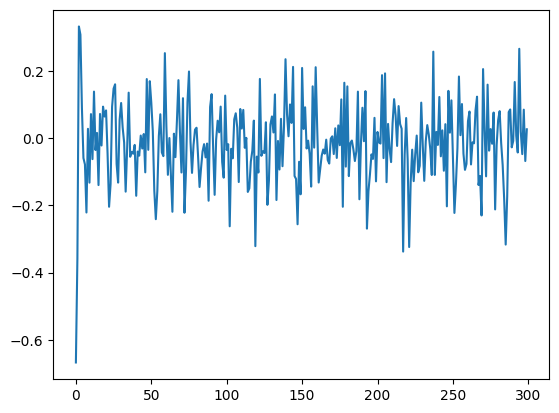

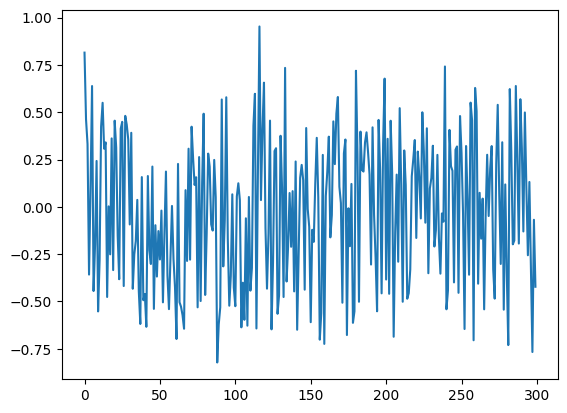

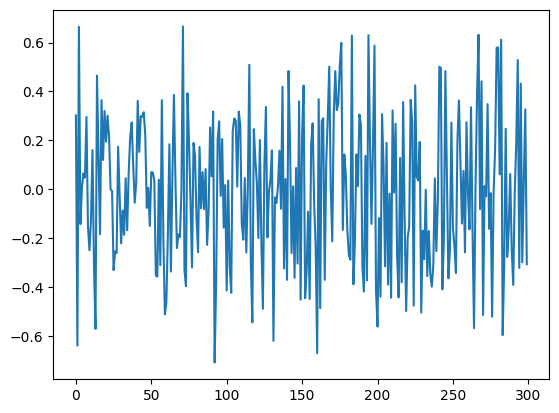

CMI: 0.00485016317937618
CMI: 0.011073087295836616
CMI: 0.030540170056165983
CMI: 0.0011196067719479784
CMI: 0.19869790573626733
Highest CMI score: 0.19869790573626733
Adding original feature: 4
Highest CMI score: -0.0009085601658488929
[4]
CMI: 0.00485016317937618
CMI: 0.011073087295836616
CMI: 0.030540170056165983
CMI: 0.0011196067719479784
CMI: 0.19869790573626733
CMI: 0.023568832651505525
Highest CMI score: 0.19869790573626733
Adding original feature: 4
Highest CMI score: -0.0009085601658488929
[4]
CMI: 0.000623314457605554
CMI: 0.0009592088471700178
CMI: 0.09530263501032224
Highest CMI score: 0.09530263501032224
Adding original feature: 4
Highest CMI score: 0.0
[4]





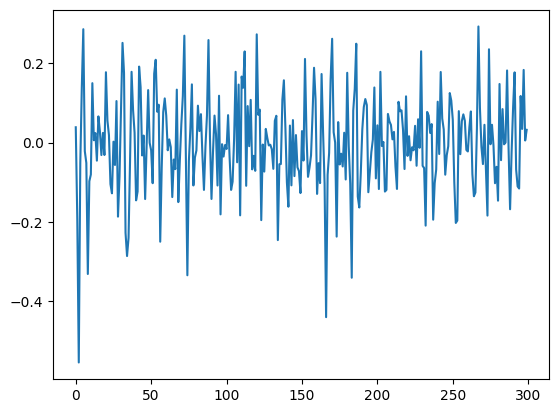

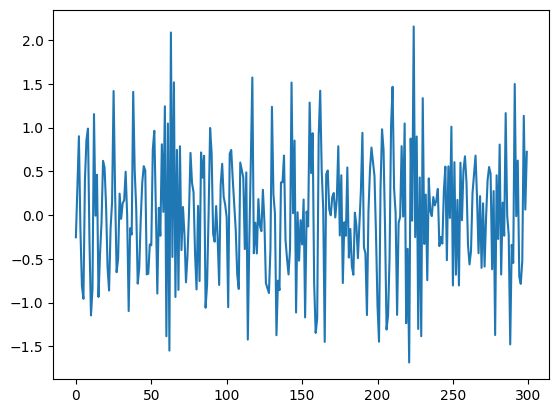

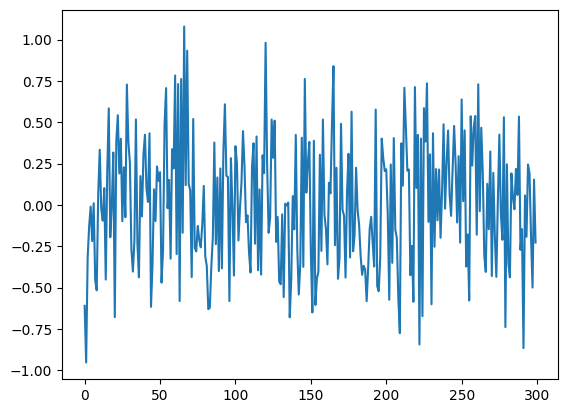

CMI: 0.01544918577987054
CMI: 0.09458433739046762
CMI: 0.04578771077414665
CMI: 0.11079103155006968
Highest CMI score: 0.11079103155006968
Adding original feature: 4
CMI: 0.011720010593610941
CMI: 0.006529469957376952
CMI: 0.00016714780970308873
Highest CMI score: 0.011720010593610941
Adding original feature: 1
CMI: 0.0014871923535622472
Highest CMI score: 0.0014871923535622472
Adding original feature: 2
Highest CMI score: 0.0
[4, 1, 2]
CMI: 0.01544918577987054
CMI: 0.09458433739046762
CMI: 0.04578771077414665
CMI: 0.11079103155006968
CMI: 0.17540987300206323
Highest CMI score: 0.17540987300206323
Adding original feature: 5
CMI: 0.0076864510622786375
Highest CMI score: 0.0076864510622786375
Adding original feature: 4
Highest CMI score: 0.0
[5, 4]
CMI: 0.0076864510622786375
Highest CMI score: 0.0076864510622786375
Adding original feature: 4
Highest CMI score: 0.0
[4]





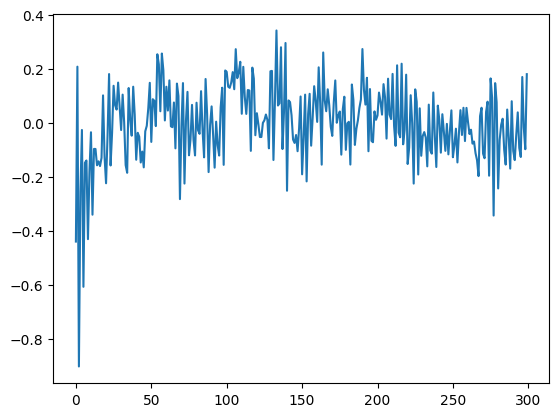

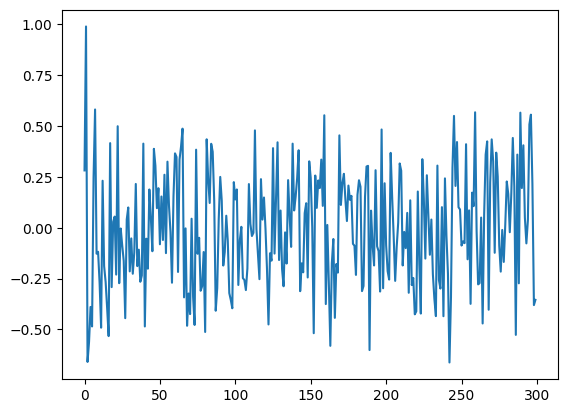

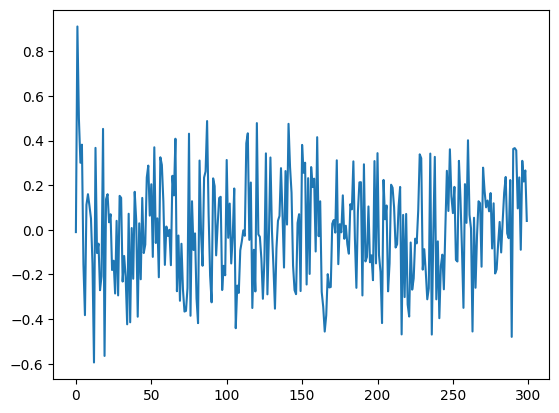

CMI: 0.005592985040954056
CMI: 0.04716395508636429
CMI: 0.019231661811063686
CMI: 0.024030068860424757
Highest CMI score: 0.04716395508636429
Adding original feature: 1
Highest CMI score: -0.001272490207259426
[1]
CMI: 0.005592985040954056
CMI: 0.04716395508636429
CMI: 0.019231661811063686
CMI: 0.024030068860424757
CMI: 0.009457913996553546
Highest CMI score: 0.04716395508636429
Adding original feature: 1
Highest CMI score: -0.001272490207259426
[1]
CMI: 0.030248178353424384
CMI: 0.0093313293874079
CMI: 0.00742777965982809
Highest CMI score: 0.030248178353424384
Adding original feature: 1
Highest CMI score: 0.0
[1]





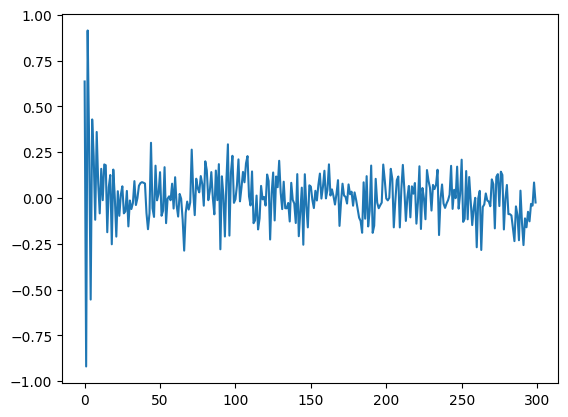

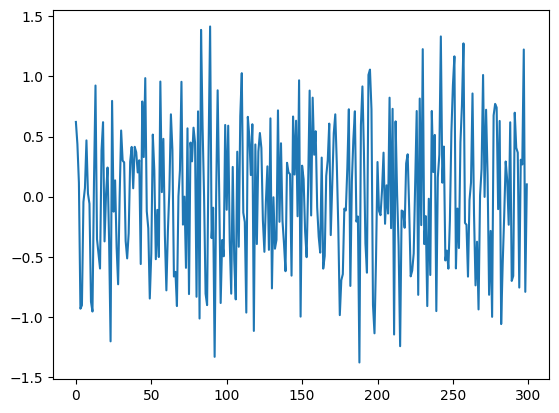

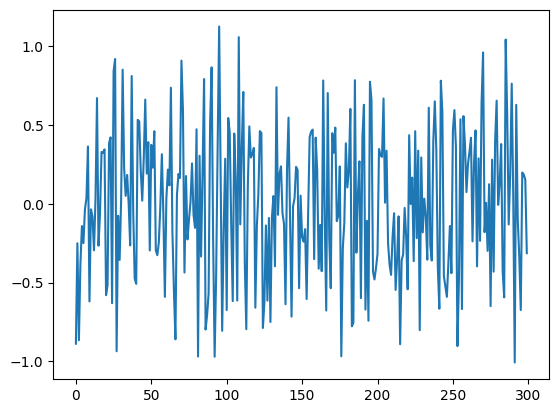

CMI: 0.01458268480134121
CMI: 0.10141332593755956
CMI: 0.010330685149127345
CMI: 0.015792638513370833
CMI: 0.21584845828469218
Highest CMI score: 0.21584845828469218
Adding original feature: 4
CMI: 0.0001147490692009756
Highest CMI score: 0.0001147490692009756
Adding original feature: 3
Highest CMI score: -0.05345745922560022
[4, 3]
CMI: 0.01458268480134121
CMI: 0.10141332593755956
CMI: 0.010330685149127345
CMI: 0.015792638513370833
CMI: 0.21584845828469218
CMI: 0.06031209730664261
Highest CMI score: 0.21584845828469218
Adding original feature: 4
CMI: 0.0001147490692009756
Highest CMI score: 0.0001147490692009756
Adding original feature: 3
Highest CMI score: -0.04493445030260204
[4, 3]
CMI: 0.026611408564939036
CMI: 0.11115049610193853
Highest CMI score: 0.11115049610193853
Adding original feature: 4
Highest CMI score: 0.0
[4]





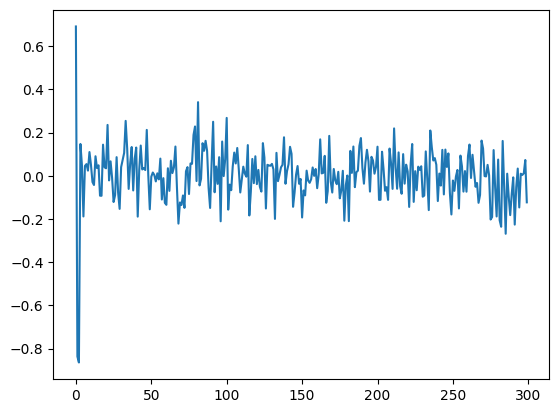

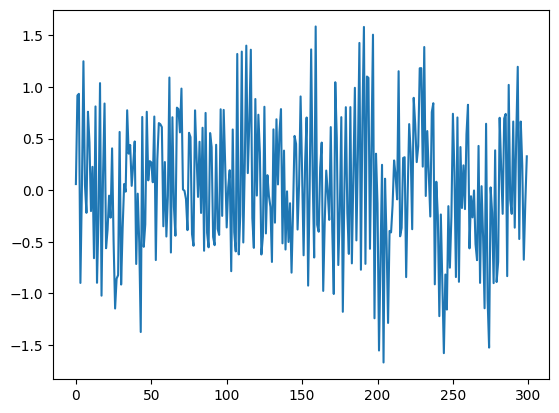

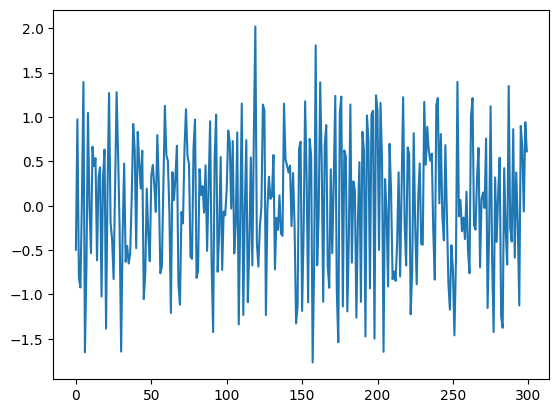

CMI: 0.003475073627964313
CMI: 0.4341083194864696
CMI: 0.04716748265391518
CMI: 0.01227661431096122
Highest CMI score: 0.4341083194864696
Adding original feature: 1
Highest CMI score: -0.0012131415990014327
[1]
CMI: 0.003475073627964313
CMI: 0.4341083194864696
CMI: 0.04716748265391518
CMI: 0.01227661431096122
CMI: 0.07731900894534612
Highest CMI score: 0.4341083194864696
Adding original feature: 1
Highest CMI score: -0.0012131415990014327
[1]
CMI: 0.19926832998647792
CMI: 0.0006806005599369336
Highest CMI score: 0.19926832998647792
Adding original feature: 1
CMI: 9.135970440554697e-06
Highest CMI score: 9.135970440554697e-06
Adding original feature: 3
Highest CMI score: 0.0
[1, 3]





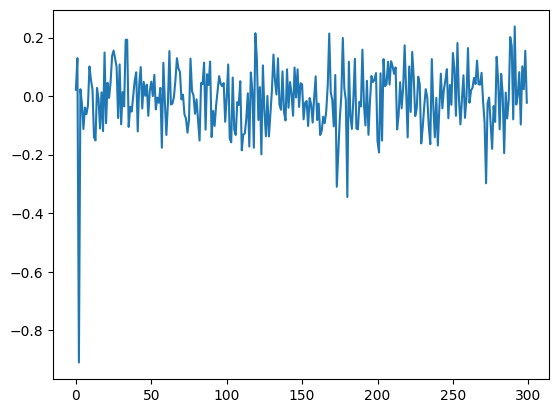

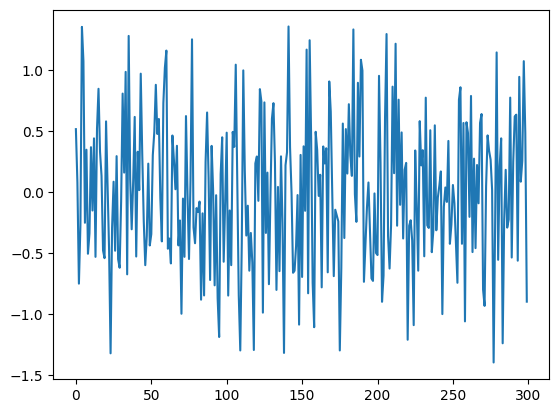

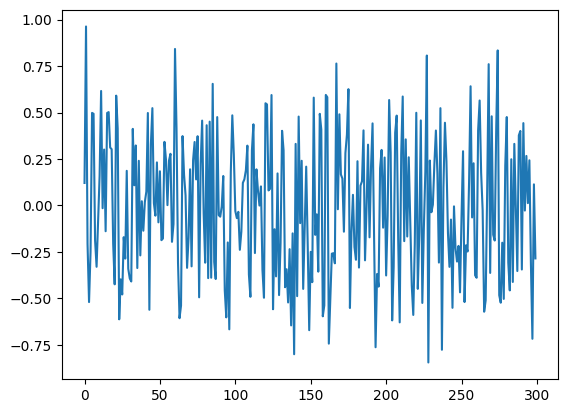

CMI: 0.09925082936758578
CMI: 0.015399550379222485
CMI: 0.2071143896498802
Highest CMI score: 0.2071143896498802
Adding original feature: 4
Highest CMI score: -0.001631359679844513
[4]
CMI: 0.09925082936758578
CMI: 0.015399550379222485
CMI: 0.2071143896498802
Highest CMI score: 0.2071143896498802
Adding original feature: 4
Highest CMI score: -0.001631359679844513
[4]
CMI: 0.059611374172674536
CMI: 0.0002840273798530111
CMI: 0.12010089174577598
Highest CMI score: 0.12010089174577598
Adding original feature: 4
CMI: 0.010159569040313288
Highest CMI score: 0.010159569040313288
Adding original feature: 1
Highest CMI score: 0.0
[4, 1]





In [8]:
for seed in range(20):   
    rng = np.random.default_rng(seed=seed)
    random.seed(seed)
    np.random.seed(seed)
    
    x0 = rng.uniform(-1,1,size=300)
    x1 = rng.uniform(-1,1,size=300)
    x4 = rng.uniform(-1,1,size=300)
    
    x3 = list(rng.uniform(-1,1,size=3))
    b = rng.uniform(-1,1)
    for i in range(300 - 3):
        next_val = x3[-3]*b + np.random.randn() * 0.1
        x3.append(next_val)
    plt.plot(x3)
    plt.show()
    
    
    y = list(rng.uniform(-1,1,size=4))
    c = [rng.uniform(-1,1),rng.uniform(-1,1),rng.uniform(-1,1)]
    for i in range(300 - 4):
        next_val = y[-3]*c[0] + x1[i+2]*c[1] + x4[i]*c[2] + np.random.randn() * 0.1
        y.append(next_val)
    plt.plot(y)
    plt.show()
    
    x2 = list(rng.uniform(-1,1,size=3))
    d = [rng.uniform(-1,1),rng.uniform(-1,1)]
    for i in range(300 - 3):
        next_val = y[i]*d[0] + x1[i]*d[1] + np.random.randn() * 0.1
        x2.append(next_val)
    plt.plot(x2)
    plt.show()
    
    x = np.concatenate((np.array(x0).reshape(-1,1),np.array(x1).reshape(-1,1),np.array(x2).reshape(-1,1),np.array(x3).reshape(-1,1),np.array(x4).reshape(-1,1)),axis=1)
    y = np.array(y)
    
    res = {
            "delta" : [], # list with all deltas
            "numSelected" : [], #
            "selectedFeatures" : [] 
        #    "accuracy" : [] # list of scores associated with the reduced problem
        }
    
    sel = forwardFeatureSelection(threshold=100,features=x,target=y,res=res,k=20, nproc=1, tau=5)
    print(sel)
    
    res = {
            "delta" : [], # list with all deltas
            "numSelected" : [], #
            "selectedFeatures" : [] 
        #    "accuracy" : [] # list of scores associated with the reduced problem
        }
    
    sel = forwardFeatureSelection(threshold=100,features=np.concatenate((x,y.reshape(-1,1)),axis=1),target=y,res=res,k=20, nproc=1, tau=5)
    print(sel)
    
    res = {
            "delta" : [], # list with all deltas
            "numSelected" : [], #
            "selectedFeatures" : [] 
        #    "accuracy" : [] # list of scores associated with the reduced problem
        }
    
    sel = TE_forwardFeatureSelection(threshold=100,features=np.concatenate((x,y.reshape(-1,1)),axis=1),target=y,res=res,k=20, nproc=1, tau=5)
    print(sel)
    print('\n\n')



In [4]:
c

[-0.5033595869272502, 0.629847468243419, -0.8104943059600407]

In [5]:
d

[-0.9842724036796888, 0.3890581103919799]

In [13]:
from sklearn.linear_model import LinearRegression
x4 = np.array(x4)
y = np.array(y)
reg_x = LinearRegression().fit(x4[:196].reshape(-1,1), y[4:200].reshape(-1,1))
reg_x.score(x4[200:-4].reshape(-1,1), y[204:].reshape(-1,1))


0.42495624153465694

In [14]:
from sklearn.linear_model import LinearRegression
x1 = np.array(x1)
y = np.array(y)
reg_x = LinearRegression().fit(x1[:198].reshape(-1,1), y[2:200].reshape(-1,1))
reg_x.score(x1[200:-2].reshape(-1,1), y[202:].reshape(-1,1))


0.2317413990284457

In [15]:
from sklearn.linear_model import LinearRegression
x3 = np.array(x3)
y = np.array(y)
reg_x = LinearRegression().fit(x3[:198].reshape(-1,1), y[2:200].reshape(-1,1))
reg_x.score(x3[200:-2].reshape(-1,1), y[202:].reshape(-1,1))


-0.030306777438649624

# Linear

In [6]:
correct_CMI_forward = 0
correct_CMIwithTar_forward = 0
correct_TE_forward = 0
tot_links = 0

for i in [2]:
    x_start,x_end,x_lag,x_coeff,y_start,y_lag,y_coeff,x,y =  generate_dataset(n_data=3000, n_variables=5, tau=5, n_xx=4, n_xy=2, n_yy=1, n_yx=3, seed=i)
    
    correct_links = set(y_start)
    
    ### forward CMI FS
    res = {
            "delta" : [], # list with all deltas
            "numSelected" : [], #
            "selectedFeatures" : [] 
        #    "accuracy" : [] # list of scores associated with the reduced problem
        }
    
    sel = forwardFeatureSelection(threshold=100,features=x,target=y,res=res,k=20, nproc=1, tau=5)
    CMI_forward_selected = set(sel)
    
    ### forward CMI FS with past target as candidate feature
    res = {
            "delta" : [], # list with all deltas
            "numSelected" : [], #
            "selectedFeatures" : [] 
        #    "accuracy" : [] # list of scores associated with the reduced problem
        }
    
    sel = forwardFeatureSelection(threshold=100,features=np.concatenate((x,y.reshape(-1,1)),axis=1),target=y,res=res,k=20, nproc=1, tau=5)
    CMI_forwardWithTar_selected = set(sel)
    
    ### forward TE FS
    res = {
            "delta" : [], # list with all deltas
            "numSelected" : [], #
            "selectedFeatures" : [] 
        #    "accuracy" : [] # list of scores associated with the reduced problem
        }
    
    sel = TE_forwardFeatureSelection(threshold=100,features=np.concatenate((x,y.reshape(-1,1)),axis=1),target=y,res=res,k=20, nproc=1, tau=5)
    TE_forward_selected = set(sel)
    
    correct_CMI_forward += len([found for found in CMI_forward_selected if found in correct_links])
    correct_CMIwithTar_forward += len([found for found in CMI_forwardWithTar_selected if found in correct_links])
    correct_TE_forward += len([found for found in TE_forward_selected if found in correct_links])+1
    tot_links += len(correct_links)
    
    print(correct_links, CMI_forward_selected, CMI_forwardWithTar_selected, TE_forward_selected)

    print(x_start,'\n',x_end,'\n',x_lag,'\n',x_coeff,'\n',y_start,'\n',y_lag,'\n',y_coeff)
    print(correct_CMI_forward, correct_CMIwithTar_forward, correct_TE_forward, tot_links)
    print('\n\n')

    

CMI: 0.010080986812358588
CMI: 0.0031704092792239017
CMI: 0.005631678727909563
Highest CMI score: 0.010080986812358588
Adding original feature: 1
CMI: 5.191682417526877e-06
Highest CMI score: 5.191682417526877e-06
Adding original feature: 4
Highest CMI score: -0.0037528704445113914
CMI: 0.010080986812358588
CMI: 0.0031704092792239017
CMI: 0.005631678727909563
CMI: 0.005353880097142601
Highest CMI score: 0.010080986812358588
Adding original feature: 1
CMI: 5.191682417526877e-06
Highest CMI score: 5.191682417526877e-06
Adding original feature: 4
Highest CMI score: -0.0037528704445113914
CMI: 0.0027205612335577233
CMI: 0.003006302555574894
CMI: 0.0016025080671975703
Highest CMI score: 0.003006302555574894
Adding original feature: 3
Highest CMI score: 0.0
{2, 4, 5} {1, 4} {1, 4} {3}
[0, 0, 3, 2, 5, 5, 5] 
 [3, 0, 2, 1, 2, 4, 3] 
 [4, 4, 2, 4, 1, 1, 3] 
 [-0.04767757315013672, -0.04030177131717534, 0.06284514811885608, -0.08161681157298062, 0.0200201051931308, 0.045712105362358924, -0.06241

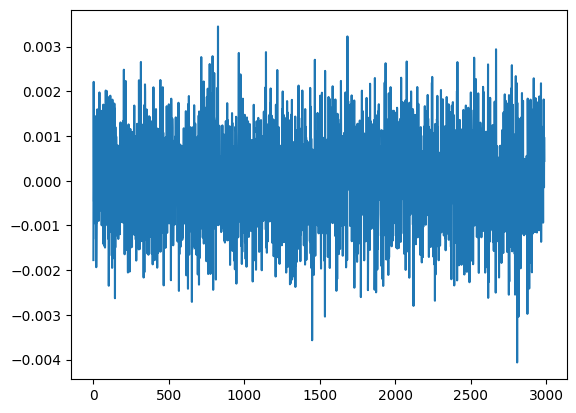

In [16]:
plt.plot(x[10:,1])

In [8]:
y[362]*0.031486602975118516 - x[362,2]*0.04500612641879238 - 0.08897067453338636*x[362,4]

4.379278848727348e-05

In [7]:
### hardcoded

correct_CMI_forward = 0
correct_CMIwithTar_forward = 0
correct_TE_forward = 0
tot_links = 0

for i in range(20):
    x_start,x_end,x_lag,x_coeff,y_start,y_lag,y_coeff,x,y =  generate_dataset(n_data=3000, n_variables=5, tau=5, n_xx=4, n_xy=2, n_yy=1, n_yx=3, seed=i)
    
    correct_links = set(y_start)
    
    ### forward CMI FS
    res = {
            "delta" : [], # list with all deltas
            "numSelected" : [], #
            "selectedFeatures" : [] 
        #    "accuracy" : [] # list of scores associated with the reduced problem
        }
    
    sel = forwardFeatureSelection(threshold=100,features=x,target=y,res=res,k=20, nproc=1, tau=5)
    CMI_forward_selected = set(sel)
    
    ### forward CMI FS with past target as candidate feature
    res = {
            "delta" : [], # list with all deltas
            "numSelected" : [], #
            "selectedFeatures" : [] 
        #    "accuracy" : [] # list of scores associated with the reduced problem
        }
    
    sel = forwardFeatureSelection(threshold=100,features=np.concatenate((x,y.reshape(-1,1)),axis=1),target=y,res=res,k=20, nproc=1, tau=5)
    CMI_forwardWithTar_selected = set(sel)
    
    ### forward TE FS
    res = {
            "delta" : [], # list with all deltas
            "numSelected" : [], #
            "selectedFeatures" : [] 
        #    "accuracy" : [] # list of scores associated with the reduced problem
        }
    
    sel = TE_forwardFeatureSelection(threshold=100,features=np.concatenate((x,y.reshape(-1,1)),axis=1),target=y,res=res,k=20, nproc=1, tau=5)
    TE_forward_selected = set(sel)
    
    correct_CMI_forward += len([found for found in CMI_forward_selected if found in correct_links])
    correct_CMIwithTar_forward += len([found for found in CMI_forwardWithTar_selected if found in correct_links])
    correct_TE_forward += len([found for found in TE_forward_selected if found in correct_links])+1
    tot_links += len(correct_links)
    
    print(correct_links, CMI_forward_selected, CMI_forwardWithTar_selected, TE_forward_selected)

    print(x_start,'\n',x_end,'\n',x_lag,'\n',x_coeff,'\n',y_start,'\n',y_lag,'\n',y_coeff)
    print(correct_CMI_forward, correct_CMIwithTar_forward, correct_TE_forward, tot_links)
    print('\n\n')

    

CMI: 0.0016756281714693337
Highest CMI score: 0.0016756281714693337
Adding original feature: 0
CMI: 0.00015693749001062475
CMI: 0.0009055567181722231
Highest CMI score: 0.0009055567181722231
Adding original feature: 2
Highest CMI score: -0.0007549569214899848
CMI: 0.0016756281714693337
CMI: 0.0024812080782719848
Highest CMI score: 0.0024812080782719848
Adding original feature: 5
CMI: 0.002999008118799014
CMI: 0.00489519494080985
CMI: 0.0020271456597207157
CMI: 0.0007949531487066439
Highest CMI score: 0.00489519494080985
Adding original feature: 1
Highest CMI score: -0.001681927819779586
CMI: 0.002999008118799014
CMI: 0.00489519494080985
CMI: 0.0020271456597207157
CMI: 0.0007949531487066439
Highest CMI score: 0.00489519494080985
Adding original feature: 1
Highest CMI score: 0.0
{0, 1, 5} {0, 2} {1, 5} {1}
[4, 0, 3, 3, 5, 5, 5] 
 [3, 1, 3, 2, 0, 2, 0] 
 [1, 4, 3, 1, 1, 2, 2] 
 [0.027392337464290872, -0.04604265724722594, -0.09180529521276107, -0.09669447289429418, 0.06265404784005449, 0.

CMI: 0.005860054103072268
Highest CMI score: 0.005860054103072268
Adding original feature: 3
Highest CMI score: -0.007225000861042358
CMI: 0.0013884280768178743
CMI: 0.002756603863033816
CMI: 0.001792650180062466
CMI: 0.001362482316129197
Highest CMI score: 0.002756603863033816
Adding original feature: 2
CMI: 0.005950594402394899
CMI: 0.005103457903257159
CMI: 0.002226526498084907
CMI: 0.0030445241133435826
Highest CMI score: 0.005950594402394899
Adding original feature: 0
CMI: 0.002448116940934773
CMI: 0.0007246141643805857
Highest CMI score: 0.002448116940934773
Adding original feature: 1
CMI: 0.005860054103072268
Highest CMI score: 0.005860054103072268
Adding original feature: 3
Highest CMI score: -0.007225000861042358
CMI: 0.003950045446253225
CMI: 0.0007809141561256525
Highest CMI score: 0.003950045446253225
Adding original feature: 0
Highest CMI score: 0.0
{1, 2, 5} {0, 1, 2, 3} {0, 1, 2, 3} {0}
[3, 4, 1, 1, 5, 5, 5] 
 [2, 0, 3, 0, 4, 3, 3] 
 [4, 1, 2, 2, 2, 3, 1] 
 [-0.034605544

Highest CMI score: -0.001065090695001887
CMI: 0.0021070185785518913
CMI: 0.0050463907414155474
CMI: 0.0044343214340869085
CMI: 0.005493831685795388
Highest CMI score: 0.005493831685795388
Adding original feature: 4
Highest CMI score: 0.0
{0, 2, 5} {4} {4} {4}
[0, 4, 0, 4, 5, 5, 5] 
 [3, 3, 1, 0, 1, 3, 4] 
 [3, 3, 4, 1, 4, 1, 2] 
 [0.038548673593030464, 0.0631634222672115, -0.03111864844142867, -0.09103236486191624, 0.014319451406746203, -0.0707509146552805, 0.04375427537509424] 
 [0, 2, 5] 
 [2, 2, 4] 
 [-0.030928699184832056, -0.008598064878225745, 0.09518757747803505]
11 18 26 47



CMI: 0.003213467057683957
CMI: 0.0038761193191240387
CMI: 0.004659108589766523
Highest CMI score: 0.004659108589766523
Adding original feature: 4
Highest CMI score: -0.005131509877047991
CMI: 0.003213467057683957
CMI: 0.0038761193191240387
CMI: 0.004659108589766523
CMI: 0.005002249594532555
Highest CMI score: 0.005002249594532555
Adding original feature: 5
CMI: 0.0005833268599094435
CMI: 0.000104379526734

In [11]:
y

array([-0.1869152 ,  0.03315639,  0.18688704, ...,  0.00394595,
        0.09966579,  0.03005664])

In [9]:
### regression

# regression con solo x3_past
# regression con x2_past e y_past

x_past_5 = x[5-1:-1, 2].reshape(-1,1)
for lag in range(2,5+1):
    x_past_5 = np.concatenate((x_past_5, x[5-lag:-lag, 2].reshape(-1,1)),axis=1)
x_past_5

y_past_5 = y[5-1:-1].reshape(-1,1)
for lag in range(2,5+1):
    y_past_5 = np.concatenate((y_past_5, y[5-lag:-lag].reshape(-1,1)),axis=1)
y_past_5

pasts = np.concatenate((x_past_5, y_past_5),axis=1)

In [15]:
from sklearn.linear_model import LinearRegression
reg_x = LinearRegression().fit(pasts[10:2000,:], y[15:2005].reshape(-1,1))
reg_x.score(pasts[2000:,:], y[2005:].reshape(-1,1))


-0.006579382019165747

## 10 features

In [3]:
correct_CMI_forward = 0
correct_CMIwithTar_forward = 0
correct_TE_forward = 0
tot_links = 0

for i in range(20):
    x_start,x_end,x_lag,x_coeff,y_start,y_lag,y_coeff,x,y =  generate_dataset(n_data=3000, n_variables=10, tau=5, n_xx=5, n_xy=3, n_yy=2, n_yx=2, seed=i)
    
    print(f'{x_start},\n{x_end},\n{x_lag},\n{x_coeff}\n\n')

    print(f'{y_start},\n{y_lag},\n{y_coeff}\n\n')
    
    correct_links = set(y_start)
    
    ### forward CMI FS
    res = {
            "delta" : [], # list with all deltas
            "numSelected" : [], #
            "selectedFeatures" : [] 
        #    "accuracy" : [] # list of scores associated with the reduced problem
        }
    
    sel = forwardFeatureSelection(threshold=100,features=x,target=y,res=res,k=20, nproc=1, tau=5)
    CMI_forward_selected = set(sel)
    
    ### forward CMI FS with past target as candidate feature
    res = {
            "delta" : [], # list with all deltas
            "numSelected" : [], #
            "selectedFeatures" : [] 
        #    "accuracy" : [] # list of scores associated with the reduced problem
        }
    
    sel = forwardFeatureSelection(threshold=100,features=np.concatenate((x,y.reshape(-1,1)),axis=1),target=y,res=res,k=20, nproc=1, tau=5)
    CMI_forwardWithTar_selected = set(sel)
    
    ### forward TE FS
    res = {
            "delta" : [], # list with all deltas
            "numSelected" : [], #
            "selectedFeatures" : [] 
        #    "accuracy" : [] # list of scores associated with the reduced problem
        }
    
    sel = TE_forwardFeatureSelection(threshold=100,features=np.concatenate((x,y.reshape(-1,1)),axis=1),target=y,res=res,k=20, nproc=1, tau=5)
    TE_forward_selected = set(sel)
    
    correct_CMI_forward += len([found for found in CMI_forward_selected if found in correct_links])
    correct_CMIwithTar_forward += len([found for found in CMI_forwardWithTar_selected if found in correct_links])
    correct_TE_forward += len([found for found in TE_forward_selected if found in correct_links])+1
    tot_links += len(correct_links)
    
    print(correct_links, CMI_forward_selected, CMI_forwardWithTar_selected, TE_forward_selected)
print(correct_CMI_forward, correct_CMIwithTar_forward, correct_TE_forward, tot_links)


/Users/paolo/Documents/causalFS/../causalFS/data/dataset_generation.py:54: RuntimeWarning: overflow encountered in multiply
  x[[[tau+i]],j] += sum( y[[a - b for a, b in zip([tau+i]*len(idx), [x_lag[k] for k in idx])]] * [x_coeff[k] for k in idx])
/Users/paolo/Documents/causalFS/../causalFS/data/dataset_generation.py:46: RuntimeWarning: overflow encountered in double_scalars
  y[[tau+i]] += sum(y[[a - b for a, b in zip([tau+i]*n_yy, y_lag[n_xy:])]] * y_coeff[n_xy:])
/Users/paolo/Documents/causalFS/../causalFS/data/dataset_generation.py:46: RuntimeWarning: invalid value encountered in add
  y[[tau+i]] += sum(y[[a - b for a, b in zip([tau+i]*n_yy, y_lag[n_xy:])]] * y_coeff[n_xy:])


[5, 0, 3, 3, 7, 10, 10],
[9, 3, 5, 2, 4, 1, 7],
[4, 3, 1, 1, 1, 3, 4],
[0.2739233746429086, -0.4604265724722594, -0.9180529521276106, -0.9669447289429418, 0.6265404784005448, 3.3020446182217738, 0.8530862061374389]


[8, 1, 5, 10, 10],
[2, 2, 1, 2, 1],
[0.9179862439359936, 0.17449996586169148, 1.740289695151073, 0.6317071082430643, -0.9945229996597038]


Highest CMI score: -4.88273618655634
Highest CMI score: -4.788611151634758
Highest CMI score: -4.467303585531975
{8, 1, 10, 5} set() set() set()
[5, 8, 9, 5, 0, 10, 10],
[0, 1, 7, 6, 9, 4, 2],
[3, 1, 3, 2, 3, 4, 1],
[0.023643249400513433, 0.9009273926518706, -0.7116807745607325, 0.8972988942744877, -0.3763370959790291, -0.6133884082193948, 2.621620750563534]


[7, 7, 9, 10, 10],
[2, 4, 3, 1, 3],
[-0.3632034545233549, 0.19837475069223798, -1.8897635470277265, 0.5070262173496132, 0.07628662643855644]


CMI: 0.0013116802349028263
CMI: 0.012855923260546227
CMI: 0.0017933285108787194
CMI: 0.01385943859991818
CMI: 0.0038057488982551598
CMI: 

/Users/paolo/Documents/causalFS/../causalFS/data/dataset_generation.py:45: RuntimeWarning: overflow encountered in multiply
  y[[tau+i]] = sum(x[[a - b for a, b in zip([tau+i]*n_xy, y_lag[0:n_xy])],y_start[0:n_xy]] * y_coeff[0:n_xy])
/Users/paolo/Documents/causalFS/../causalFS/data/dataset_generation.py:45: RuntimeWarning: invalid value encountered in double_scalars
  y[[tau+i]] = sum(x[[a - b for a, b in zip([tau+i]*n_xy, y_lag[0:n_xy])],y_start[0:n_xy]] * y_coeff[0:n_xy])
/Users/paolo/Documents/causalFS/../causalFS/data/dataset_generation.py:46: RuntimeWarning: invalid value encountered in double_scalars
  y[[tau+i]] += sum(y[[a - b for a, b in zip([tau+i]*n_yy, y_lag[n_xy:])]] * y_coeff[n_xy:])


[8, 8, 6, 2, 8, 10, 10],
[7, 2, 1, 5, 4, 6, 3],
[1, 1, 2, 4, 4, 1, 4],
[-0.4767757315013672, -0.4030177131717534, 0.6284514811885606, -0.8161681157298062, 0.200201051931308, 1.828484214494357, -2.4967914130671724]


[6, 1, 3, 10, 10],
[2, 1, 1, 3, 3],
[-1.7794134906677272, -0.9001225283758476, 0.6297320595023703, 0.124531325560856, -0.6998754733893278]


Highest CMI score: -0.2689286712045218
Highest CMI score: 0.0
CMI: 0.12832473214627577
CMI: 0.004927801212856104
CMI: 0.09020762094858076
CMI: 0.09090732248070577
Highest CMI score: 0.12832473214627577
Adding original feature: 2
CMI: inf
CMI: 0.0012230374764721497
CMI: 0.00038497510469595597
CMI: 0.04719516086731276
CMI: 0.052015848643100326
CMI: 0.0009357498883039161
Highest CMI score: inf
{1, 10, 3, 6} set() set() {2}
[8, 9, 3, 8, 8, 10, 10],
[0, 5, 3, 9, 9, 4, 7],
[3, 2, 4, 3, 1, 1, 3],
[-0.8287016657127513, -0.5263789868078006, 0.6025489304127938, 0.16432407212873557, -0.8117427155192016, -0.5349844781082096, -0.1675896148733278]



/Users/paolo/Documents/causalFS/../causalFS/data/dataset_generation.py:54: RuntimeWarning: invalid value encountered in add
  x[[[tau+i]],j] += sum( y[[a - b for a, b in zip([tau+i]*len(idx), [x_lag[k] for k in idx])]] * [x_coeff[k] for k in idx])
/Users/paolo/Documents/causalFS/../causalFS/data/dataset_generation.py:46: RuntimeWarning: overflow encountered in add
  y[[tau+i]] += sum(y[[a - b for a, b in zip([tau+i]*n_yy, y_lag[n_xy:])]] * y_coeff[n_xy:])


[4, 9, 6, 3, 3, 10, 10],
[7, 7, 9, 7, 8, 7, 4],
[2, 3, 3, 3, 1, 3, 1],
[0.25019093320933394, 0.794427601939151, 0.551371380490387, -0.5495856200188163, -0.39966743017754913, 2.988427563170095, -3.957877563475402]


[7, 0, 7, 10, 10],
[3, 3, 4, 1, 1],
[1.2849136735310651, 1.188277715008185, -0.1282601886251169, -0.39393514636137295, -0.44314877579845335]


Highest CMI score: -1.3446433560222713
Highest CMI score: -1.342962551827243
CMI: inf
CMI: 0.42679606872364173
CMI: inf
CMI: 0.2414953106497748
Highest CMI score: inf
{0, 10, 7} set() set() set()
[3, 4, 1, 9, 5, 10, 10],
[8, 3, 8, 0, 5, 9, 2],
[1, 2, 4, 3, 4, 2, 4],
[-0.34605544678887856, 0.9745536866758511, -0.36257832302896653, 0.5770978716400579, 0.7397930233924321, -0.8713215476864482, -0.49694501501760957]


[2, 6, 8, 10, 10],
[2, 4, 1, 2, 2],
[-0.5090043876425878, -1.5721856141089026, -0.08413818334913215, -0.5172957098306354, -0.4857095028977405]


CMI: 0.05506907235551881
CMI: 0.04974175012471328
CMI: 0.0052016259132933625
CMI

/Users/paolo/Documents/causalFS/../causalFS/data/dataset_generation.py:45: RuntimeWarning: overflow encountered in double_scalars
  y[[tau+i]] = sum(x[[a - b for a, b in zip([tau+i]*n_xy, y_lag[0:n_xy])],y_start[0:n_xy]] * y_coeff[0:n_xy])


[5, 6, 8, 6, 1, 10, 10],
[6, 4, 8, 1, 8, 0, 8],
[2, 4, 2, 2, 1, 1, 3],
[0.7404984079401693, -0.42636558182488926, 0.20629630010312372, 0.5550681658403576, 0.43214925920713054, 3.3230409639240603, 2.883149193463077]


[8, 8, 2, 10, 10],
[3, 1, 2, 1, 4],
[1.6729505161950495, -1.8936490621296111, -0.25100799948196517, -0.03011134604542387, -0.869691605259785]


Highest CMI score: 0.0
Highest CMI score: 0.0
CMI: inf
CMI: 0.030341697704712064
CMI: 0.1624034202261806
Highest CMI score: inf
{8, 2, 10} set() set() set()
[9, 4, 0, 1, 9, 10, 10],
[0, 1, 8, 9, 0, 0, 6],
[3, 1, 3, 1, 4, 1, 1],
[0.9120034192579507, -0.5846363798417062, 0.6568897705490615, -0.7014357538359595, 0.02560923287312966, -2.912643167835947, 1.5122918382490491]


[1, 8, 4, 10, 10],
[3, 2, 4, 3, 2],
[1.3669908972491158, -0.29796401038009357, 1.8277040138134648, 0.6506658127695966, -0.323569375056848]


CMI: 0.9612327295888237
CMI: 5.469013618260299e-06
CMI: 1.3396910031743259e-06
CMI: 1.450687633235137e-06
CMI: 1.11579310841

Highest CMI score: -0.1325900146429661
CMI: 0.0032248037711280486
CMI: 0.012822522473509387
CMI: 0.0007998138239524721
CMI: 0.09125521864632147
Highest CMI score: 0.09125521864632147
Adding original feature: 9
Highest CMI score: 0.0
{9, 10, 6} {9} {9} {9}
[3, 8, 5, 1, 2, 10, 10],
[2, 8, 8, 2, 1, 4, 7],
[2, 2, 4, 3, 3, 2, 1],
[-0.20138846156485446, 0.43482935857643223, -0.4383533439279932, -0.8345501640037674, 0.9395426385857195, 0.5114139629436165, 1.1545676972099717]


[4, 1, 3, 10, 10],
[2, 2, 3, 3, 2],
[0.3074858540104364, -0.09855612108025591, -1.510392040608572, -0.37280775755356377, 0.472417165369984]


CMI: 0.009791820121327855
CMI: 0.02074293893145329
CMI: 0.008404688460980816
CMI: 0.021467426046472324
CMI: 3.1989174228583197
CMI: 3.1469749473094333
CMI: 0.025074340298219717
CMI: 0.0039205445014425635
Highest CMI score: 3.1989174228583197
Adding original feature: 4
CMI: 0.017963616223427348
Highest CMI score: 0.017963616223427348
Adding original feature: 3
Highest CMI score: -0

### Forward CMI e TE

In [58]:
res = {
        "delta" : [], # list with all deltas
        "numSelected" : [], #
        "selectedFeatures" : [] 
    #    "accuracy" : [] # list of scores associated with the reduced problem
    }

sel = forwardFeatureSelection(threshold=100,features=x,target=y,res=res,k=20, nproc=1, tau=5)
sel

CMI: 0.8417391109358867
CMI: 0.9305312077590682
CMI: 4.537911359912517
CMI: 0.9883133778152924
CMI: 0.9361093050144622
Highest CMI score: 4.537911359912517
Adding original feature: 2
CMI: 5.698013880284236e-06
CMI: 2.9928497028208767e-05
CMI: 3.647370770476499e-05
CMI: 3.0416463602023214e-05
Highest CMI score: 3.647370770476499e-05
Adding original feature: 3
CMI: 4.8043287446120075e-06
CMI: 3.862420684708212e-05
CMI: 2.9693758371251988e-05
Highest CMI score: 3.862420684708212e-05
Adding original feature: 1
Highest CMI score: -2.779384900009063e-06


[2, 3, 1]

In [59]:
res = {
        "delta" : [], # list with all deltas
        "numSelected" : [], #
        "selectedFeatures" : [] 
    #    "accuracy" : [] # list of scores associated with the reduced problem
    }

sel = forwardFeatureSelection(threshold=100,features=np.concatenate((x,y.reshape(-1,1)),axis=1),target=y,res=res,k=20, nproc=1, tau=5)
sel


CMI: 0.8417391109358867
CMI: 0.9305312077590682
CMI: 4.537911359912517
CMI: 0.9883133778152924
CMI: 0.9361093050144622
CMI: 4.91670178447035
Highest CMI score: 4.91670178447035
Adding original feature: 5
CMI: 3.8984614647574745e-08
Highest CMI score: 3.8984614647574745e-08
Adding original feature: 0
Highest CMI score: -2.5859805213634957e-05


[5, 0]

In [60]:
res = {
        "delta" : [], # list with all deltas
        "numSelected" : [], #
        "selectedFeatures" : [] 
    #    "accuracy" : [] # list of scores associated with the reduced problem
    }

sel = TE_forwardFeatureSelection(threshold=100,features=np.concatenate((x,y.reshape(-1,1)),axis=1),target=y,res=res,k=20, nproc=1, tau=5)
sel


CMI: 3.8984614647574745e-08
Highest CMI score: 3.8984614647574745e-08
Adding original feature: 0
Highest CMI score: 0.0


[0]

### Backward CMI e TE

In [9]:
res = {
        "delta" : [], # list with all deltas
        "numSelected" : [], #
        "selectedFeatures" : [] 
    #    "accuracy" : [] # list of scores associated with the reduced problem
    }

sel = backwardFeatureSelection(threshold=100,features=x,target=y,res=res,k=20, nproc=1, tau=5)
sel

CMI: 0.0037207415404586497
[(0, 0.0), (1, 0.0), (2, 0.0), (3, 0.0), (4, 0.0), (5, 0.0), (6, 0.0), (7, 0.0), (8, 0.0), (9, 0.0037207415404586497)]
Removing original feature: 0
CMI: 0.0037207415404586497
[(0, 0.0), (1, 0.0), (2, 0.0), (3, 0.0), (4, 0.0), (5, 0.0), (6, 0.0), (7, 0.0), (8, 0.0037207415404586497)]
Removing original feature: 1
CMI: 0.0037207415404586497
[(0, 0.0), (1, 0.0), (2, 0.0), (3, 0.0), (4, 0.0), (5, 0.0), (6, 0.0), (7, 0.0037207415404586497)]
Removing original feature: 2
CMI: 0.0037207415404586497
[(0, 0.0), (1, 0.0), (2, 0.0), (3, 0.0), (4, 0.0), (5, 0.0), (6, 0.0037207415404586497)]
Removing original feature: 3
CMI: 0.0037207415404586497
[(0, 0.0), (1, 0.0), (2, 0.0), (3, 0.0), (4, 0.0), (5, 0.0037207415404586497)]
Removing original feature: 4
CMI: 0.0037650005333013103
[(0, 0.0), (1, 0.0), (2, 0.0), (3, 0.0), (4, 0.0037650005333013103)]
Removing original feature: 5
CMI: 0.0037650005333013103
[(0, 0.0), (1, 0.0), (2, 0.0), (3, 0.0037650005333013103)]
Removing origi

[9]

In [10]:
res = {
        "delta" : [], # list with all deltas
        "numSelected" : [], #
        "selectedFeatures" : [] 
    #    "accuracy" : [] # list of scores associated with the reduced problem
    }

sel = backwardFeatureSelection(threshold=100,features=np.concatenate((x,y.reshape(-1,1)),axis=1),target=y,res=res,k=20, nproc=1, tau=5)
sel


CMI: 0.017345412352536727
[(0, 0.0), (1, 0.0), (2, 0.0), (3, 0.0), (4, 0.0), (5, 0.0), (6, 0.0), (7, 0.0), (8, 0.0), (9, 0.0), (10, 0.017345412352536727)]
Removing original feature: 0
CMI: 0.017345412352536727
[(0, 0.0), (1, 0.0), (2, 0.0), (3, 0.0), (4, 0.0), (5, 0.0), (6, 0.0), (7, 0.0), (8, 0.0), (9, 0.017345412352536727)]
Removing original feature: 1
CMI: 0.017345412352536727
[(0, 0.0), (1, 0.0), (2, 0.0), (3, 0.0), (4, 0.0), (5, 0.0), (6, 0.0), (7, 0.0), (8, 0.017345412352536727)]
Removing original feature: 2
CMI: 0.017345412352536727
[(0, 0.0), (1, 0.0), (2, 0.0), (3, 0.0), (4, 0.0), (5, 0.0), (6, 0.0), (7, 0.017345412352536727)]
Removing original feature: 3
CMI: 0.017345412352536727
[(0, 0.0), (1, 0.0), (2, 0.0), (3, 0.0), (4, 0.0), (5, 0.0), (6, 0.017345412352536727)]
Removing original feature: 4
CMI: 0.017345412352536727
[(0, 0.0), (1, 0.0), (2, 0.0), (3, 0.0), (4, 0.0), (5, 0.017345412352536727)]
Removing original feature: 5
CMI: 0.017345412352536727
[(0, 0.0), (1, 0.0), (2, 

[10]

In [11]:
res = {
        "delta" : [], # list with all deltas
        "numSelected" : [], #
        "selectedFeatures" : [] 
    #    "accuracy" : [] # list of scores associated with the reduced problem
    }

sel = TE_backwardFeatureSelection(threshold=100,features=x,target=y,res=res,k=20, nproc=1, tau=5)
sel

[(0, 0.0), (1, 0.0), (2, 0.0), (3, 0.0), (4, 0.0), (5, 0.0), (6, 0.0), (7, 0.0), (8, 0.0), (9, 0.0)]
Removing original feature: 0
[(0, 0.0), (1, 0.0), (2, 0.0), (3, 0.0), (4, 0.0), (5, 0.0), (6, 0.0), (7, 0.0), (8, 0.0)]
Removing original feature: 1
[(0, 0.0), (1, 0.0), (2, 0.0), (3, 0.0), (4, 0.0), (5, 0.0), (6, 0.0), (7, 0.0)]
Removing original feature: 2
[(0, 0.0), (1, 0.0), (2, 0.0), (3, 0.0), (4, 0.0), (5, 0.0), (6, 0.0)]
Removing original feature: 3
[(0, 0.0), (1, 0.0), (2, 0.0), (3, 0.0), (4, 0.0), (5, 0.0)]
Removing original feature: 4
[(0, 0.0), (1, 0.0), (2, 0.0), (3, 0.0), (4, 0.0)]
Removing original feature: 5
[(0, 0.0), (1, 0.0), (2, 0.0), (3, 0.0)]
Removing original feature: 6
[(0, 0.0), (1, 0.0), (2, 0.0)]
Removing original feature: 7
[(0, 0.0), (1, 0.0)]
Removing original feature: 8


[9]

In [20]:
import tigramite
from tigramite import data_processing as pp
from tigramite.toymodels import structural_causal_processes as toys

from tigramite import plotting as tp
from tigramite.pcmci import PCMCI
from tigramite.lpcmci import LPCMCI

from tigramite.independence_tests.parcorr import ParCorr
from tigramite.independence_tests.robust_parcorr import RobustParCorr
from tigramite.independence_tests.parcorr_wls import ParCorrWLS 
#from tigramite.independence_tests.gpdc import GPDC
from tigramite.independence_tests.cmiknn import CMIknn
from tigramite.independence_tests.cmisymb import CMIsymb
from tigramite.independence_tests.gsquared import Gsquared
from tigramite.independence_tests.regressionCI import RegressionCI


## Significant links at alpha = 0.05:

    Variable 0 has 0 link(s):

    Variable 1 has 1 link(s):
        (0 -4): pval = 0.00000 | val =  0.638

    Variable 2 has 51 link(s):
        (2 -2): pval = 0.00000 | val =  0.975
        (7 -1): pval = 0.00000 | val = -0.975
        (9 -1): pval = 0.00000 | val =  0.958
        (5 -1): pval = 0.00000 | val = -0.953
        (8 -5): pval = 0.00000 | val =  0.951
        (8 -2): pval = 0.00000 | val = -0.948
        (3 -1): pval = 0.00000 | val = -0.948
        (7 -5): pval = 0.00000 | val = -0.947
        (6 -3): pval = 0.00000 | val =  0.930
        (4 -4): pval = 0.00000 | val =  0.924
        (4 -5): pval = 0.00000 | val = -0.922
        (5 -2): pval = 0.00000 | val =  0.921
        (10 -3): pval = 0.00000 | val =  0.915
        (3  0): pval = 0.00000 | val =  0.897
        (2 -3): pval = 0.00000 | val = -0.887
        (7 -4): pval = 0.00000 | val =  0.840
        (5  0): pval = 0.00000 | val =  0.840
        (3 -5): pval = 0.00000 | val =

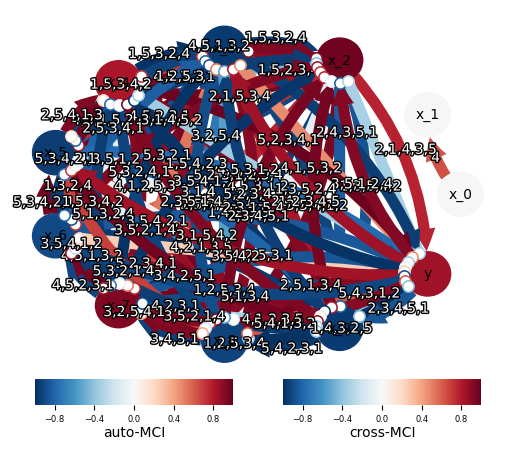

In [23]:
dataframe = pp.DataFrame(np.concatenate((x,y.reshape(-1,1)),axis=1))
cond_test = ParCorr()
pcmci = PCMCI(dataframe=dataframe, cond_ind_test=cond_test)
results = pcmci.run_pcmci(tau_max=5, pc_alpha=None)
pcmci.print_significant_links(p_matrix=results['p_matrix'],val_matrix=results['val_matrix'])
    
tp.plot_graph(
    val_matrix=results['val_matrix'],
    graph=results['graph'],
    var_names=['x_0','x_1','x_2','x_3','x_4','x_5','x_6','x_7','x_8','x_9','y'],
    link_colorbar_label='cross-MCI',
    node_colorbar_label='auto-MCI',
    show_autodependency_lags=False
    )
plt.show()

In [30]:
results['graph'][10]

array([['', '', '', '', '', ''],
       ['', '', '', '', '', ''],
       ['o-o', '-->', '-->', '-->', '-->', '-->'],
       ['o-o', '-->', '-->', '-->', '-->', '-->'],
       ['o-o', '-->', '-->', '-->', '-->', '-->'],
       ['o-o', '', '-->', '-->', '-->', '-->'],
       ['o-o', '-->', '', '-->', '-->', '-->'],
       ['o-o', '-->', '-->', '-->', '-->', '-->'],
       ['o-o', '-->', '-->', '-->', '-->', '-->'],
       ['o-o', '-->', '-->', '-->', '-->', '-->'],
       ['', '-->', '-->', '-->', '-->', '-->']], dtype='<U3')

In [33]:
import pickle
with open('promisingData.pkl', 'wb') as f:  # Python 3: open(..., 'wb')
    pickle.dump([x, y], f)

# Experiment 1

In [3]:
rng = np.random.default_rng(seed=0)
random.seed(0)

y_0 = rng.normal(0, 1, size=(1000,)) # y_{t-1} uniforme random
x_2 = rng.uniform(0, 1, size=(1000,)) # x2_{t-1} Gaussiana
x_1 = 2*y_0+rng.normal(0, 2, size=(1000,)) #x1_{t-1} generata da y_{t-1} 
y_1 = x_2**2 + 2*y_0 +rng.normal(0, 1, size=(1000,)) # y_{t} generata da x2_{t-1} e y_{t-1} 

df = pd.DataFrame()
df['y_0'] = y_0
df['y_1'] = y_1
df['x_1'] = x_1
df['x_2'] = x_2

In [4]:
df

,y_0,y_1,x_1,x_2
0,0.125730,1.464660,-3.578372,0.841877
1,-0.132105,1.338204,0.736767,0.418029
2,0.640423,1.234835,4.995734,0.392468
3,0.104900,-0.386903,-1.431663,0.135309
4,-0.535669,1.616926,-1.353362,0.113220
...,...,...,...,...
995,1.882338,5.789731,4.797667,0.135547
996,-0.540773,1.400824,0.965697,0.913540
997,1.389972,2.638125,1.593796,0.408808
998,-0.664342,-2.147283,-0.210726,0.914587


## correlations

<AxesSubplot:>

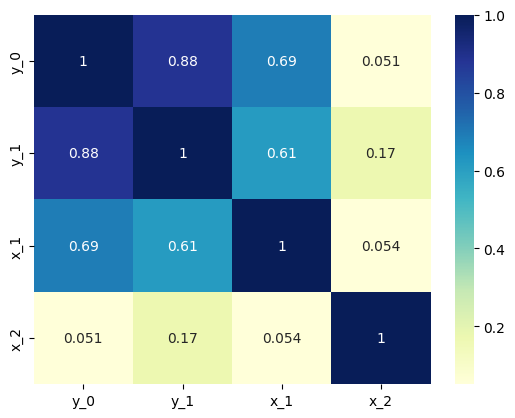

In [5]:
seaborn.heatmap(df.corr(), cmap="YlGnBu", annot=True)

## MI

In [6]:
estimateAllMI(df.loc[:,['y_0','x_1','x_2']].values,df.y_1.values,k=10)

[(0, 0.7708460296135964), (1, 0.22744391608703557), (2, 0.0116227511300861)]

## CMI

In [7]:
res = {
        "delta" : [], # list with all deltas
        "numSelected" : [], #
        "selectedFeatures" : [] 
    #    "accuracy" : [] # list of scores associated with the reduced problem
    }
forwardFeatureSelection(10,df.loc[:,['x_1','x_2']].values,df.y_1.values,res,10,-1)

----- MI Scores -----
[(0, 0.22744391608703557), (1, 0.0116227511300861)]
Best MI score: 0.22744391608703557
Adding first best original feature: 0
CMI: 0.007148337115138348
Highest CMI score: 0.007148337115138348
Adding original feature: 1


[0, 1]

In [8]:
res = {
        "delta" : [], # list with all deltas
        "numSelected" : [], #
        "selectedFeatures" : [] 
    #    "accuracy" : [] # list of scores associated with the reduced problem
    }
forwardFeatureSelection(10,df.loc[:,['y_0','x_1','x_2']].values,df.y_1.values,res,10,-1)

----- MI Scores -----
[(0, 0.7708460296135964), (1, 0.22744391608703557), (2, 0.0116227511300861)]
Best MI score: 0.7708460296135964
Adding first best original feature: 0
CMI: 0.02459573586396535
Highest CMI score: 0.02459573586396535
Adding original feature: 2
Highest CMI score: -0.13575026976521798


[0, 2]

## PCMCI

In [61]:
rng = np.random.default_rng(seed=0)
random.seed(0)

y_0 = rng.normal(0, 1, size=(1001,)) # y_{t-1} uniforme random
x_2 = rng.uniform(0, 1, size=(1001,)) # x2_{t-1} Gaussiana
x_1 = 2*y_0+rng.normal(0, 2, size=(1001,)) #x1_{t-1} generata da y_{t-1} 
y_1 = x_2[:-1]**2 + 2*y_0[:-1] +rng.normal(0, 1, size=(1000,)) # y_{t} generata da x2_{t-1} e y_{t-1} 

df = pd.DataFrame()
df['y_0'] = y_0[1:]
df['y_1'] = y_1
df['x_1'] = x_1[1:]
df['x_2'] = x_2[1:]


In [9]:
import tigramite
from tigramite import data_processing as pp
from tigramite.toymodels import structural_causal_processes as toys

from tigramite import plotting as tp
from tigramite.pcmci import PCMCI
from tigramite.lpcmci import LPCMCI

from tigramite.independence_tests.parcorr import ParCorr
from tigramite.independence_tests.robust_parcorr import RobustParCorr
from tigramite.independence_tests.parcorr_wls import ParCorrWLS 
#from tigramite.independence_tests.gpdc import GPDC
from tigramite.independence_tests.cmiknn import CMIknn
from tigramite.independence_tests.cmisymb import CMIsymb
from tigramite.independence_tests.gsquared import Gsquared
from tigramite.independence_tests.regressionCI import RegressionCI

In [62]:
dataframe = pp.DataFrame(df.loc[:,['x_1','x_2','y_1']].values)

In [73]:
cond_test = ParCorr()

In [74]:
pcmci = PCMCI(dataframe=dataframe, cond_ind_test=cond_test)
results = pcmci.run_pcmci(tau_max=1, pc_alpha=0.01)


## Significant links at alpha = 0.05:

    Variable 0 has 0 link(s):

    Variable 1 has 1 link(s):
        (1 -1): pval = 0.04946 | val = -0.062

    Variable 2 has 2 link(s):
        (0 -1): pval = 0.00000 | val =  0.644
        (1 -1): pval = 0.00000 | val =  0.152


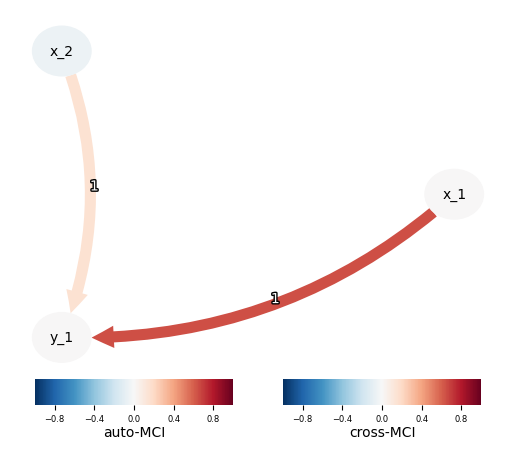

In [75]:
pcmci.print_significant_links(p_matrix=results['p_matrix'],val_matrix=results['val_matrix'])
    
tp.plot_graph(
    val_matrix=results['val_matrix'],
    graph=results['graph'],
    var_names=['x_1','x_2','y_1'],
    link_colorbar_label='cross-MCI',
    node_colorbar_label='auto-MCI',
    show_autodependency_lags=False
    )
plt.show()


## Significant links at alpha = 0.05:

    Variable 0 has 0 link(s):

    Variable 1 has 0 link(s):

    Variable 2 has 2 link(s):
        (0 -1): pval = 0.00000 | val =  0.154
        (1 -1): pval = 0.00400 | val =  0.007


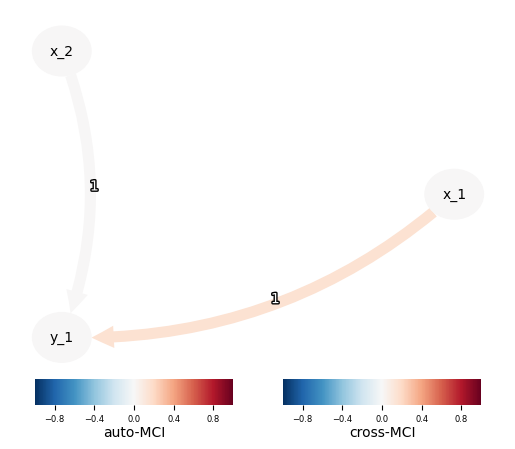

In [71]:
cond_test = CMIknn()
pcmci = PCMCI(dataframe=dataframe, cond_ind_test=cond_test)
results = pcmci.run_pcmciplus(tau_max=1, pc_alpha=0.01)
pcmci.print_significant_links(p_matrix=results['p_matrix'],val_matrix=results['val_matrix'])
    
tp.plot_graph(
    val_matrix=results['val_matrix'],
    graph=results['graph'],
    var_names=['x_1','x_2','y_1'],
    link_colorbar_label='cross-MCI',
    node_colorbar_label='auto-MCI',
    show_autodependency_lags=False
    )
plt.show()